# Disclaimer

- This parts contains details about my miniconda environment (python version, conda version, etc.).
- For the different graded exercises, I added code explanation and discussion in the end of each exercise, as comments.
- I've tried to do the non graded exercises as well.

In [ ]:
!python --version

In [4]:
!conda info

/usr/bin/zsh: /home/cytech/miniconda3/lib/python3.10/site-packages/cv2/../../../../lib/libtinfo.so.6: no version information available (required by /usr/bin/zsh)

     active environment : base
    active env location : /home/cytech/miniconda3
            shell level : 1
       user config file : /home/cytech/.condarc
 populated config files : 
          conda version : 23.1.0
    conda-build version : not installed
         python version : 3.10.9.final.0
       virtual packages : __archspec=1=x86_64
                          __glibc=2.31=0
                          __linux=5.4.0=0
                          __unix=0=0
       base environment : /home/cytech/miniconda3  (writable)
      conda av data dir : /home/cytech/miniconda3/etc/conda
  conda av metadata url : None
           channel URLs : https://repo.anaconda.com/pkgs/main/linux-64
                          https://repo.anaconda.com/pkgs/main/noarch
                          https://repo.anaconda.com/pkgs/r/linux-64
            

In [5]:
!conda list

/usr/bin/zsh: /home/cytech/miniconda3/lib/python3.10/site-packages/cv2/../../../../lib/libtinfo.so.6: no version information available (required by /usr/bin/zsh)
# packages in environment at /home/cytech/miniconda3:
#
# Name                    Version                   Build  Channel
_libgcc_mutex             0.1                        main  
_openmp_mutex             5.1                       1_gnu  
absl-py                   1.4.0                    pypi_0    pypi
anyio                     3.5.0           py310h06a4308_0  
appdirs                   1.4.4              pyhd3eb1b0_0  
argon2-cffi               21.3.0             pyhd3eb1b0_0  
argon2-cffi-bindings      21.2.0          py310h7f8727e_0  
asttokens                 2.0.5              pyhd3eb1b0_0  
astunparse                1.6.3                    pypi_0    pypi
attrs                     22.1.0          py310h06a4308_0  
babel                     2.11.0          py310h06a4308_0  
backcall                  0.2.0            

In [1]:
intro_images_path='./Images/Intro_images/'
edge_images_path='./Images/Edge_images/'
seg_images_path='./Images/Seg_images/'
feature_images_path='./Images/Feature_images/'
output_images_path='./Images/Output_images/'
print('Image paths ....')

Image paths ....


# Algorithms for Image Analysis

**CY Cergy Paris Université, CY Tech Campus de Pau**

January 23-26, 2023


<img src="./Logotipo_Solo.png" width=200/>


---
---

## 1 Digital Images

- Reading,displaying and saving images
- Color spaces
- Drawing and writting on images
- Image sampling and quantization
- Image histograms
- Geometric transformations


http://szeliski.org/Book/

https://docs.opencv.org/4.3.0/dc/d2e/tutorial_py_image_display.html

https://docs.opencv.org/3.4.2/dc/d2e/tutorial_py_image_display.html

---
---

### Getting Started with OpenCV

Repeat the first exercises on this page:

https://docs.opencv.org/4.3.0/dc/d2e/tutorial_py_image_display.html

https://docs.opencv.org/3.4.2/dc/d2e/tutorial_py_image_display.html

#### Reading images

Use the function cv2.imread() to read an image. The image should be in the working directory or a full path of image should be given.
Second argument is a flag which specifies the way image should be read:

cv2.IMREAD_COLOR : Loads a color image. Any transparency of image will be neglected. It is the default flag.

cv2.IMREAD_GRAYSCALE : Loads image in grayscale mode.

cv2.IMREAD_UNCHANGED : Loads image as such including alpha channel.

Instead of these three flags, you can simply pass integers 1, 0 or -1 respectively.







In [6]:
import numpy as np
from matplotlib import pyplot as plt
import cv2
import sys

# Load an color image in grayscale
img = cv2.imread(intro_images_path+'pazo.jpg',0)

if img is None:
  sys.exit('Failing at loading image')

In [7]:
print(cv2.__version__)

4.6.0


#### Display an image

Use the function cv2.imshow() to display an image in a window. The window automatically fits to the image size.

First argument is a window name which is a string. Second argument is our image. You can create as many windows as you wish, but with different window names.

cv2.waitKey() is a keyboard binding function. Its argument is the time in milliseconds. The function waits for specified milliseconds for any keyboard event. If you press any key in that time, the program continues. If 0 is passed, it waits indefinitely for a key stroke. It can also be set to detect specific key strokes.

If you are using a 64-bit machine, you will have to modify k = cv2.waitKey(0) line as follows : k = cv2.waitKey(0) & 0xFF

cv2.destroyAllWindows() simply destroys all the windows we created. If you want to destroy any specific window, use the function cv2.destroyWindow() where you pass the exact window name as the argument.


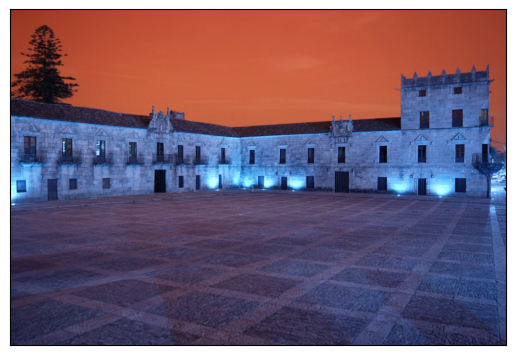

In [9]:
import numpy as np
from matplotlib import pyplot as plt
import cv2
img = cv2.imread(intro_images_path+'pazo.jpg')

plt.imshow(img)
plt.xticks([]), plt.yticks([])  # to hide tick values on X and Y axis
plt.show()
#cv2.waitKey(0)
#cv2.destroyAllWindows()


#### Save an image

Use the function cv2.imwrite() to save an image. First argument is the file name, second  argument is the image you want to save. 


This will save the image in PNG format in the working directory:

In [2]:
import numpy as np
import cv2 

#Load an color image in grayscale
img = cv2.imread(intro_images_path+'pazo.jpg')
    
cv2.imshow('image',img)

k = cv2.waitKey(0) & 0xFF
if k == 27:         # wait for ESC key to exit
    cv2.destroyAllWindows()
elif k == ord('s'): # wait for 's' key to save and exit
    cv2.imwrite(output_images_path+'pazo_gray.jpg',img)
    cv2.destroyAllWindows()

np.set_printoptions(edgeitems=25)
print("Data type = {}\n".format(img.dtype))
print("Object type = {}\n".format(type(img)))
print('Image size:{}\n'.format(img.shape))
print('Channel G of the {} upper left window:\n'.format('20x20'))
print(img[0:20,0:20,1])
print('\nOrigin (0,0), first index row, second index column:')
print('Element (1,0): {}'.format(img[1,0,1]))
print('Element (0,1): {}\n'.format(img[0,1,1]))

Data type = uint8

Object type = <class 'numpy.ndarray'>

Image size:(600, 886, 3)

Channel G of the 20x20 upper left window:

[[51 52 52 53 52 52 52 52 51 52 53 53 51 51 52 53 52 52 52 52]
 [51 52 52 53 52 52 52 52 51 51 52 52 51 51 51 52 53 53 53 53]
 [52 52 52 53 52 52 52 52 51 52 52 52 51 51 52 52 53 53 53 53]
 [52 52 52 52 52 52 52 52 52 53 53 53 53 52 53 53 53 53 53 53]
 [51 51 52 52 52 52 52 52 52 53 54 54 53 53 54 55 53 53 53 53]
 [51 51 52 52 52 52 52 52 52 52 53 53 53 53 53 54 54 54 54 55]
 [51 51 52 52 52 53 52 52 52 53 53 53 53 53 54 54 55 55 55 55]
 [51 51 52 52 53 53 53 52 53 53 54 54 54 54 54 55 54 54 54 54]
 [51 53 54 53 52 51 52 54 53 53 53 52 52 53 54 54 54 55 55 54]
 [51 52 53 53 52 52 53 54 53 53 53 53 53 54 54 54 55 55 55 55]
 [51 52 53 53 53 53 54 55 53 54 54 54 54 54 54 54 56 56 56 56]
 [51 52 53 53 53 53 54 55 53 53 54 55 55 55 54 54 56 56 56 56]
 [53 53 54 54 53 53 54 54 53 53 54 55 55 55 55 55 56 56 56 56]
 [54 54 54 54 54 54 54 54 53 54 54 54 55 55 55 55 56 5

#### Display an image using Matplotlib

Matplotlib is a plotting library for Python which gives you wide variety of plotting methods. Here, you will learn how to display image with Matplotlib. You can zoom images, save it, etc., using Matplotlib. There is a slight difference in pixel ordering in OpenCV and Matplotlib. OpenCV follows BGR order, while matplotlib likely follows RGB order. So when you display an image loaded in OpenCV using pylab functions, you may need to convert it into RGB mode.
Below program loads a grayscale image, displays it, saves the image if you press ‘s’ and exits,  or simply exits without saving if you press ESC key. 

Data type = uint8

Object type = <class 'numpy.ndarray'>

Image size = (600, 886)

 20x20 upper left window in gray-level:

[[76 77 77 78 78 79 79 79 78 79 80 80 78 78 79 80 79 79 79 79]
 [76 77 77 78 78 79 79 79 78 78 79 79 78 78 78 79 80 80 80 80]
 [77 77 77 78 78 79 79 79 78 79 79 79 78 78 79 79 80 80 80 80]
 [77 77 77 78 78 79 79 79 79 80 80 80 80 79 80 80 80 80 80 80]
 [77 77 78 78 78 79 79 79 79 80 81 81 80 80 81 82 80 80 80 80]
 [77 77 78 78 78 79 79 79 79 79 80 80 80 80 80 81 81 81 81 82]
 [77 77 78 78 78 80 79 79 79 80 80 80 80 80 81 81 82 82 82 82]
 [77 77 78 78 79 80 80 79 80 80 81 81 81 81 81 82 81 81 81 81]
 [77 79 80 79 78 78 79 81 80 80 80 79 79 80 81 81 80 81 81 81]
 [77 78 79 79 78 79 80 81 80 80 80 80 80 81 81 81 81 81 81 81]
 [77 78 79 79 79 80 81 82 80 81 81 81 81 81 81 81 82 82 82 82]
 [77 78 79 79 79 80 81 82 80 80 81 82 82 82 81 81 82 82 82 82]
 [79 79 80 80 79 80 81 81 80 80 81 82 82 81 81 81 82 82 82 82]
 [80 80 80 80 80 81 81 81 80 81 81 81 81 81 81 81 82 82 8

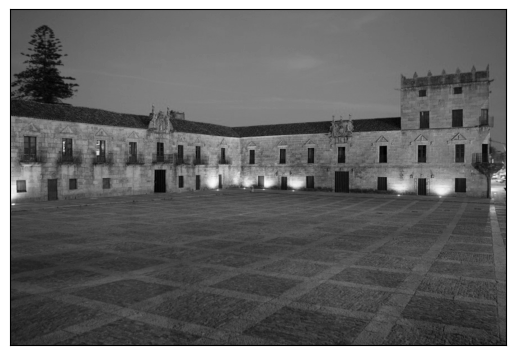

Error saving image!


In [3]:
import numpy as np
from matplotlib import pyplot as plt
import cv2 

#Load an color image in grayscale
img = cv2.imread(intro_images_path+'pazo.jpg',1)
    
b,g,r = cv2.split(img)       # get b,g,r
img = cv2.merge([r,g,b])     # switch it to rgb
#img=cv2.cvtColor(img, cv2.COLOR_BGR2RGB) #alternatively...

img=cv2.cvtColor(img, cv2.COLOR_BGR2GRAY) 
print("Data type = {}\n".format(img.dtype))
print("Object type = {}\n".format(type(img)))
print("Image size = {}\n".format(img.shape))
print(' {} upper left window in gray-level:\n'.format('20x20'))
print(img[0:20,0:20])
print('\nOrigin (0,0), first index row, second index column:')
print('Element (1,0): {}'.format(img[1,0]))
print('Element (0,1): {}\n'.format(img[0,1]))
plt.imshow(img,cmap='gray')
plt.xticks([]), plt.yticks([])  # to hide tick values on X and Y axis
plt.show()
retval=cv2.imwrite(output_images_path+'img_gray.png',img) 

if retval is True:
    print('saved image!')
else:
    print('Error saving image!')
    


### Changing Color‐space

https://docs.opencv.org/4.3.0/df/d9d/tutorial_py_colorspaces.html

https://docs.opencv.org/3.4.2/df/d9d/tutorial_py_colorspaces.html

There are more than 150 color-space conversion methods available in OpenCV. But we will look into only two which are most widely used ones, BGR Gray and BGR HSV.

For color conversion, we use the function cv2.cvtColor(input_image, flag) where flag determines the type of conversion.

For BGR Gray conversion we use the flags cv2.COLOR_BGR2GRAY. Similarly for BGR HSV, we use the flag cv2.COLOR_BGR2HSV. 

To get other flags, just run following commands:

In [4]:
import cv2

flags = [i for i in dir(cv2) if i.startswith('COLOR_')]
print(flags)


['COLOR_BAYER_BG2BGR', 'COLOR_BAYER_BG2BGRA', 'COLOR_BAYER_BG2BGR_EA', 'COLOR_BAYER_BG2BGR_VNG', 'COLOR_BAYER_BG2GRAY', 'COLOR_BAYER_BG2RGB', 'COLOR_BAYER_BG2RGBA', 'COLOR_BAYER_BG2RGB_EA', 'COLOR_BAYER_BG2RGB_VNG', 'COLOR_BAYER_BGGR2BGR', 'COLOR_BAYER_BGGR2BGRA', 'COLOR_BAYER_BGGR2BGR_EA', 'COLOR_BAYER_BGGR2BGR_VNG', 'COLOR_BAYER_BGGR2GRAY', 'COLOR_BAYER_BGGR2RGB', 'COLOR_BAYER_BGGR2RGBA', 'COLOR_BAYER_BGGR2RGB_EA', 'COLOR_BAYER_BGGR2RGB_VNG', 'COLOR_BAYER_GB2BGR', 'COLOR_BAYER_GB2BGRA', 'COLOR_BAYER_GB2BGR_EA', 'COLOR_BAYER_GB2BGR_VNG', 'COLOR_BAYER_GB2GRAY', 'COLOR_BAYER_GB2RGB', 'COLOR_BAYER_GB2RGBA', 'COLOR_BAYER_GB2RGB_EA', 'COLOR_BAYER_GB2RGB_VNG', 'COLOR_BAYER_GBRG2BGR', 'COLOR_BAYER_GBRG2BGRA', 'COLOR_BAYER_GBRG2BGR_EA', 'COLOR_BAYER_GBRG2BGR_VNG', 'COLOR_BAYER_GBRG2GRAY', 'COLOR_BAYER_GBRG2RGB', 'COLOR_BAYER_GBRG2RGBA', 'COLOR_BAYER_GBRG2RGB_EA', 'COLOR_BAYER_GBRG2RGB_VNG', 'COLOR_BAYER_GR2BGR', 'COLOR_BAYER_GR2BGRA', 'COLOR_BAYER_GR2BGR_EA', 'COLOR_BAYER_GR2BGR_VNG', 'COLOR_

### Drawing and writing on images

Functions to write text and draw different geometric shapes with OpenCV: cv.line(), cv.circle() , cv.rectangle(), cv.ellipse(), cv.putText() etc.


In all the above functions, you will see some common arguments as given below:

**img**: The image where you want to draw the shapes.

**color**: Color of the shape. for BGR, pass it as a tuple, eg: (255,0,0) for blue. For grayscale, just pass the scalar value.

**thickness**: Thickness of the line or circle etc. If -1 is passed for closed figures like circles, it will fill the shape. default thickness = 1

**lineType**: Type of line, whether 8-connected, anti-aliased line etc. By default, it is 8-connected. cv.LINE_AA gives anti-aliased line which looks great for curves.

Learn more in https://docs.opencv.org/4.x/dc/da5/tutorial_py_drawing_functions.html

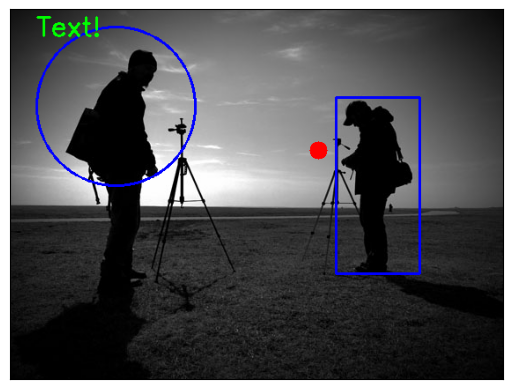

In [5]:
import numpy as np
from matplotlib import pyplot as plt
import cv2 

image = cv2.imread(intro_images_path+'overexposed.jpg')

# Draw two circles (one full),one rectange,
cv2.circle(image, center=(120, 110), radius=90, color=(0, 0, 255), thickness=2)
cv2.circle(image, (350, 160), 10, (255, 0, 0), -1)

cv2.rectangle(image, (370, 100), (465, 300), (0, 0, 255),2)

#escribimos un texto na imaxe
cv2.putText(image, "Text!",org=(30,30),fontFace=cv2.FONT_HERSHEY_SIMPLEX,fontScale=1,color=(0, 255,0), thickness=2)

# visualizamos
plt.imshow(image)
plt.xticks([]), plt.yticks([])  # to hide tick values on X and Y axis
plt.show()

### Image sampling and quantization

Let's se the effect of using different spatial sampling and intensity levels of quantization.


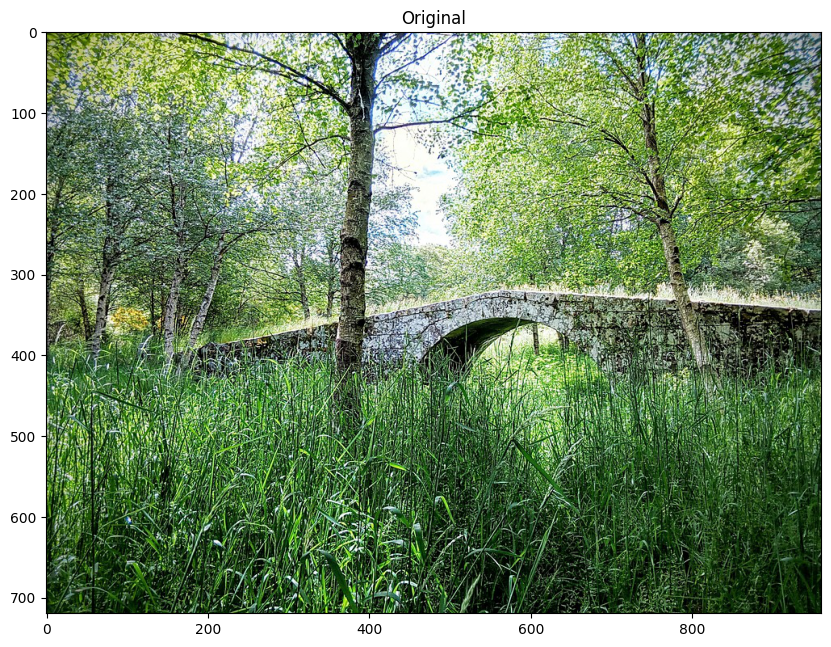

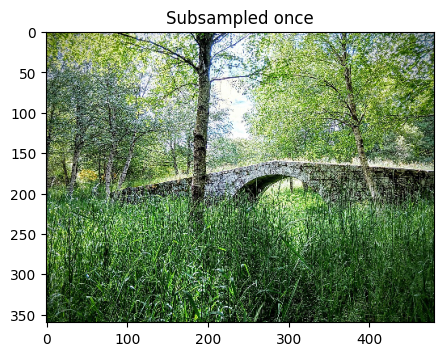

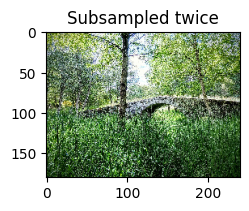

Sizes I1 = (720, 960, 3), I2 = (360, 480, 3) e I3 = (180, 240, 3)


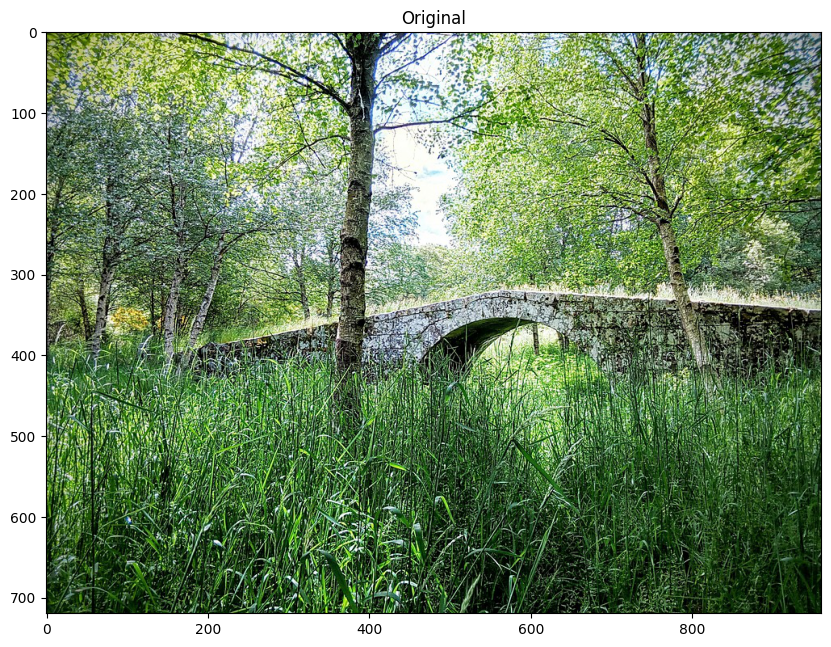

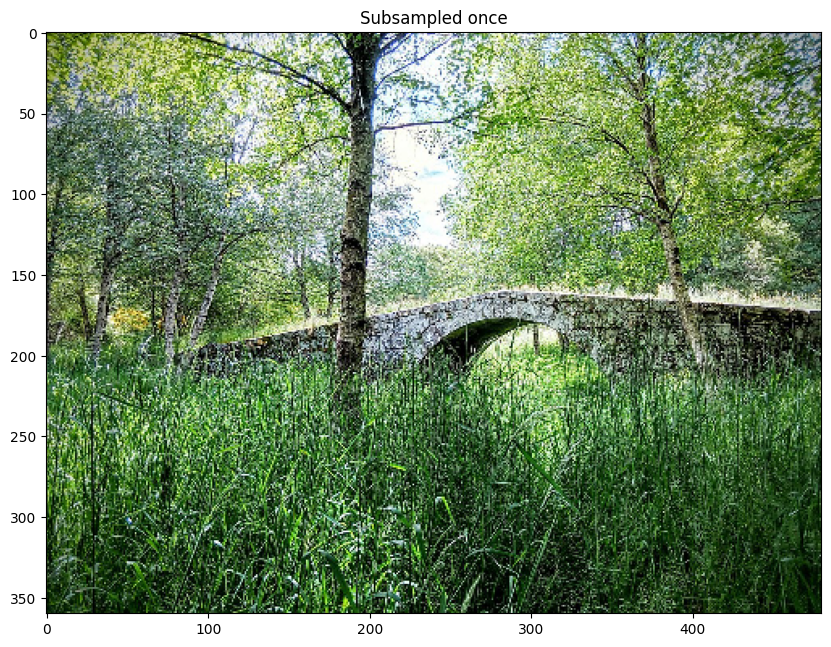

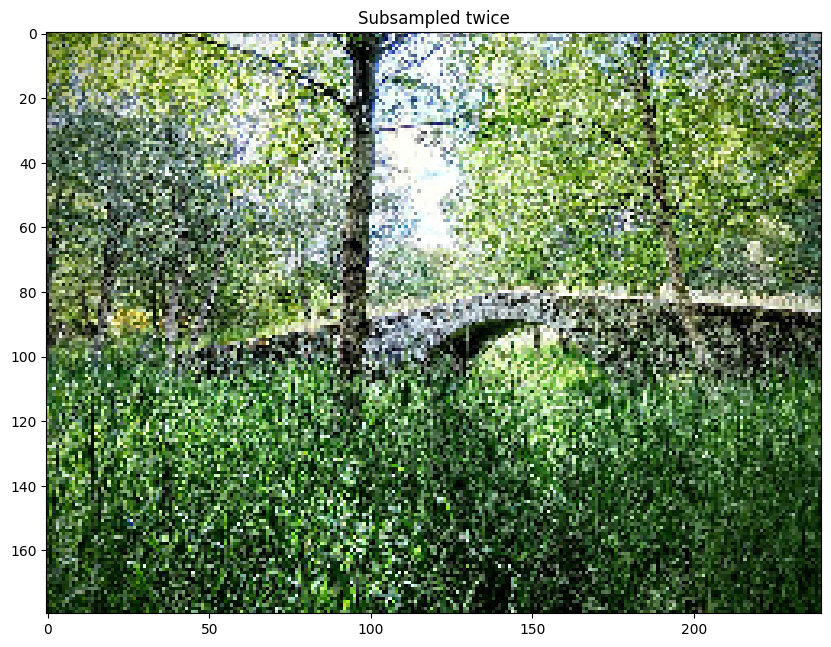

In [6]:
import cv2
import time
import numpy as np
import matplotlib.pyplot as plt 

#Load an image 
I = cv2.imread(intro_images_path +"bridge.jpg", 1)
if I is None:
    raise Exception("File not found!")
I = cv2.cvtColor(I, cv2.COLOR_BGR2RGB)

#subsampling of the original image and visualization at the relative scale
Int_sampling = 2
I2 = I[::Int_sampling,::Int_sampling,:]
I3 = I2[::Int_sampling,::Int_sampling,:]

plt.figure(figsize=[10,10]);plt.imshow(I);plt.title("Original");plt.show()
plt.figure(figsize=[5,5]);plt.imshow(I2);plt.title("Subsampled once"); plt.show()
plt.figure(figsize=[2.5,2.5]);plt.imshow(I3);plt.title("Subsampled twice");plt.show()

print('Sizes I1 = {}, I2 = {} e I3 = {}'.format(I.shape, I2.shape, I3.shape))

#Visualization at the same scale
plt.figure(figsize=[10,10]);plt.imshow(I);plt.title("Original");plt.show()
plt.figure(figsize=[10,10]);plt.imshow(I2);plt.title("Subsampled once"); plt.show()
plt.figure(figsize=[10,10]);plt.imshow(I3);plt.title("Subsampled twice");plt.show()


I1.shape.384x512



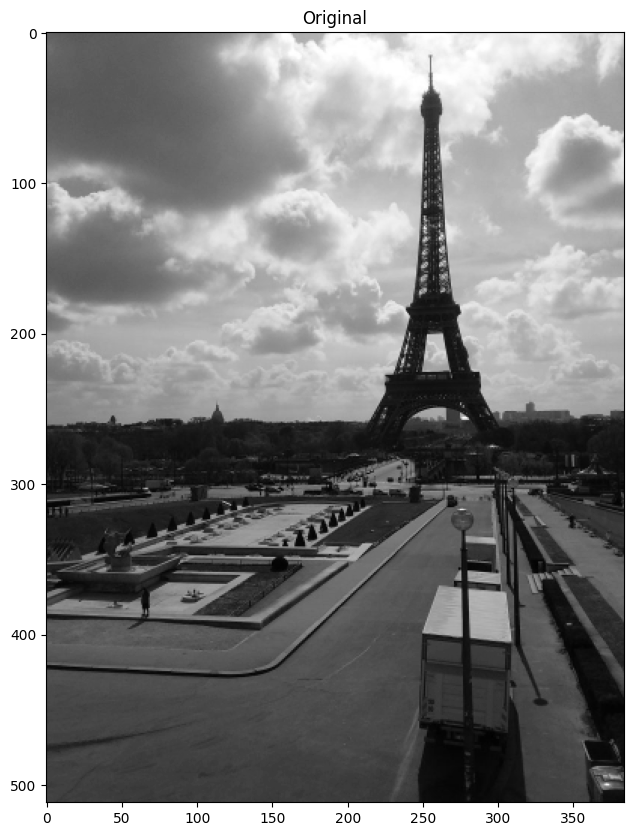

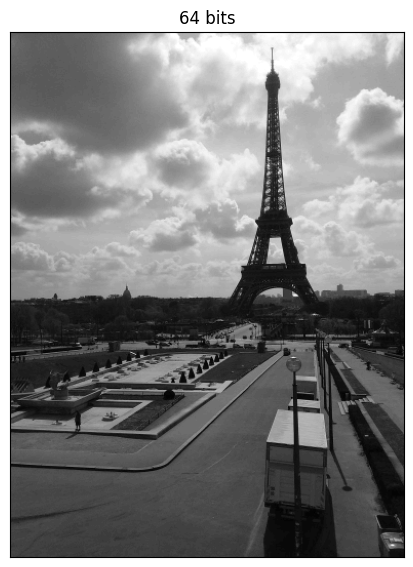

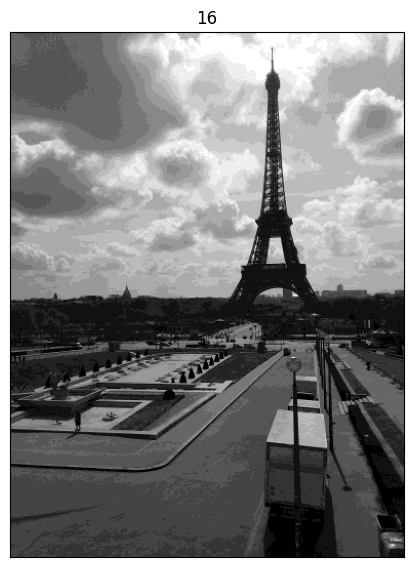

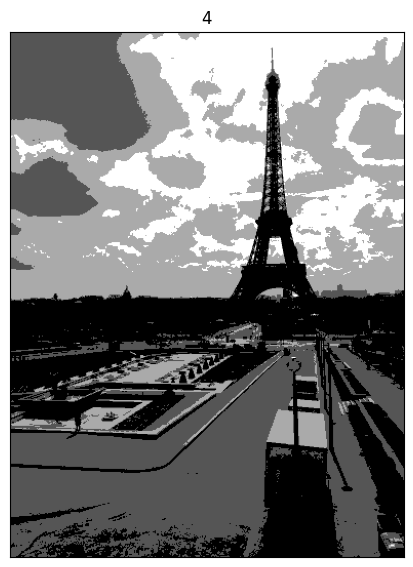

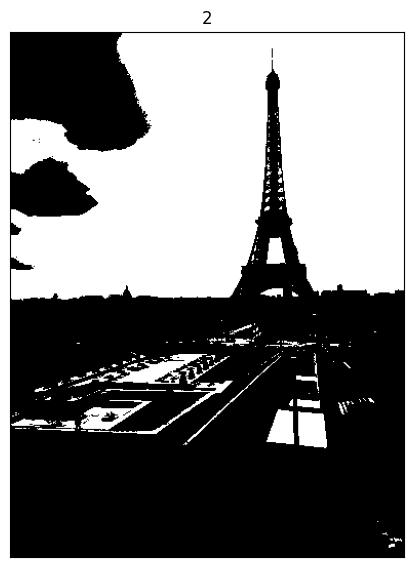

In [8]:
import cv2
import time
import numpy as np
import matplotlib.pyplot as plt 


#Load an image as gray-level
I0 = cv2.imread(intro_images_path +"eiffel.jpg", 0)
if I is None:
    raise Exception("File not found!")

I1 = cv2.resize(I0, fx = 0.5, fy = 0.5, dsize = None) # Resize image
height = I1.shape[0] #shape[0] The first dimension of the image , Height
width = I1.shape[1] #shape[1] The second dimension of the image , Width
print('I1.shape.{}x{}\n'.format(width, height))

plt.rcParams['image.cmap'] = 'gray'
plt.figure(figsize=[10,10]);plt.imshow(I1);plt.title("Original");plt.show()

# Create a matrix of the same size as the original image
#I2 = np.zeros((width, height), np.uint(8))
#I3 = np.zeros((width, height), np.uint(8))
#I4 = np.zeros((width, height), np.uint(8))
#I5 = np.zeros((width, height), np.uint(8))
#I6 = np.zeros((width, height), np.uint(8))

# Operate on the values of the original image matrix
I2 = np.uint8(I1/4) * 4
#I3 = np.uint8(I1/8) * 8
I4 = np.uint8(I1/16) * 16
#I5 = np.uint8(I1/32) * 32
I6 = np.uint8(I1/64) * 64
I7 = np.uint8(I1/128) * 128

# Display the resulting image
title = ['64 bits', '16', '4', '2'] # Subgraph title
img = [I2,I4,I6,I7]

for i in range(4):
    plt.figure(figsize=[15,15])
    plt.subplot(2, 2, i + 1) #python List from 0 Start counting , So here i+1
    plt.imshow(img[i], 'gray')
    plt.title(title[i])
    plt.xticks([]),plt.yticks([])
plt.show()

### Histogram Calculation in OpenCV

https://docs.opencv.org/4.x/d1/db7/tutorial_py_histogram_begins.html

OpenCV offers cv2.calcHist() function to find the histogram. Let’s familiarize with the function and its parameters :

**cv2.calcHist(images, channels, mask, histSize, ranges[, hist[, accumulate]])**

* images : source image of type uint8 or float32. it should be given in square brackets, ie, “[img]”.
    
* channels : it is also given in square brackets. It is the channel for which the histogram is computed. If source is grayscale  its value is [0]. For color images, you can pass [0],[1] or [2] to select blue, green or red channel respectively.
    
* mask : mask image. To find histogram of full image, it is given as “None”. But if you want to find histogram of particular region of image, you have to create a mask image for that and give it as mask. 
    
* histSize : BIN count. Need to be given in square brackets. For full scale, we pass [256].
    
* ranges : normally, it is [0,256].

So let us start with a sample image. Simply load the image in grayscale mode and find its full histogram.



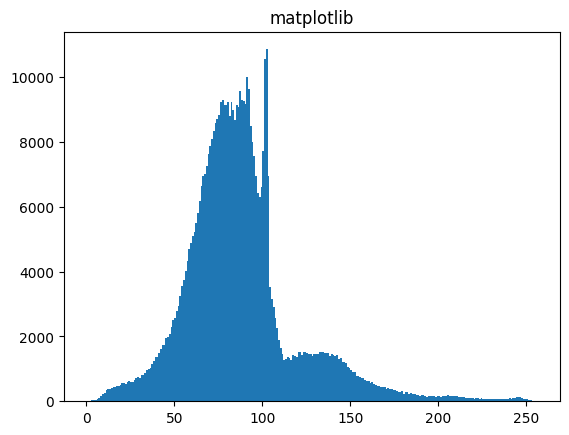

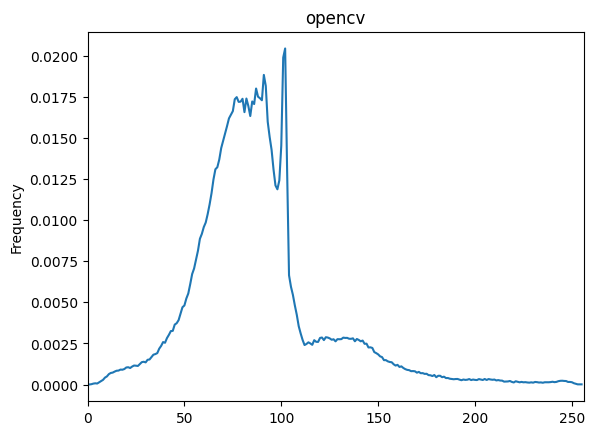

In [9]:
import numpy as np 
import cv2 
from matplotlib import pyplot as plt 

#using matplotlib function
img = cv2.imread(intro_images_path+'pazo.jpg',0)
plt.title("matplotlib")
plt.hist(img.ravel(),256,[0,256]); plt.show()

#using opencv function
hist_item = cv2.calcHist([img],[0],None,[256],[0,256]) 
hist_norm=hist_item/img.size
plt.plot(hist_norm)
plt.ylabel('Frequency')
plt.xlim([0,256])
plt.title("opencv")
plt.show()


hist is a 256x1 array, each value corresponds to the number of pixels in that image with its corresponding pixel value.

A mask (white rectangle) can be created this way:


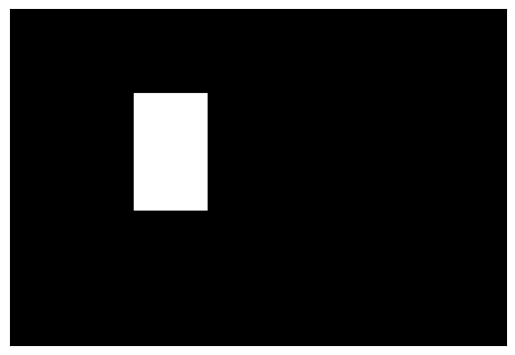

In [10]:
# Create the basic black image 
mask = np.zeros(img.shape, dtype = "uint8")

# Draw a white, filled rectangle on the mask image
x=int(0.25*img.shape[0])
y=int(0.25*img.shape[1])
h= int(0.35*img.shape[0])
w=int(0.15*img.shape[1])

#-1 for a filled rectangle
#cv2.rectangle(mask, (x,y), (x+h, y+w), (255, 255, 255), -1)
mask[x:x+h,y:y+w]=255

# Display constructed mask
#cv2.namedWindow("Mask", cv2.WINDOW_NORMAL)
#cv2.imshow("Mask", mask)
#cv2.waitKey(0)
plt.imshow(mask, cmap = 'gray')#, interpolation = 'bicubic')
plt.xticks([]), plt.yticks([])  # to hide tick values on X and Y axis
plt.show()


#### Histogram of a specific image region

Find the histogram for some specific image regions using masks.

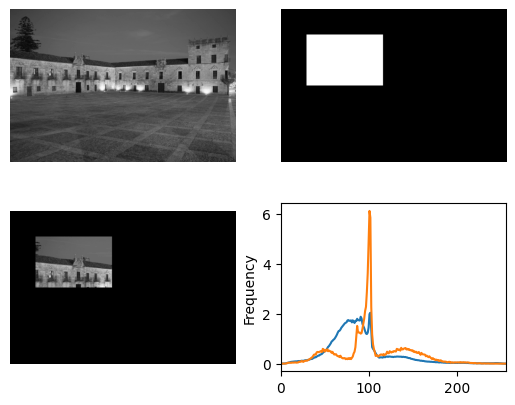

In [11]:
import numpy as np
import cv2 
import matplotlib.pyplot as plt

img = cv2.imread(intro_images_path+'pazo.jpg',0)
# create a mask
mask = np.zeros(img.shape[:2], np.uint8)
mask[100:300, 100:400] = 255
masked_img =cv2.bitwise_and(img,img,mask = mask)
# Calculate histogram with mask and without mask
# Check third argument for mask

hist_mask = cv2.calcHist([img],[0],mask,[256],[0,256])
hist_full = cv2.calcHist([img],[0],None,[256],[0,256])

plt.subplot(221), plt.imshow(img,'gray'), plt.axis('off')
plt.subplot(222), plt.imshow(mask,'gray'),plt.axis('off')
plt.subplot(223), plt.imshow(masked_img,'gray'),plt.axis('off')
hist_full_norm=100*hist_full/img.size
hist_mask_norm=100*hist_mask/(200*300)
#plt.ylabel('Frequency')
plt.subplot(224), plt.plot(hist_full_norm), plt.plot(hist_mask_norm)
plt.ylabel('Frequency')
plt.xlim([0,256])

plt.show()

### Image  geometric transformations


http://szeliski.org/Book/

https://docs.opencv.org/4.3.0/da/d6e/tutorial_py_geometric_transformations.html

There can be a number of basic operations we can perform in an image. OpenCV provides two transformation functions, **cv2.warpAffine()** and **cv2.warpPerspective()**, with which you can perform all kinds of transformations. cv2.warpAffine uses a 2x3 transformation matrix, M, while cv.warpPerspective takes a 3x3 one.

**dst = cv2.warpAffine(src, M, dsize[, dst[, flags[, borderMode[, borderValue]]]])**

**dst	= cv2.warpPerspective(src, M, dsize[, dst[, flags[, borderMode[, borderValue]]]])**



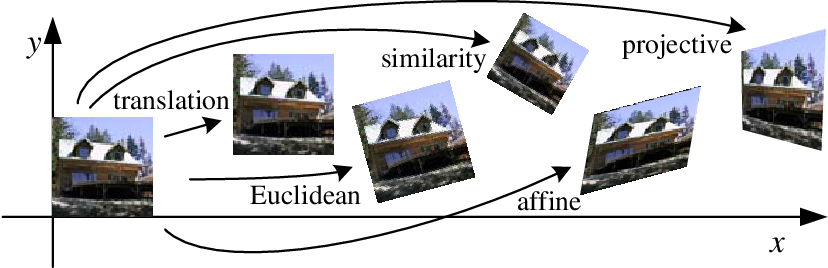

#### Image translation

Translation is the shifting of an object's location. If you know the shift in the (x,y) direction and let it be (tx,ty), you can create the transformation matrix **M** as follows:

    M=[[1, 0, tx],
       [0, 1, ty]]
   

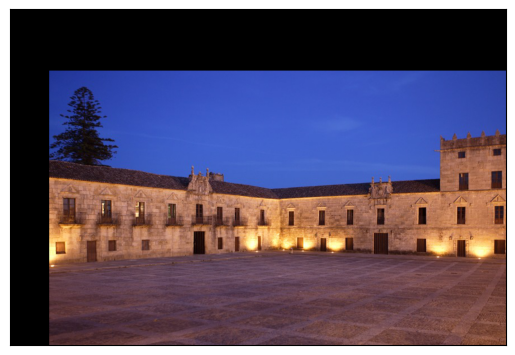

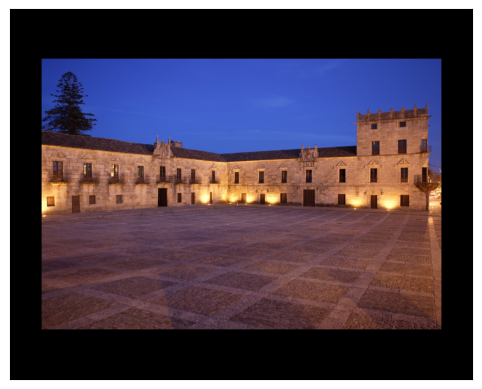

In [12]:
import numpy as np
from matplotlib import pyplot as plt
import cv2
import sys

# Load an color image in grayscale
img = cv2.imread(intro_images_path +'pazo.jpg')

if img is None:
  sys.exit('Failing at loading image')

img=cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
num_rows, num_cols = img.shape[:2]

translation_matrix = np.float32([ [1,0,70], [0,1,110] ])
#translation with image cropping
img_tc = cv2.warpAffine(img, translation_matrix, (num_cols, num_rows), cv2.INTER_LINEAR)

plt.imshow(img_tc)
plt.xticks([]), plt.yticks([])  
plt.show()

#translation without image cropping
img_t = cv2.warpAffine(img, translation_matrix, (num_cols+ 2*int(translation_matrix[0,2]), num_rows+ 2*int(translation_matrix[1,2])), cv2.INTER_LINEAR)

plt.imshow(img_t)
plt.xticks([]), plt.yticks([]) 
plt.show()

#### Image rotation

Rotation of an image for an angle θ is achieved by the transformation matrix of the form

    M=[[cosθ,  sinθ],
       [−sinθ, cosθ]]

OpenCV also provides scaled rotation with adjustable center of rotation so that you can rotate at any location you prefer.The modified transformation matrix is given by

    M=[[α,  β, (1−α)⋅center.x−β⋅center.y], 
       [-β  α, β⋅center.x+(1−α)⋅center.y]]

where:

    α=scale⋅cosθ,
    β=scale⋅sinθ

To find this transformation matrix, write the affine transformation yourself and call OpenCV functions **cv2.warpAffine(image, M, output_shape)**. Alternatively, OpenCV provides a function, **cv2.getRotationMatrix2D(center, angle, scale)**.


**Alternative 1**

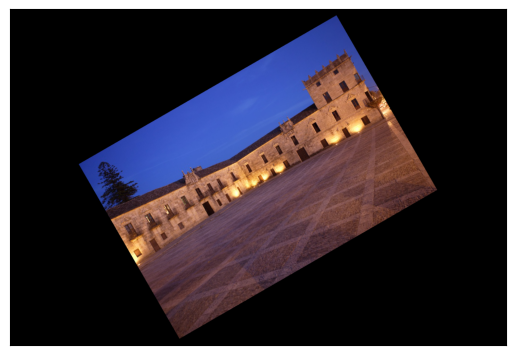

In [13]:
import numpy as np
from matplotlib import pyplot as plt
import cv2 


def get_affine_cv(t, r, s):
    sin_theta = np.sin(r)
    cos_theta = np.cos(r)
    
    a_11 = s * cos_theta
    a_21 = -s * sin_theta
    
    a_12 = s * sin_theta
    a_22 = s * cos_theta
        
    a_13 = t[0] * (1 - s * cos_theta) - s * sin_theta * t[1]
    a_23 = t[1] * (1 - s * cos_theta) + s * sin_theta * t[0]
                                                          
    return np.array([[a_11, a_12, a_13],[a_21, a_22, a_23]])

#Load an image 
img = cv2.imread(intro_images_path+'pazo.jpg')
img=cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
                    
rows,cols = img.shape[:2]
center=((cols-1)/2, (rows-1)/2)
angle=30
scale=0.6

                    
M = get_affine_cv(center, np.deg2rad(angle), scale)

img_r = cv2.warpAffine(img, M, (cols, rows))
                    
plt.imshow(img_r)
plt.xticks([]), plt.yticks([])  
plt.show()

**Alternative 2**

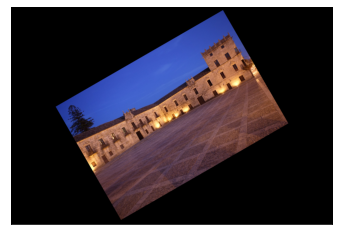

In [23]:
import numpy as np
import cv2 

img = cv2.imread(intro_images_path+'pazo.jpg')
img=cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

rows,cols = img.shape[:2]
center=((cols-1)/2, (rows-1)/2)
angle=30
scale=0.6

M=cv2.getRotationMatrix2D(center, angle, scale)

img_r = cv2.warpAffine(img, M, (cols,rows))

plt.imshow(img_r)
plt.xticks([]), plt.yticks([]) 
plt.show()

#### Image scaling

This is a commonly used method in the computer vision and image processing area where we try to resize the image according to the requirement. Roughly we perform two things in the image scaling: either we enlarge the image or we shrink the image; in OpenCV, we have function **cv2.resize(src, dsize[, dst[, fx[, fy[, interpolation]]]])**; using this, we can perform the scaling of the image.

Here are the **interpolation** methods provided by OpenCV:

- cv2.INTER_AREA uses pixel area relation for resampling. This is the best method for reducing the size of an image. When used for zooming into the image, it uses the INTER_NEAREST method.
    
- cv2.INTER_CUBIC uses bicubic interpolation for resizing. This method performs calculations based on the 4×4 neighboring pixels for the pixels. It takes the weighted average of these 16 pixels to create a new pixel.

- cv2.INTER_LINEAR is similar to the INTER_CUBIC interpolation. However, INTER_CUBIC only uses 2×2 neighboring pixels to get the weighted average for the pixels.

- cv2.INTER_NEAREST uses the nearest neighbor concept for interpolation. This uses only one neighboring pixel from the image for interpolation.

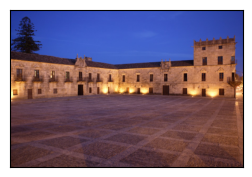

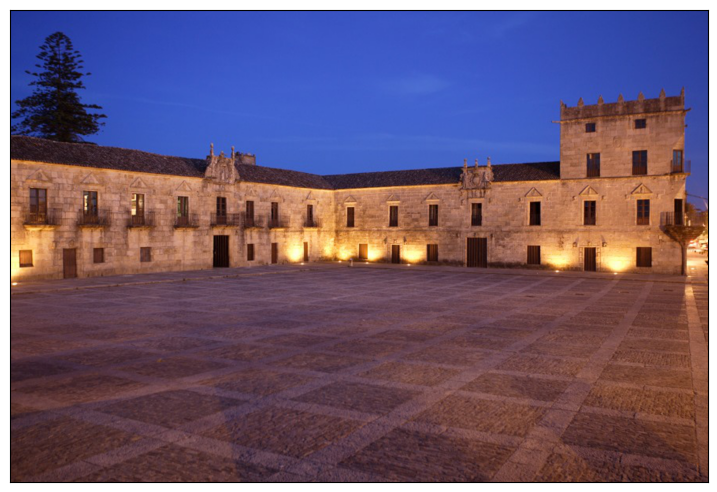

In [14]:
import numpy as np
from matplotlib import pyplot as plt
import cv2 
import matplotlib
#matplotlib.rcParams['figure.figsize'] = (6.0, 6.0)

#Load an color image in grayscale
img = cv2.imread(intro_images_path+'pazo.jpg')
img=cv2.cvtColor(img, cv2.COLOR_BGR2RGB) 

img_shrinked = cv2.resize(img,None,fx=0.5, fy=0.5, interpolation = cv2.INTER_AREA)
plt.figure(figsize= (0.01*img_shrinked.shape[0],0.01*img_shrinked.shape[1]));plt.imshow(img_shrinked)
plt.xticks([]), plt.yticks([])  # to hide tick values on X and Y axis
plt.show()


img_enlarged = cv2.resize(img,None,fx=1.5, fy=1.5, interpolation = cv2.INTER_CUBIC)
plt.figure(figsize= (0.01*img_enlarged.shape[0],0.01*img_enlarged.shape[1]));plt.imshow(img_enlarged)
plt.xticks([]), plt.yticks([]) 
plt.show()

#### Affine Transformations

https://docs.opencv.org/4.3.0/df/d9d/tutorial_py_colorspaces.html

https://docs.opencv.org/3.4.2/df/d9d/tutorial_py_colorspaces.html

In affine transformations all parallel lines in the source image will still be parallel in the output image. To find the transformation matrix, we need three points from the input image and their corresponding locations in the output image. Then **cv2.getAffineTransform()** will create a 2x3 matrix which is to be passed to **cv2.warpAffine()**.

#### In this example, points that define the transformation are collected manually

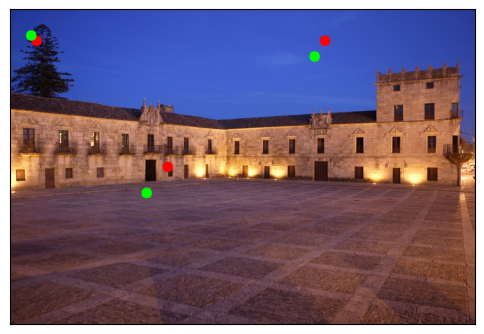

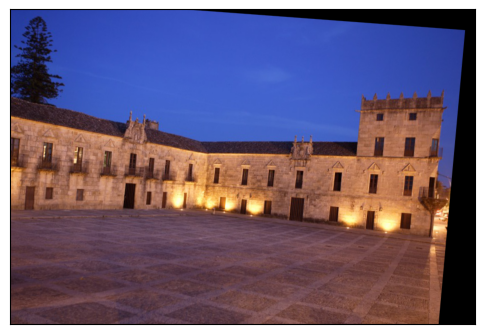

In [15]:
import numpy as np
from matplotlib import pyplot as plt
import cv2 
import matplotlib
#matplotlib.rcParams['figure.figsize'] = (6.0, 6.0)

#Load an color image in grayscale
img = cv2.imread(intro_images_path+'pazo.jpg')
img=cv2.cvtColor(img, cv2.COLOR_BGR2RGB) 

image=img.copy()

# Handpicked correspondences
pts1 = np.float32([[50,60],[600,60],[300,300]])
pts2 = np.float32([[40,50],[580,90],[260,350]])

for pt in pts1:
    cv2.circle(image, (int(pt[0]), int(pt[1])),10, (255, 0, 0),-1)
for pt in pts2:
    cv2.circle(image, (int(pt[0]), int(pt[1])),10, (0, 255, 0),-1)

M = cv2.getAffineTransform(pts1,pts2)
dst = cv2.warpAffine(img,M,(cols,rows))


plt.figure(figsize= (0.01*image.shape[0],0.01*image.shape[1]));plt.imshow(image)
plt.xticks([]), plt.yticks([])  # to hide tick values on X and Y axis
plt.show()

plt.figure(figsize= (0.01*dst.shape[0],0.01*dst.shape[1]));plt.imshow(dst)
plt.xticks([]), plt.yticks([])  # to hide tick values on X and Y axis
plt.show()


#### Perspective transformation

Perspective transformations are defined by a 3x3 transformation matrix. Straight lines will remain straight even after the transformation. To find this transformation matrix, you need 4 points on the first view and corresponding points on the second view. Among these 4 points, 3 of them should not be collinear. Then the transformation matrix can be found by the function **cv2.getPerspectiveTransform**. Then apply **c2v.warpPerspective** with this 3x3 transformation matrix.

The function cv2.warpPerspective() applies a perspective transformation to an image:

**dst=cv2.warpPerspective(src, h, dsize)**

    src: input image.
    
    dst: output image that has the size dsize and the same type as src.
    
    h: homography (3×3 transformation matrix).
    
    Dsize: size of the output image.

#### In this example, points that define the transformation are collected manually

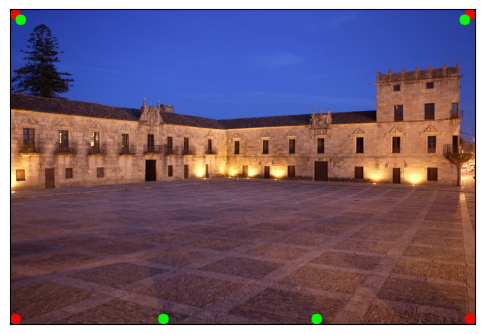

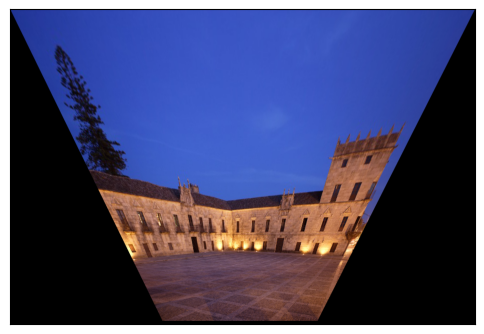

In [16]:
from matplotlib import pyplot as plt
import cv2 
import matplotlib
#matplotlib.rcParams['figure.figsize'] = (6.0, 6.0)

#Load an color image in grayscale
img = cv2.imread(intro_images_path+'pazo.jpg')
img=cv2.cvtColor(img, cv2.COLOR_BGR2RGB) 

rows, cols=img.shape[:2]

# Handpicked correspondences
pts1 = np.float32([[10,10], [cols-10,10], [10,rows-10], [cols-10,rows-10]])
pts2 = np.float32([[20,20], [cols-20,20], [int(0.33*cols),rows-10], [int(0.66*cols),rows-10]])

P_M = cv2.getPerspectiveTransform(pts1, pts2)
dst = cv2.warpPerspective(img, P_M, (cols,rows))

image=img.copy()

for pt in pts1:
    cv2.circle(image, (int(pt[0]), int(pt[1])),10, (255, 0, 0),-1)
for pt in pts2:
    cv2.circle(image, (int(pt[0]), int(pt[1])),10, (0, 255, 0),-1)


plt.figure(figsize= (0.01*image.shape[0],0.01*image.shape[1]));plt.imshow(image)
plt.xticks([]), plt.yticks([])  # to hide tick values on X and Y axis
plt.show()

plt.figure(figsize= (0.01*dst.shape[0],0.01*dst.shape[1]));plt.imshow(dst)
plt.xticks([]), plt.yticks([])  # to hide tick values on X and Y axis
plt.show()



### Exercise: Compute the homography between two views of the same scene

Chose 4 (not all aligned) matching points

In [19]:
import cv2 
import numpy as np 
from matplotlib import pyplot as plt 

# Read first view 
im1 = cv2.imread(intro_images_path+'library1.jpg',  cv2.IMREAD_COLOR) 

# Read second view 
im2 = cv2.imread(intro_images_path+'library2.jpg', cv2.IMREAD_COLOR) 


# Chose 4 (not all aligned) corresponding points between these images
# WRITE DOWN THEIR COODINATES!!

#####################################################################
# Chosen points : 
# im1 : (125,165), (444,67), (13, 149), (280, 245)
# im2 : (128, 167), (392, 39), (57, 158), (237, 241)

# Handpicked correspondences
pts1 = np.float32([[125,165],[444,67],[13,149],[280,245]])

for pt in pts1:
    cv2.circle(im1, (int(pt[0]), int(pt[1])),5, (255, 0, 0),-1)
    
# Handpicked correspondences
pts2 = np.float32([[128,167],[392,39],[57,158],[237,241]])

for pt in pts2:
    cv2.circle(im2, (int(pt[0]), int(pt[1])),5, (255, 0, 0),-1)
#####################################################################

cv2.imshow('View 1', im1)
cv2.imshow('View 2', im2)

k = cv2.waitKey(0) & 0xFF
if k == 27:         # wait for ESC key to exit
    cv2.destroyAllWindows()

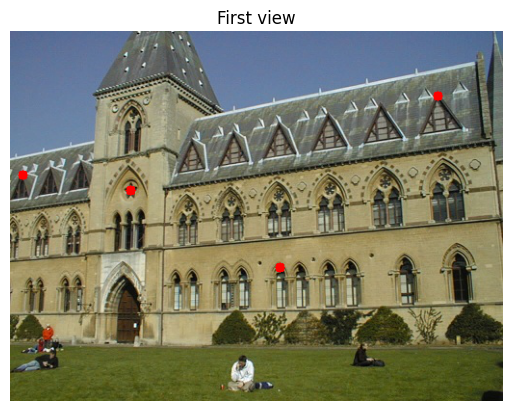

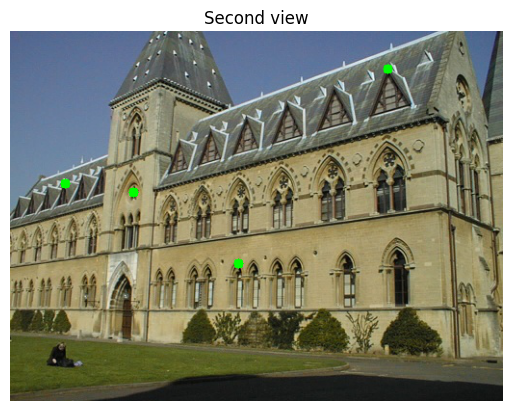

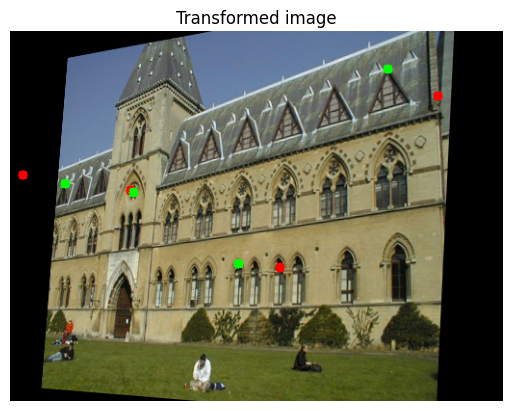

Estimated homography : 
 [[ 5.73052578e-01 -7.33662577e-02  5.95436389e+01]
 [-1.24287365e-01  8.66862485e-01  2.78524624e+01]
 [-4.65979916e-04 -6.98173614e-05  1.00000000e+00]]


In [21]:
import cv2 
import numpy as np 
from matplotlib import pyplot as plt 

# Read first view 
im1 = cv2.imread(intro_images_path+'library1.jpg',  cv2.IMREAD_COLOR) 

# Read second view 
im2 = cv2.imread(intro_images_path+'library2.jpg', cv2.IMREAD_COLOR) 

im1=cv2.cvtColor(im1, cv2.COLOR_BGR2RGB) 
im2=cv2.cvtColor(im2, cv2.COLOR_BGR2RGB) 


# Location of reference points
points1 = np.zeros((4, 2), dtype=np.float32) 
points2 = np.zeros((4, 2), dtype=np.float32) 

# INSERT HERE THE COORDINATES YOU HAVE WROTE DOWN 
# CHANGING THE CURRENT VALUES!!
points1[0, :] = [125,165]
points1[1, :] = [444,67]
points1[2, :] = [13,149]
points1[3, :] = [280,245]

points2[0, :] = [128,167]
points2[1, :] = [392,39]
points2[2, :] = [57,158]
points2[3, :] = [237,241]

im1c=im1.copy()
im2c=im2.copy()


for pt in points1:
    cv2.circle(im1c, (int(pt[0]), int(pt[1])),5, (255, 0, 0),-1)
for pt in points2:
    cv2.circle(im2c, (int(pt[0]), int(pt[1])),5, (0, 255, 0),-1)
    
plt.imshow(im1c), plt.title("First view")
plt.axis('off')
plt.show() 
plt.imshow(im2c), plt.title("Second view")
plt.axis('off')
plt.show()

# Find homography 
h, mask = cv2.findHomography(points1, points2, cv2.RANSAC) 

# Use homography to align im1 with im2 
height1, width1, _ = im1.shape 
height2, width2, _ = im2.shape 

#Aligned image im1Reg, using a 3x3 transformation matrix 
imP = cv2.warpPerspective(im1, h, (1*width1 + 0*width2, 1*height1+ 0*height2)) 


for pt in points1:
    cv2.circle(imP, (int(pt[0]), int(pt[1])),5, (255, 0, 0),-1)
for pt in points2:
    cv2.circle(imP, (int(pt[0]), int(pt[1])),5, (0, 255, 0),-1)
    
plt.imshow(imP), plt.title("Transformed image")
plt.axis('off')
plt.show()

# Print estimated homography 
print("Estimated homography : \n",  h) 

### Exercise: Combining two images

PNG images usually have four channels. Three color channels for RGB, and the fourth channel is for transparency, also called alpha channel.

In [22]:
import cv2 
import numpy as np 
from matplotlib import pyplot as plt 

# Read first view 
im1 = cv2.imread(intro_images_path+'Logo_Paris.png', cv2.IMREAD_COLOR) 

# Read second view 
im2 = cv2.imread(intro_images_path+'eiffel.jpg', cv2.IMREAD_COLOR) 


## Chose 4 (not all aligned) corresponging points
####################################################### Me here

# Handpicked correspondences
pts1 = np.float32([[300,0],[300,1800],[1800,0],[1800,1800]])

for pt in pts1:
    cv2.circle(im1, (int(pt[0]), int(pt[1])),5, (255, 0, 0),-1)
    
# Handpicked correspondences
pts2 = np.float32([[150,150],[150,350],[375,150],[375,350]])

for pt in pts2:
    cv2.circle(im2, (int(pt[0]), int(pt[1])),5, (255, 0, 0),-1)

####################################################### End Me here

cv2.imshow('View 1', im1)
cv2.imshow('View 2', im2)

k = cv2.waitKey(0) & 0xFF
if k == 27:         # wait for ESC key to exit
    cv2.destroyAllWindows()

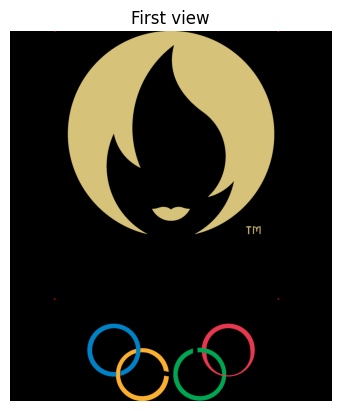

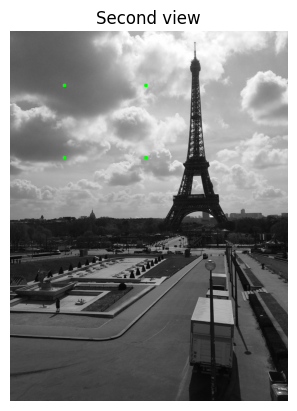

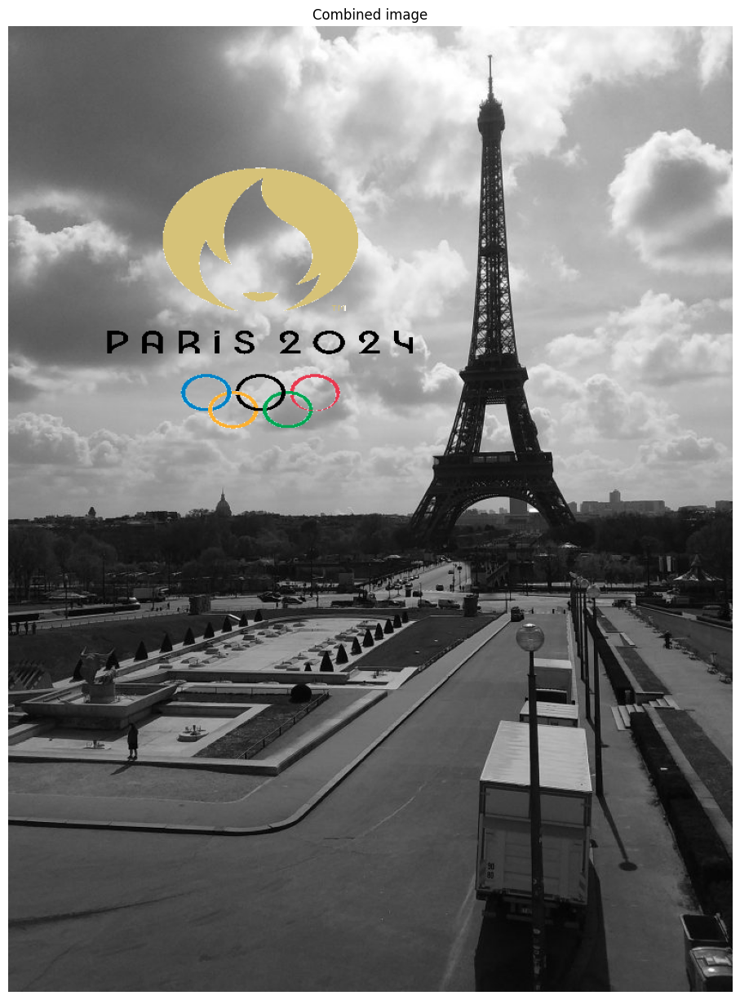

Estimated homography : 
 [[1.50000000e-01 0.00000000e+00 1.05000000e+02]
 [0.00000000e+00 1.11111111e-01 1.50000000e+02]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]


In [2]:
import cv2 
import numpy as np 
from matplotlib import pyplot as plt 

# Read first view 
im1 = cv2.imread(intro_images_path+'Logo_Paris.png', cv2.IMREAD_UNCHANGED) 

# Read second view 
im2 = cv2.imread(intro_images_path+'eiffel.jpg', cv2.IMREAD_COLOR) 

mask=im1[:,:,3]
im1=cv2.cvtColor(im1, cv2.COLOR_BGR2RGB) 
im2=cv2.cvtColor(im2, cv2.COLOR_BGR2RGB) 

# Location of reference points
points1 = np.zeros((4, 2), dtype=np.float32) 
points2 = np.zeros((4, 2), dtype=np.float32) 

points1[0, :] = [300,0]
points1[1, :] = [300,1800]
points1[2, :] = [1800, 0]
points1[3, :] = [1800,1800]

points2[0, :] = [150,150]
points2[1, :] = [150,350]
points2[2, :] = [375,150]
points2[3, :] = [375,350]

im1c=im1.copy()
im2c=im2.copy()

for pt in points1:
    cv2.circle(im1c, (int(pt[0]), int(pt[1])),5, (255, 0, 0),-1)
for pt in points2:
    cv2.circle(im2c, (int(pt[0]), int(pt[1])),5, (0, 255, 0),-1)
    
plt.imshow(im1c), plt.title("First view")
plt.axis('off')
plt.show() 
plt.imshow(im2c), plt.title("Second view")
plt.axis('off')
plt.show()

# Find homography 
h,_ = cv2.findHomography(points1, points2, cv2.RANSAC) 

# Use homography to align im1 with im2 
height1, width1, _ = im1c.shape 
height2, width2, _ = im2c.shape 

#Aligned image im1, using a 3x3 transformation matrix 
imP = cv2.warpPerspective(im1, h, (width2,height2))
maskP= cv2.warpPerspective(mask, h, (width2,height2))

maskP_inv = cv2.bitwise_not(maskP)

im_bg = cv2.bitwise_and(im2,im2,mask = maskP_inv)
im_fg = cv2.bitwise_and(imP,imP,mask = maskP)

res=cv2.add(im_bg,im_fg)# mask=im_mP)

plt.figure(figsize= (0.02*res.shape[0],0.02*res.shape[1]));
plt.imshow(res), plt.title("Combined image")
plt.axis('off')
plt.show()

# Print estimated homography 

print("Estimated homography : \n",  h) 

---
---

### EXERCISE 1: Image Geometric Transformations

Transform the image torre_hercules_1.jpg to get a view of the same scene as if it were captured from the same point of view  as is observed torre_hercules_2.jpg

---
---

In [10]:
#SOLUTION HERE
import cv2 
import numpy as np 
from matplotlib import pyplot as plt 

# Read first view 
im1 = cv2.imread(intro_images_path+'torre_hercules_1.jpg', cv2.IMREAD_COLOR) 

# Read second view 
im2 = cv2.imread(intro_images_path+'torre_hercules_2.jpg', cv2.IMREAD_COLOR) 

## Chose 4 (not all aligned) corresponging points
####################################################### Me here

# Handpicked correspondences
pts1 = np.float32([[670,25],[805,610],[680,510],[725,1255]])

for pt in pts1:
    cv2.circle(im1, (int(pt[0]), int(pt[1])),5, (0, 0, 255),-1)
    
# Handpicked correspondences
pts2 = np.float32([[375,50],[415,55],[200,280],[272,830]])

for pt in pts2:
    cv2.circle(im2, (int(pt[0]), int(pt[1])),5, (255, 0, 0),-1)

####################################################### End Me here

cv2.imshow('View 1', im1)
cv2.imshow('View 2', im2)

k = cv2.waitKey(0) & 0xFF
if k == 27:         # wait for ESC key to exit
    cv2.destroyAllWindows()


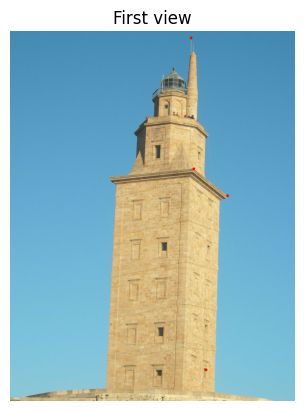

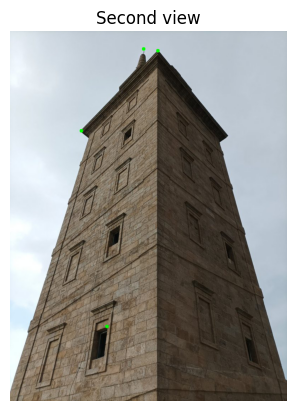

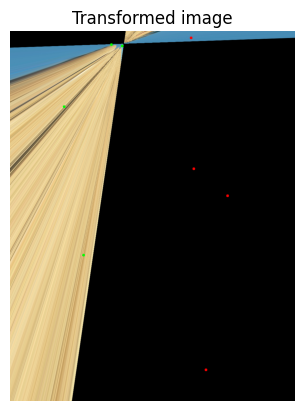

Estimated homography : 
 [[-6.53275695e-01  3.95057381e-02  4.22932337e+02]
 [-7.23310797e-02  1.96669925e-03  4.65760246e+01]
 [-1.55094006e-03  9.58886219e-05  1.00000000e+00]]


In [15]:
import cv2 
import numpy as np 
from matplotlib import pyplot as plt 

# Read first view 
im1 = cv2.imread(intro_images_path+'torre_hercules_1.jpg',  cv2.IMREAD_COLOR) 

# Read second view 
im2 = cv2.imread(intro_images_path+'torre_hercules_2.jpg', cv2.IMREAD_COLOR) 

im1=cv2.cvtColor(im1, cv2.COLOR_BGR2RGB) 
im2=cv2.cvtColor(im2, cv2.COLOR_BGR2RGB) 


# Location of reference points
points1 = np.zeros((4, 2), dtype=np.float32) 
points2 = np.zeros((4, 2), dtype=np.float32) 

# INSERT HERE THE COORDINATES YOU HAVE WROTE DOWN 
# CHANGING THE CURRENT VALUES!!
points1[0, :] = [670,25]
points1[1, :] = [805,610]
points1[2, :] = [680,510]
points1[3, :] = [725,1255]

points2[0, :] = [375,50]
points2[1, :] = [415,55]
points2[2, :] = [200,280]
points2[3, :] = [272,830]

im1c=im1.copy()
im2c=im2.copy()


for pt in points1:
    cv2.circle(im1c, (int(pt[0]), int(pt[1])),5, (255, 0, 0),-1)
for pt in points2:
    cv2.circle(im2c, (int(pt[0]), int(pt[1])),5, (0, 255, 0),-1)
    
plt.imshow(im1c), plt.title("First view")
plt.axis('off')
plt.show() 
plt.imshow(im2c), plt.title("Second view")
plt.axis('off')
plt.show()

# Find homography 
h, mask = cv2.findHomography(points1, points2, cv2.RANSAC) 

# Use homography to align im1 with im2 
height1, width1, _ = im1.shape 
height2, width2, _ = im2.shape 

#Aligned image im1Reg, using a 3x3 transformation matrix 
imP = cv2.warpPerspective(im1, h, (1*width1 + 0*width2, 1*height1+ 0*height2)) 


for pt in points1:
    cv2.circle(imP, (int(pt[0]), int(pt[1])),5, (255, 0, 0),-1)
for pt in points2:
    cv2.circle(imP, (int(pt[0]), int(pt[1])),5, (0, 255, 0),-1)
    
plt.imshow(imP), plt.title("Transformed image")
plt.axis('off')
plt.show()

# Print estimated homography 
print("Estimated homography : \n",  h) 

# Explanation of the decisions made : 
# I chose these four points because, given the orientation 
# of the tower of hercules in both images, the highest bar  
# on top of the tower is on the right side in the first image,
# and it is on the left side in the second image. So I had to 
# the four corresponding points in the correct side of the tower.
# The points are chosen in different key points.

# Discussion and results : 
# The output in the resulting image is expected, given that 
# the approximate angle between the two views in the two initial 
# images is around 90 degree, so the resulting transformation 
# is not the easiest one. If I decided to ignore the orientation 
# of the initial image and just consider that all Hercules tower' 
# sides are identical, the resulting image would've been way more
# clear. But, as we can see from the position of the top bar of the
# tower, the tower' sides aren't identical.

---
---
## 2 Image Processing

- Arithmetic and logical operation
- Histogram equalization
- Convolution
- Correlation
- Image pyramids
- Template matching



http://szeliski.org/Book/

### Image difference 

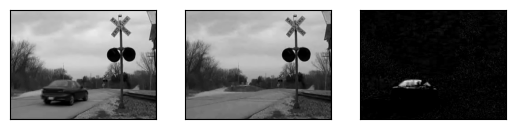

In [16]:
import numpy as np
import cv2 
import matplotlib.pyplot as plt

bg = cv2.imread(intro_images_path+'background.png',0)
fg = cv2.imread(intro_images_path+'foreground.png',0)

motion =np.absolute(cv2.subtract(fg,bg))

#plt.figure(figsize= (0.1*img.shape[0],0.1*img.shape[1]))
plt.subplot(131), plt.imshow(fg, 'gray')
plt.xticks([]), plt.yticks([])
plt.subplot(132), plt.imshow(bg,'gray')
plt.xticks([]), plt.yticks([])
plt.subplot(133), plt.imshow(motion, 'gray')
plt.xticks([]), plt.yticks([])
#plt.subplot(224), plt.plot(hist_full)
plt.show()

### Histogram Equalization in OpenCV

https://docs.opencv.org/3.4.2/d5/daf/tutorial_py_histogram_equalization.html

OpenCV has a function to do this, cv2.equalizeHist(). Its input is just a grayscale image and output is its histogram equalized image. You can take different images with different light conditions, equalize  them and check the results.

Histogram equalization is good when the histogram of an image is confined to a particular region. It doesn’t work on images  where both bright and dark pixels are present. In these cases and adaptive equalization is more combinient.

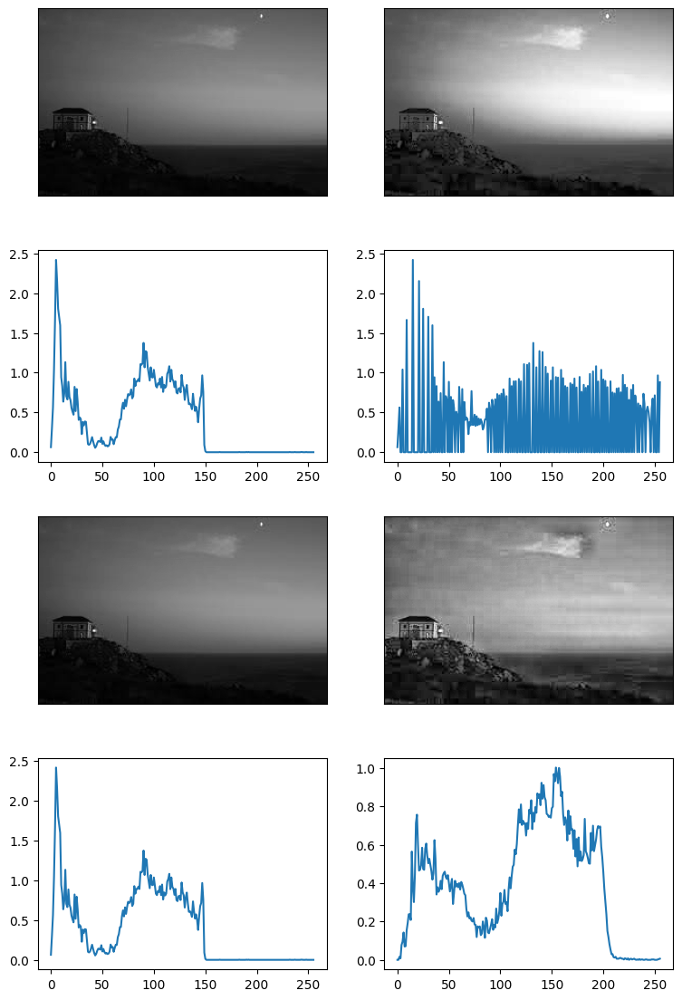

In [17]:
img = cv2.imread(intro_images_path+'fisterra_gray.jpg',0)
equ = cv2.equalizeHist(img)
#res = np.hstack((img,equ)) #stacking images side-by-side
#cv2.imwrite('fisterra_gray_eq.png',res)

plt.figure(figsize= (0.05*img.shape[0],0.05*img.shape[1]))

plt.subplot(421), plt.imshow(img, 'gray')
plt.xticks([]), plt.yticks([]) 
plt.subplot(422), plt.imshow(equ,'gray')
plt.xticks([]), plt.yticks([])

hist = cv2.calcHist([img],[0],None,[256],[0,256])
hist_norm=100*hist/img.size
plt.subplot(423), plt.plot(hist_norm)
hist = cv2.calcHist([equ],[0],None,[256],[0,256])
hist_norm=100*hist/equ.size
plt.subplot(424), plt.plot(hist_norm)


plt.subplot(425), plt.imshow(img, 'gray')
plt.xticks([]), plt.yticks([]) 

#Adaptive histogram equalization
clahe = cv2.createCLAHE(clipLimit=4.0, tileGridSize=(16,16))
cl1 = clahe.apply(img)
plt.subplot(426), plt.imshow(cl1,'gray')
plt.xticks([]), plt.yticks([]) 

hist = cv2.calcHist([img],[0],None,[256],[0,256])
hist_norm=100*hist/img.size
plt.subplot(427), plt.plot(hist_norm)
hist = cv2.calcHist([cl1],[0],None,[256],[0,256])
hist_norm=100*hist/cl1.size
plt.subplot(428), plt.plot(hist_norm)

plt.show()

### Convolution and Correlation

#### Convolution filtering

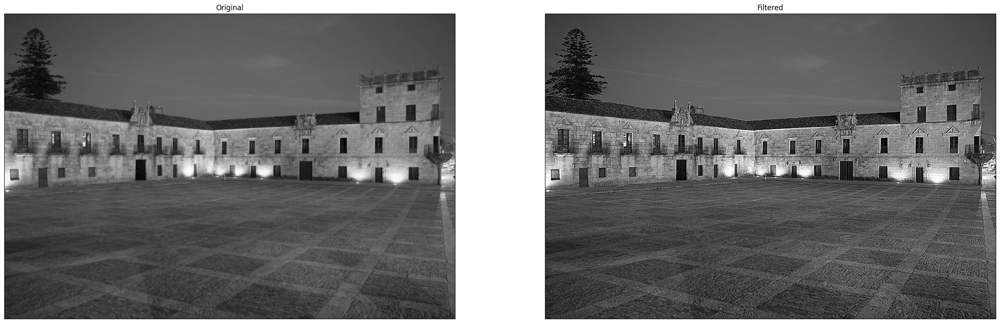

In [18]:
import cv2
import numpy as np
from matplotlib import pyplot as plt

img = cv2.imread(intro_images_path+'pazo.jpg',0)
kernel = np.array([[0, -1, 0], [-1, 5, -1],[0, -1,0]]) 
dst = cv2.filter2D(img,0,kernel)

plt.figure(figsize= (0.05*img.shape[0],0.05*img.shape[1]))
plt.subplot(121),plt.imshow(img,'gray'), plt.title('Original')
plt.xticks([]), plt.yticks([])
plt.subplot(122),plt.imshow(dst,'gray'), plt.title('Filtered')
plt.xticks([]), plt.yticks([])
plt.show()

#### Convolution for image smoothing (blurring)

Image blurring is achieved by convolving the image with a low-pass filter kernel taht removes high frequency content (eg: noise, edges). Edges are blurred a little bit in this operation. There are several blurring techniques:

***Mean filtering:***

The idea of mean filtering is simply to replace each pixel value in an image with the mean value of its neighbors, including itself. 
This is done in by convolving an image with a normalized box filter. Opencv provide us with the function **cv.blur()**, which takes the width and height of the kernel as parameters. A 3x3 normalized box filter would look like the below:

    K=[[1/9 1/9 1/9],
       [1/9 1/9 1/9],
       [1/9 1/9 1/9]]
       
 ***Gaussian average***

In Gaussian Blur operation, the image is convolved with a Gaussian filter instead of the box filter. Opencv provide us with the **GaussianBlur(src, dst, ksize, sigma)** method, which accepts the following parameters −

    src − input image

    dst − output image)

    ksize − size of the kernel.

    sigmaX − Gaussian kernel standard deviation in X and Y directions.


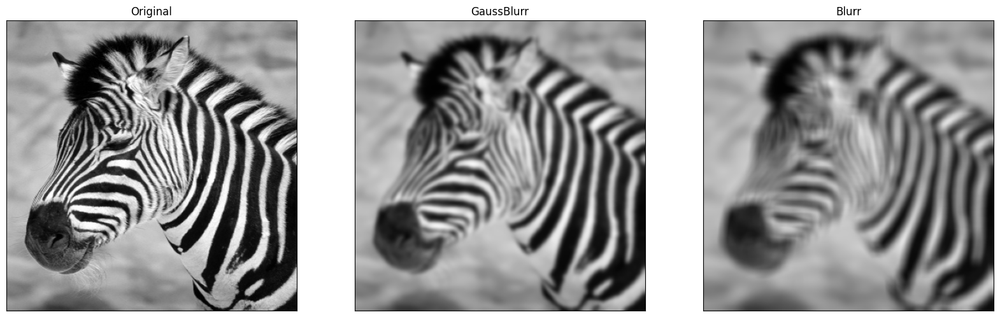

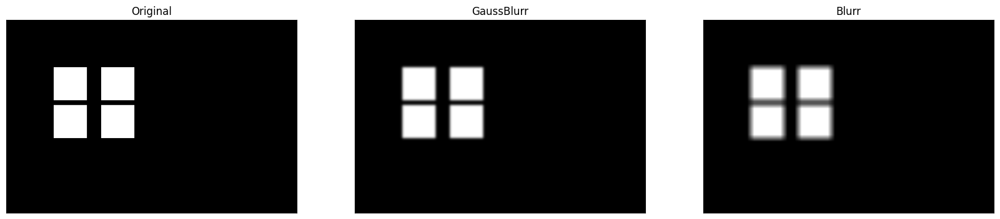

In [19]:
import cv2
import numpy as np
from matplotlib import pyplot as plt

img = cv2.imread(intro_images_path+'zebra.jpg')

blur1 = cv2.GaussianBlur(img,(15,15),0)
blur2 = cv2.blur(img,(15,15))

plt.figure(figsize= (0.05*img.shape[0],0.05*img.shape[1]))
plt.subplot(131),plt.imshow(img),plt.title('Original')
plt.xticks([]), plt.yticks([])
plt.subplot(132),plt.imshow(blur1,'gray'),plt.title('GaussBlurr')
plt.xticks([]), plt.yticks([])
plt.subplot(133),plt.imshow(blur2),plt.title('Blurr')
plt.xticks([]), plt.yticks([])
plt.show()

cv2.imwrite(output_images_path+'zebragb.jpg',blur1)
cv2.imwrite(output_images_path+'zebrab.jpg',blur2)


img = cv2.imread(intro_images_path+'gate.jpg')

img2 = np.zeros(img.shape[:2], np.uint8)
img2[100:170, 100:170] = 255
img2[180:250, 100:170] = 255
img2[100:170, 200:270] = 255
img2[180:250, 200:270] = 255
blur1 = cv2.GaussianBlur(img2,(15,15),0)
blur2 = cv2.blur(img2,(15,15))

plt.figure(figsize= (0.05*img2.shape[0],0.05*img2.shape[1]))
plt.subplot(131),plt.imshow(img2,'gray'),plt.title('Original')
plt.xticks([]), plt.yticks([])
plt.subplot(132),plt.imshow(blur1,'gray'),plt.title('GaussBlurr')
plt.xticks([]), plt.yticks([])
plt.subplot(133),plt.imshow(blur2,'gray'),plt.title('Blurr')
plt.xticks([]), plt.yticks([])
plt.show()

#### Correlation filtering

### Exercise: Template Matching
https://docs.opencv.org/3.4.2/d4/dc6/tutorial_py_template_matching.html

Template Matching is a method for searching and finding the location of a template image in a larger image. OpenCV comes with a function cv2.matchTemplate() for this purpose. It simply slides the template image (T) over the input image (I), as in 2D correlation, and compares the template against each patch of the input image to give the image (R). Several comparison methods are implemented in OpenCV. They return a grayscale image (R), where each pixel denotes how much does the neighbourhood of that pixel match with template.

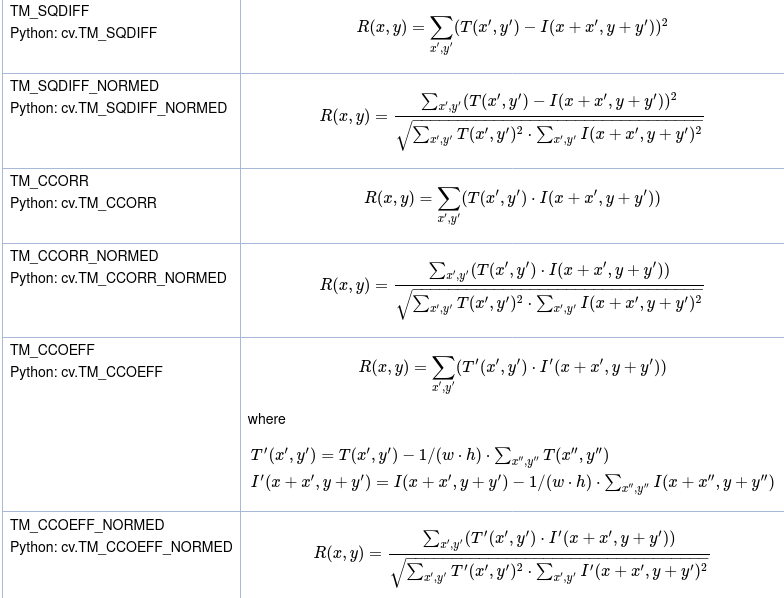

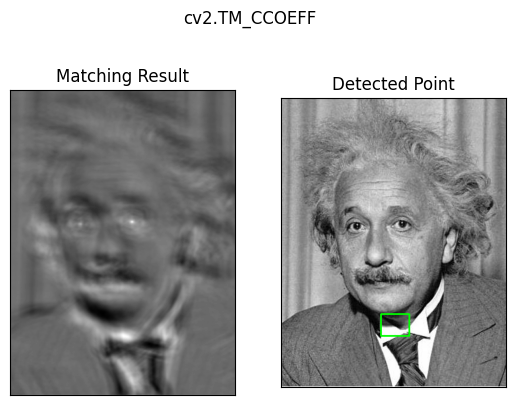

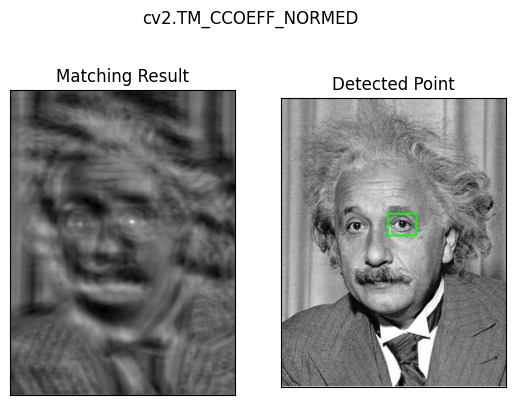

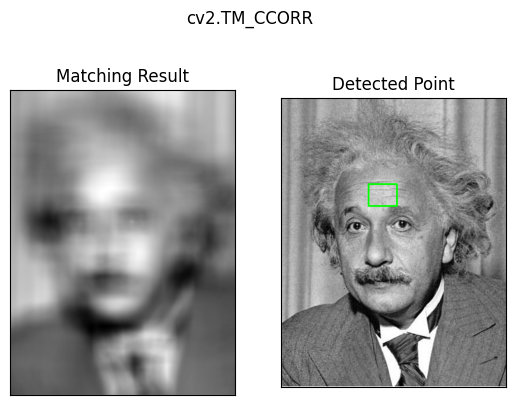

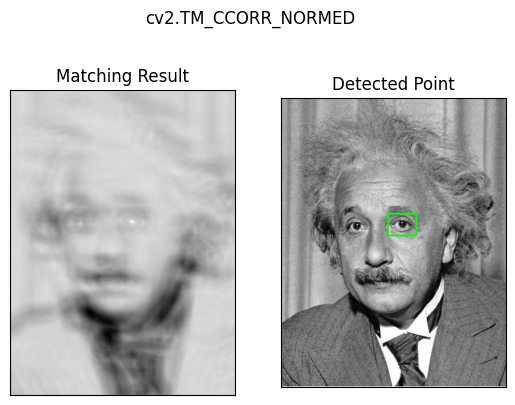

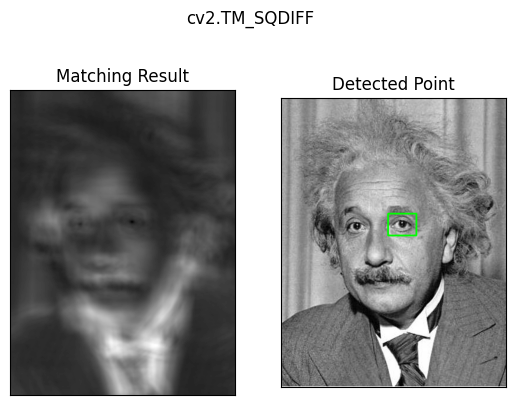

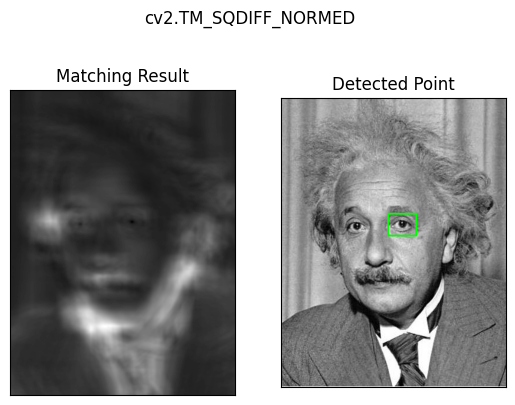

In [20]:
import cv2
import numpy as np
from matplotlib import pyplot as plt

img = cv2.imread(intro_images_path+'einstein.jpg',0)
img2 = img.copy()
template = cv2.imread(intro_images_path+'einstein_eye.jpg',0)
w, h = template.shape[::-1]

# All the 6 methods for comparison in a list
methods = ['cv2.TM_CCOEFF', 'cv2.TM_CCOEFF_NORMED', 'cv2.TM_CCORR',
            'cv2.TM_CCORR_NORMED', 'cv2.TM_SQDIFF', 'cv2.TM_SQDIFF_NORMED']

for meth in methods:
    img = img2.copy()
    method = eval(meth)

    # Apply template Matching
    res = cv2.matchTemplate(img,template,method)
    min_val, max_val, min_loc, max_loc = cv2.minMaxLoc(res)

    # If the method is TM_SQDIFF or TM_SQDIFF_NORMED, take minimum
    if method in [cv2.TM_SQDIFF, cv2.TM_SQDIFF_NORMED]:
        top_left = min_loc
    else:
        top_left = max_loc
        bottom_right = (top_left[0] + w, top_left[1] + h)

    img = cv2.cvtColor(img, cv2.COLOR_GRAY2RGB)
    cv2.rectangle(img,top_left, bottom_right, [0,255,0], 2)

    plt.subplot(121),plt.imshow(res,cmap = 'gray')
    plt.title('Matching Result'), plt.xticks([]), plt.yticks([])
    plt.subplot(122),plt.imshow(img,cmap = 'gray')
    plt.title('Detected Point'), plt.xticks([]), plt.yticks([])
    plt.suptitle(meth)
    plt.show()
    if method in [cv2.TM_CCOEFF_NORMED]:
      res=(res-min_val)/(max_val-min_val)*255
      cv2.imwrite(output_images_path+'einstein_ccoeff_normed.jpg',res)

### Image Pyramids

An image pyramid is a collection of images usually obtained by downsampling a single original image. It is a set of layers in which the higher the layer, the smaller the size.

Image pyramids are used to achieve scale-invariant processing in contexts as the following:
- template matching
- interest point detection
- object detection


http://szeliski.org/Book/


#### Gaussian pyramid

The basic steps in building a Gaussian image pyramid are:
- Gaussian smooth the image
- Reduce image dimensions by half by discarding every other row and and every other column
- Repeat this process until desired numbers levels are achieved or the image size reached a minimun


### Exercise: Comparison between pyramids with and without smoothing prior to downscaling

(491, 383)


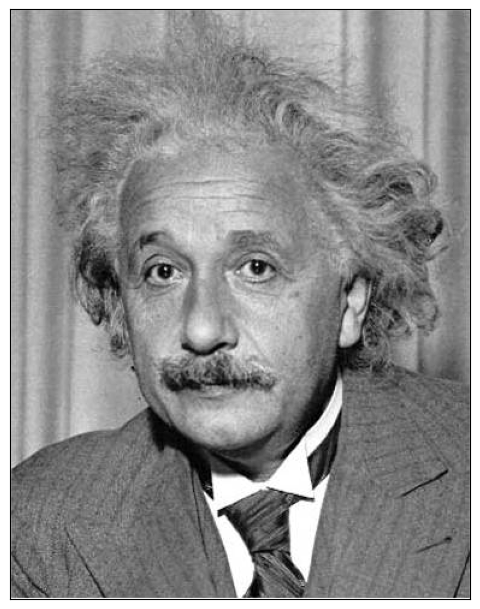

(246, 192)


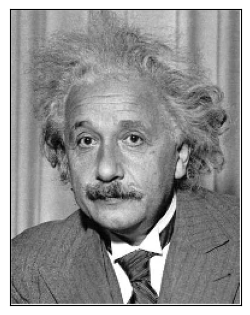

(123, 96)


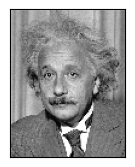

(62, 48)


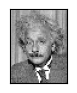

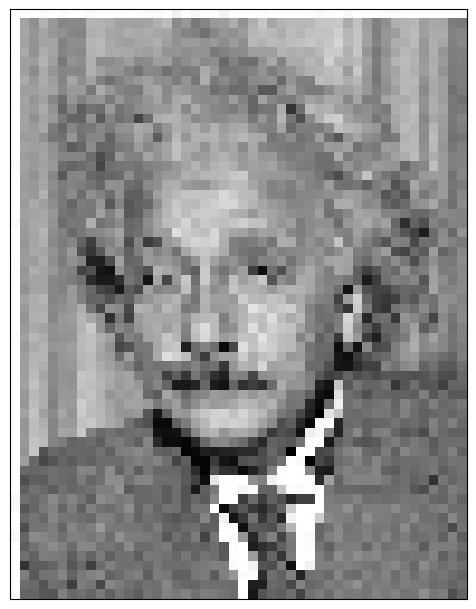

(491, 383)


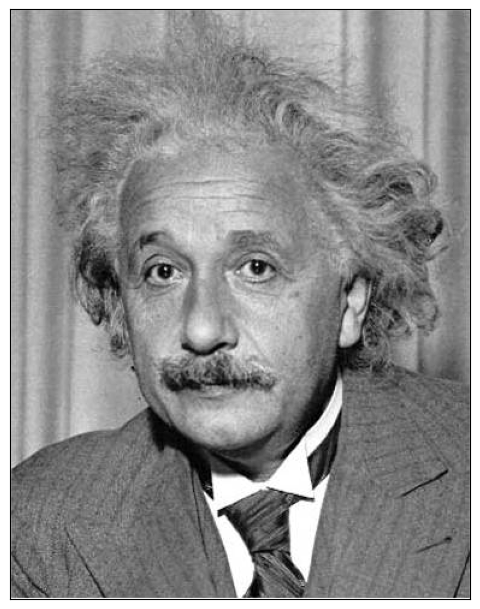

(246, 192)


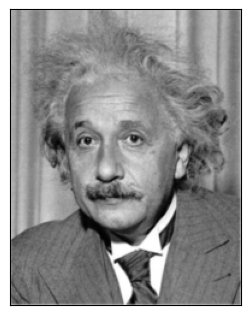

(123, 96)


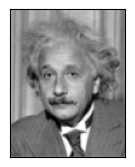

(62, 48)


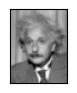

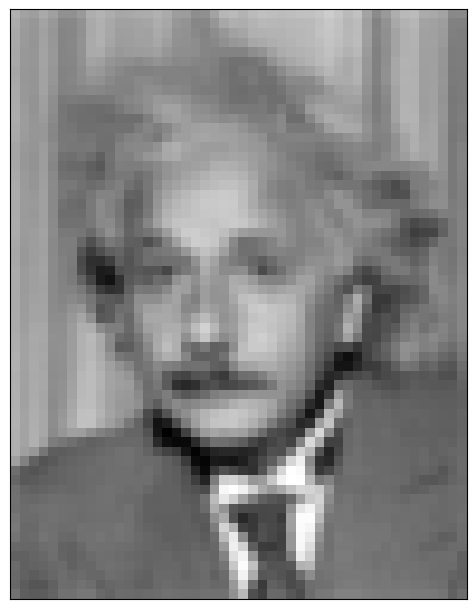

In [21]:
import numpy as np
import cv2 
import matplotlib.pyplot as plt
from skimage import data

def pyramid_bf(image,l=5, minSizex=8, minSizey=8):
# yield the original image
    level=0
    yield image
    # keep looping over the pyramid
    while True:
        if level==l or image.shape[0]<minSizex or image.shape[1]<minSizey:
            break
        h,w=image.shape[:2]
        image=image[:h+1:2,:w+1:2]
        # if the resized image does not meet the supplied minimum
        # size, then stop constructing the pyramid
        # yield the next image in the pyramid
        yield image
        level=level+1
            
            
def pyramid_sm(image,l=5, minSizex=8, minSizey=8):
    level=0
    yield image
    while True:
        if level==l or image.shape[0]<minSizex or image.shape[1]<minSizey:
            break
        image = cv2.GaussianBlur(image,(5,5),0)
        h,w=image.shape[:2]
        image=image[:h+1:2,:w+1:2]
        
        yield image
        level=level+1

image = cv2.imread(intro_images_path + 'einstein.jpg',0)#'aliasing.jpg',0)#

for layer in pyramid_bf(image,l=3):
  print(layer.shape)
  plt.figure(figsize= (0.02*layer.shape[0],0.02*layer.shape[1]))
  plt.imshow(layer,cmap='gray')
  plt.xticks([]), plt.yticks([]) 
  plt.show()

plt.figure(figsize= (0.02*image.shape[0],0.02*image.shape[1]))
plt.imshow(layer,cmap='gray')
plt.xticks([]), plt.yticks([]) 
plt.show()

for layer in pyramid_sm(image, l=3):
  print(layer.shape)
  plt.figure(figsize= (0.02*layer.shape[0],0.02*layer.shape[1]))
  plt.imshow(layer,cmap='gray')
  plt.xticks([]), plt.yticks([]) 
  plt.show()

plt.figure(figsize= (0.02*image.shape[0],0.02*image.shape[1]))
plt.imshow(layer,cmap='gray')
plt.xticks([]), plt.yticks([]) 
plt.show()


OpenCV has a specific function to downscale images: **cv2.pyrDown()**

(491, 383)


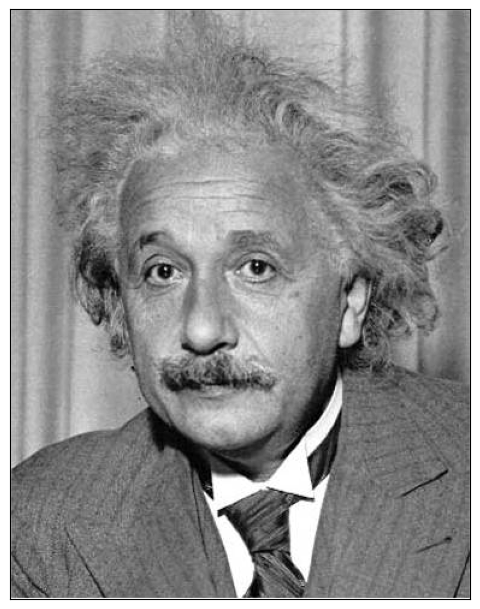

(491, 383)
(246, 192)


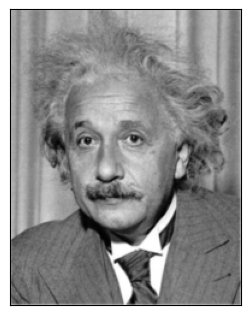

(123, 96)


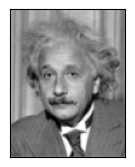

(62, 48)


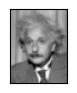

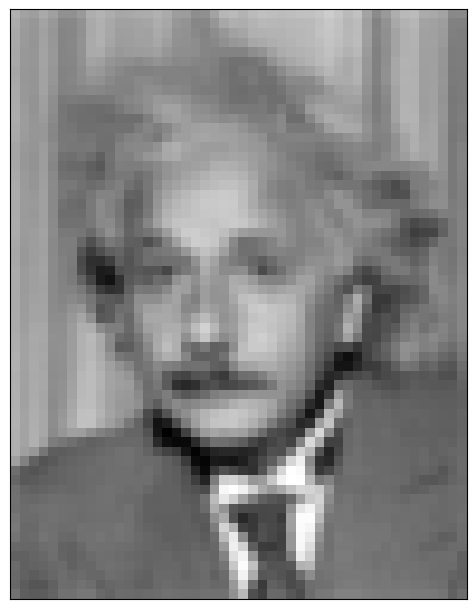

In [22]:
def pyramid(layer, l=4, minSizex=8, minSizey=8):
    level=0
    yield layer
    print(layer.shape)
    while True:
        layer = cv2.pyrDown(layer)
        if level== l or layer.shape[0]<minSizex or layer.shape[1]<minSizey:
            break
        yield layer
        level=level+1
        
for layer in pyramid(image, l=3):
  print(layer.shape)
  plt.figure(figsize= (0.02*layer.shape[0],0.02*layer.shape[1]))
  plt.imshow(layer,cmap='gray')
  plt.xticks([]), plt.yticks([]) 
  plt.show()

plt.figure(figsize= (0.02*image.shape[0],0.02*image.shape[1]))
plt.imshow(layer,cmap='gray')
plt.xticks([]), plt.yticks([]) 
plt.show()

---
---

### EXERCISE 2: Template Matching and Gaussian Pyramid

https://docs.opencv.org/3.4.2/d4/dc6/tutorial_py_template_matching.html

Template Matching is a method for searching and finding the location of a template image in a larger image. In order to cope with different sizes of the occurrence of the template we can take advantage of image pyramid.

Based on the exercises about template matching and the construction of Gaussian pyramids try to detect as much tunas as posible in the image Tuna_Relative_Sizes.jpg given the template in Tuna_template.jpg.

---
---

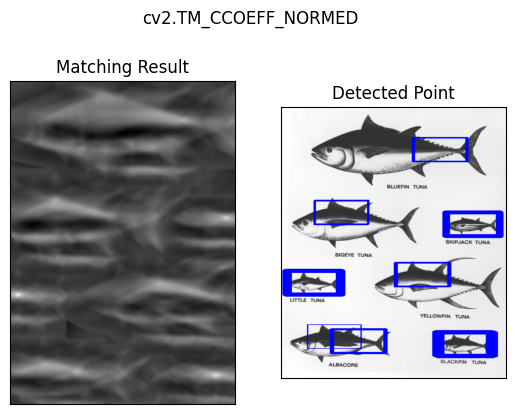

In [303]:
#SOLUTION HERE

import cv2
import numpy as np
from matplotlib import pyplot as plt

img_rgb = cv2.imread(intro_images_path+'Tuna_Relative_Sizes.jpg')
img_gray = cv2.cvtColor(img_rgb, cv2.COLOR_BGR2GRAY)
template = cv2.imread(intro_images_path+'Tuna_template.jpg',0)

w, h = template.shape[::-1]

# All the 6 methods for comparison in a list
# methods = ['cv2.TM_CCOEFF', 'cv2.TM_CCOEFF_NORMED', 'cv2.TM_CCORR',
#            'cv2.TM_CCORR_NORMED', 'cv2.TM_SQDIFF', 'cv2.TM_SQDIFF_NORMED']
methods = ['cv2.TM_CCOEFF_NORMED']

for meth in methods :
    method = eval(meth)
    
    res = cv2.matchTemplate(img_gray,template,method)
    
    threshold = 0.51
    loc = np.where( res >= threshold)
    for pt in zip(*loc[::-1]):
        cv2.rectangle(img_rgb, pt, (pt[0] + w, pt[1] + h), (0,0,255), 2)
        
    cv.rectangle(img,top_left, bottom_right, 255, 2)
    plt.subplot(121),plt.imshow(res,cmap = 'gray')
    plt.title('Matching Result'), plt.xticks([]), plt.yticks([])
    plt.subplot(122),plt.imshow(img_rgb,cmap = 'gray')
    plt.title('Detected Point'), plt.xticks([]), plt.yticks([])
    plt.suptitle(meth)
    plt.show()
    

# Explanation of the decisions made : 
# My choice for which method to use as well as the value of the threshold
# came after several tests, especially when I noticed that a higher threshold leads to
# less tunas detected, and a lower threshold leads to more False positive 
# detections.

# Discussion and results : 
# After trying with all the possible values for the final parameter of the
# cv2.matchTemplate function, it was 'cv2.TM_CCOEFF_NORMED' who had the best
# results with a threshold of 0.51, after being able to detect perfectly a 
# total of 3 tunas, and it partially detected the other 4 tunas.

---
---
## 3 Edge Detection

- Image gradients
- Noise effect and smoothing
- Derivative of Gaussian filter
- Canny edge detector
- Lapacian
- Hough transform

http://szeliski.org/Book/

---
---

### Image gradients

OpenCV provides three types of derivate (high-pass) filters: Sobel, Scharr and Laplacian.
Repeat the first exercises on this page:
https://docs.opencv.org/4.3.0/d5/d0f/tutorial_py_gradients.html
https://docs.opencv.org/3.4.2/d5/d0f/tutorial_py_gradients.html


#### First deriative filters: Sobel and Scharr

The Sobel operators combine Gaussian smoothing and differentiation, so the result is more or less resistant to noise.

**dst= cv.Sobel(src, ddepth, dx, dy, [, ksize[, scale[, delta[, borderType]]]])**

- Direction of derivatives: passing values {0,1} as arguments of dx and dy respectively. 

- Size of kernel: argument ksize. If ksize = -1, a 3x3 Scharr filter is used which gives better results than 3x3 Sobel filter.

Gradient filters can also be applied using the **cv2.Filter2D()** function. 

The following are the 3x3 kernels corresponding to  first x and y image derivatives: bare derivative without Gaussian smoothing, Sobel and Scharr.


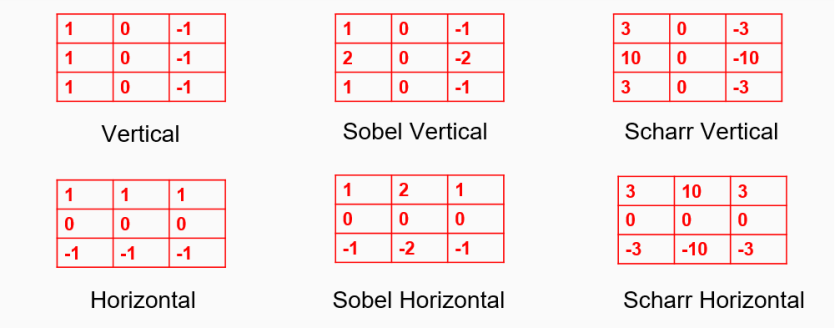

#### Second derivative filters: Laplacian

The Laplacian is the sum of the second partial derivatives. Opencv has the **cv2.laplacian()** function that implements the derivatives using the chain rule and Sobel filters.

**dst= cv2.Laplacian(src, ddepth,[ksize[, scale[, delta[, borderType]]]])**

    If ksize == 1 (default), then following kernel is used for filtering:
    K=[[0, 1, 0]
       [1,-4, 1]
       [0, 1, 1]]

Below code shows all operators in a single diagram. All kernels are 3x3. Depth of output image is passed to get the result in np.uint8 type.

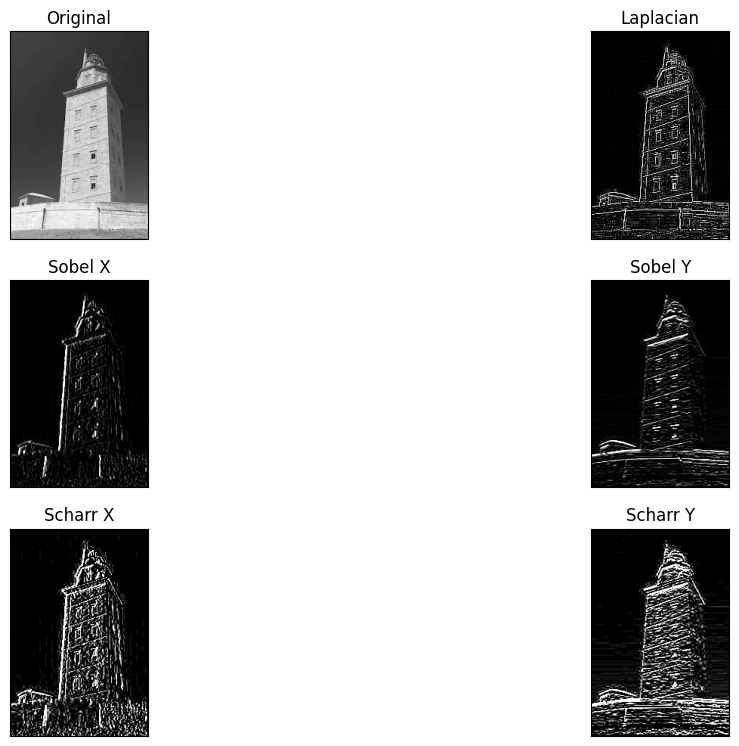

In [137]:
import cv2
import numpy as np
from matplotlib import pyplot as plt

img = cv2.imread(edge_images_path+'hercules_tower.jpg',0)
laplacian = cv2.Laplacian(img, cv2.CV_8U,ksize=3)
sobelx = cv2.Sobel(img, cv2.CV_8U,1,0,ksize=3)
sobely = cv2.Sobel(img, cv2.CV_8U,0,1,ksize=3)
scharrx = cv2.Sobel(img, cv2.CV_8U,1,0,ksize=-1)
scharry = cv2.Sobel(img, cv2.CV_8U,0,1,ksize=-1)

plt.figure(figsize=(0.05*img.shape[0],0.05*img.shape[1]))
plt.subplot(3,2,1),plt.imshow(img,cmap = 'gray')
plt.title('Original'), plt.xticks([]), plt.yticks([])
plt.subplot(3,2,2),plt.imshow(laplacian,cmap = 'gray')
plt.title('Laplacian'), plt.xticks([]), plt.yticks([])
plt.subplot(3,2,3),plt.imshow(sobelx,cmap = 'gray')
plt.title('Sobel X'), plt.xticks([]), plt.yticks([])
plt.subplot(3,2,4),plt.imshow(sobely,cmap = 'gray')
plt.title('Sobel Y'), plt.xticks([]), plt.yticks([])
plt.subplot(3,2,5),plt.imshow(scharrx,cmap = 'gray')
plt.title('Scharr X'), plt.xticks([]), plt.yticks([])
plt.subplot(3,2,6),plt.imshow(scharry,cmap = 'gray')
plt.title('Scharr Y'), plt.xticks([]), plt.yticks([])

plt.show()

**IMPORTANT!**

Output datatype can be cv2.CV_8U or np.uint8, but there is a slight problem with that. Black-to-White transition is taken as Positive slope (it has a positive value) while White-to-Black transition is taken as a Negative slope (It has negative value). So when you convert data to np.uint8, all negative slopes are made zero. In simple words, you miss that edge.
If you want to detect both edges, better option is to keep the output datatype to some higher forms, like cv2.CV_64F, take its absolute value and then convert back to cv2.CV_8U. Below code demonstrates this procedure for a horizontal Sobel filter and difference in results.

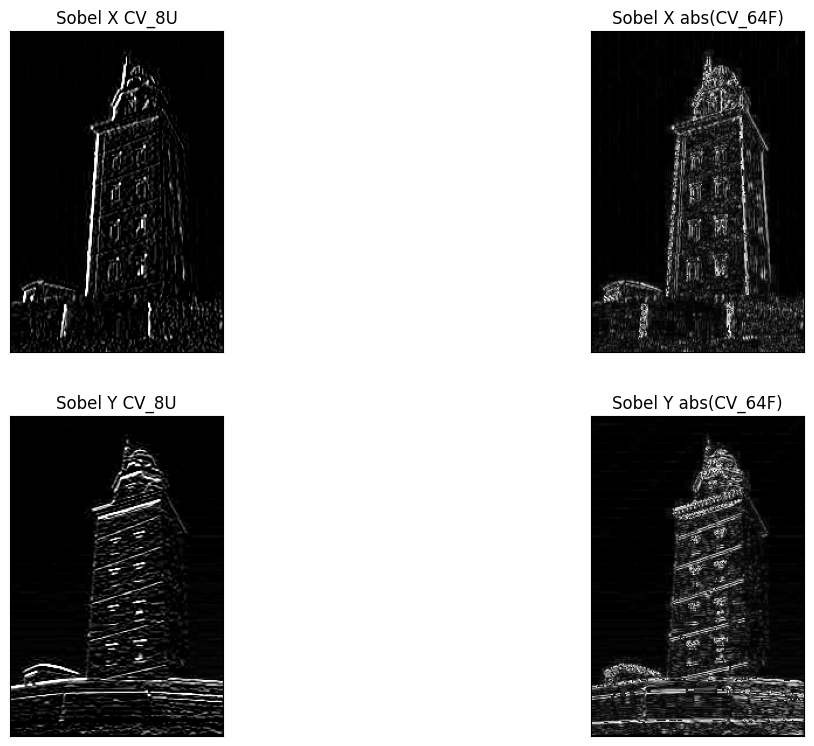

In [72]:
import cv2
import numpy as np
from matplotlib import pyplot as plt

img = cv2.imread(edge_images_path+'hercules_tower.jpg',0)
laplacian = cv2.Laplacian(img, cv2.CV_8U,ksize=3)

# Output dtype = cv2.CV_8U
sobelx8u = cv2.Sobel(img,cv2.CV_8U,1,0,ksize=3)
sobely8u = cv2.Sobel(img,cv2.CV_8U,0,1,ksize=3)

# Output dtype = cv2.CV_64F. Then take its absolute and convert to cv2.CV_8U to visualze ite
sobelx64f = cv2.Sobel(img,cv2.CV_64F,1,0,ksize=3)
sobely64f = cv2.Sobel(img,cv2.CV_64F,0,1,ksize=3)
abs_sobelx64f = np.absolute(sobelx64f)
sobelx64f_to_8u = np.uint8(abs_sobelx64f)
abs_sobely64f = np.absolute(sobely64f)
sobely64f_to_8u = np.uint8(abs_sobely64f)

plt.figure(figsize=(0.05*img.shape[0],0.05*img.shape[1]))

plt.subplot(2,2,1),plt.imshow(sobelx8u,cmap = 'gray')
plt.title('Sobel X CV_8U'), plt.xticks([]), plt.yticks([])
plt.subplot(2,2,2),plt.imshow(sobelx64f_to_8u,cmap = 'gray')
plt.title('Sobel X abs(CV_64F)'), plt.xticks([]), plt.yticks([])

plt.subplot(2,2,3),plt.imshow(sobely8u,cmap = 'gray')
plt.title('Sobel Y CV_8U'), plt.xticks([]), plt.yticks([])
plt.subplot(2,2,4),plt.imshow(sobely64f_to_8u,cmap = 'gray')
plt.title('Sobel Y abs(CV_64F)'), plt.xticks([]), plt.yticks([])

plt.show()

### Exercise: Canny edge detector

https://docs.opencv.org/4.3.0/da/d22/tutorial_py_canny.html
https://docs.opencv.org/3.4.2/da/d22/tutorial_py_canny.html

Canny algorithm was designed to meet the criteria of  good detection,  good location and single response. It uses multiple stages, as shown  below. OpenCV implements it as the function  cv2.Canny().

**edges = cv2.Canny(image, threshold1, threshold2[,edges [,apertureSize[, L2gradient]]])**
    
- First argument is the input image. 
- Second and third arguments are the thresholds. 
  The former (lowest) is used for edge linking. 
  While threshold2 (highest) is used to find initial segments of strong edges. 
- Argument apertureSize is the size of Sobel kernel used for computing image gradients. By default it is 3. 
- Last argument is L2gradient which specifies the equation for measuring gradient magnitude. If it is True, L2 norm is used, which is usually more accurate. By default, it is False and L1 norm is used

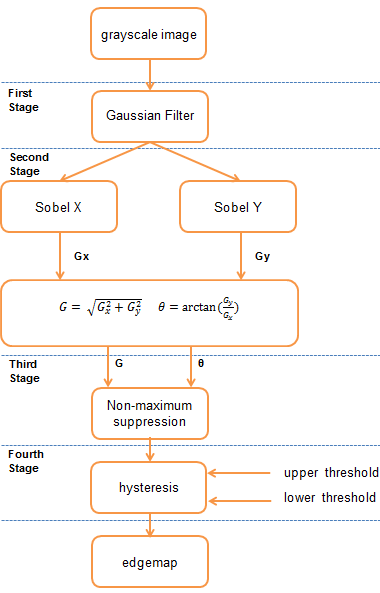

You can find a detailed implementation of the Canny detector here: https://towardsdatascience.com/canny-edge-detection-step-by-step-in-python-computer-vision-b49c3a2d8123

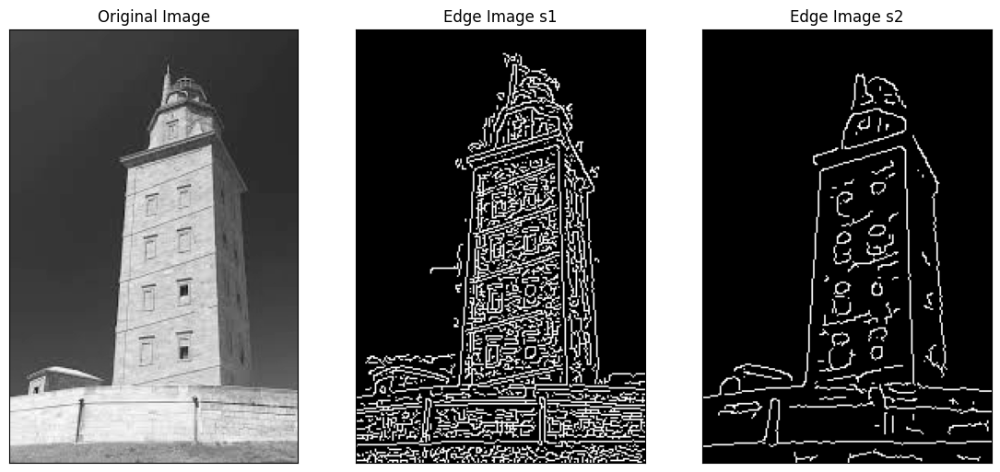

In [74]:
import cv2
import numpy as np
from matplotlib import pyplot as plt

image = cv2.imread(edge_images_path+'hercules_tower.jpg',0)

img=cv2.GaussianBlur(image,(3,3),0) #some previous smothing is usually convenient
edges = cv2.Canny(img,5,15,apertureSize=3,L2gradient=True)

plt.figure(figsize=(0.05*img.shape[0],0.05*img.shape[1]))

plt.subplot(131),plt.imshow(image,cmap = 'gray')
plt.title('Original Image'), plt.xticks([]), plt.yticks([])

plt.subplot(132),plt.imshow(edges,cmap = 'gray')
plt.title('Edge Image s1'), plt.xticks([]), plt.yticks([])


img=cv2.GaussianBlur(image,(15,15),0) #some previous smothing is usually convenient
edges = cv2.Canny(img,5,15,apertureSize=3,L2gradient=True)

plt.subplot(133),plt.imshow(edges,cmap = 'gray')
plt.title('Edge Image s2'), plt.xticks([]), plt.yticks([])
plt.show()

---
---
### EXERCISE 3: Edge Detection

1. Select the best values for threshold1, threshold2, and gaussian blurring, for each of the following images: chuvia.jpg, xardin.jpg, paseo.jpg.

* kernel size and sigma are dependent values. Commonly, Gaussian distribution has 99.7% of its probability mass within $3*sigma$, so the size of the kernel should be $k\_size = 6.0*sqrt(2)*sigma$. Anyway $kº_size = 6*sigma$, or even shorter, is usually enough.
        
* Specific implementation in OpenCV estimate the value of sigma (if 0 is passed) given the value of kernel size, but not the other way around. You can find the relationship between these two parameters (according to opencv) here: https://docs.opencv.org/2.4/modules/imgproc/doc/filtering.html#getgaussiankernel


2. Try with some authomatic simple methods as: (1) computing the median gray-level values and determine high and low thresholds as simmetric values around the median; (2) setting thresholds based on the maximum of the gradient; (3) ....; work well depending on the image context.

---
---

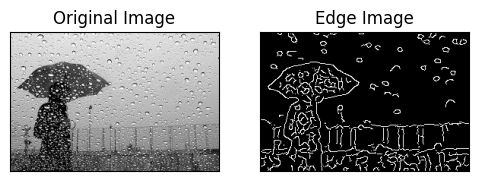

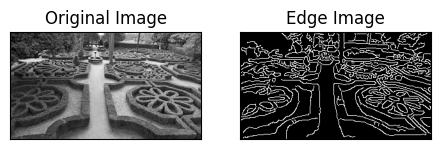

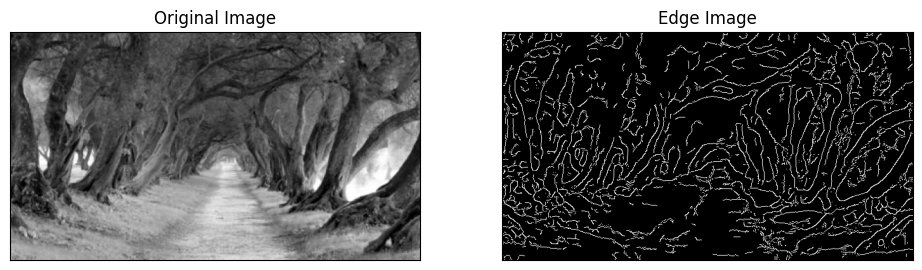

In [286]:
#SOLUTION HERE
import cv2
import numpy as np
from matplotlib import pyplot as plt

image = cv2.imread(edge_images_path+'chuvia.jpg',0)

img=cv2.GaussianBlur(image,(15,15),0)
edges = cv2.Canny(img,10,20,apertureSize=3,L2gradient=True)

plt.figure(figsize=(0.05*img.shape[0],0.05*img.shape[1]))
plt.subplot(131),plt.imshow(image,cmap = 'gray')
plt.title('Original Image'), plt.xticks([]), plt.yticks([])
plt.subplot(132),plt.imshow(edges,cmap = 'gray')
plt.title('Edge Image'), plt.xticks([]), plt.yticks([])

plt.show()

image = cv2.imread(edge_images_path+'xardin.jpg',0)

img=cv2.GaussianBlur(image,(7,7),0)
edges = cv2.Canny(img,1,100,apertureSize=3,L2gradient=True)

plt.figure(figsize=(0.05*img.shape[0],0.05*img.shape[1]))
plt.subplot(131),plt.imshow(image,cmap = 'gray')
plt.title('Original Image'), plt.xticks([]), plt.yticks([])
plt.subplot(132),plt.imshow(edges,cmap = 'gray')
plt.title('Edge Image'), plt.xticks([]), plt.yticks([])

plt.show()

image = cv2.imread(edge_images_path+'paseo.jpg',0)

img=cv2.GaussianBlur(image,(21,21),0)
edges = cv2.Canny(img,15,20,apertureSize=3,L2gradient=True)

plt.figure(figsize=(0.05*img.shape[0],0.05*img.shape[1]))
plt.subplot(131),plt.imshow(image,cmap = 'gray')
plt.title('Original Image'), plt.xticks([]), plt.yticks([])
plt.subplot(132),plt.imshow(edges,cmap = 'gray')
plt.title('Edge Image'), plt.xticks([]), plt.yticks([])

plt.show()

# Explanation of the decisions made : 
# The first parameter I changed was gaussian blurring. Depending
# on each image, I needed a certain value for the kernel so the 
# maximum amount of noise could be removed and the image could
# be smoothed. Both thresholds helped me to further remove all
# the details that I didn't really want to keep, so the edge
# map could be more clean.

# Discussion and results : 
# The results are pretty much good. We can clearly see that,
# for each image, we were able to retrieve the geometrical 
# forms in it, while conserving a certain degree of clearniness.
# Just as a reminder again, we consider that the big water 
# droplets are not noise but rather an essential part of the 
# first image ! (Otherwise we could easily tweak more the 
# algorithm to remove them as well)


---
---

### EXERCISE 4: Intensity and Edge Matching

Compare the following two template matching alternatives  regarding their  performance : (i) case of using image intensity as features for matching, and  (ii) case of using their edge maps as matching features. Use faces.jpg and two different templates right_eye.jpg and right_eye_i.jpg. You  will have to compute their edge maps before computing the correlation in case (ii).

---
---

846


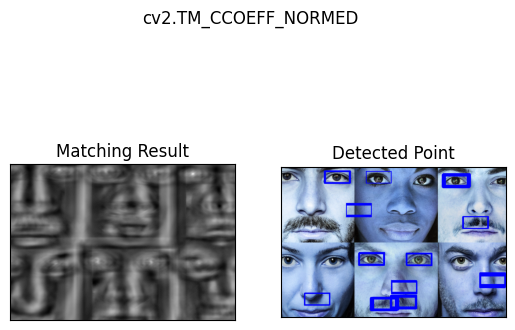

In [302]:
#SOLUTION HERE

import cv2
import numpy as np
from matplotlib import pyplot as plt

img_rgb = cv2.imread(edge_images_path+'faces.jpg')
img_gray = cv2.cvtColor(img_rgb, cv2.COLOR_BGR2GRAY)
template = cv2.imread(edge_images_path+'right_eye.jpg',0)

w, h = template.shape[::-1]

methods = ['cv2.TM_CCOEFF_NORMED']

for meth in methods :
    method = eval(meth)
    
    res = cv2.matchTemplate(img_gray,template,method)
    
    threshold = 0.5
    loc = np.where( res >= threshold)
    for pt in zip(*loc[::-1]):
        cv2.rectangle(img_rgb, pt, (pt[0] + w, pt[1] + h), (0,0,255), 2)
        
    cv.rectangle(img,top_left, bottom_right, 255, 2)
    plt.subplot(121),plt.imshow(res,cmap = 'gray')
    plt.title('Matching Result'), plt.xticks([]), plt.yticks([])
    plt.subplot(122),plt.imshow(img_rgb,cmap = 'gray')
    plt.title('Detected Point'), plt.xticks([]), plt.yticks([])
    plt.suptitle(meth)
    print(len(loc[0]))
    plt.show()

    ###


### Exercise Hough Tranform

https://docs.opencv.org/3.4.2/d6/d10/tutorial_py_houghlines.html

A line in image space can be expressed with two parameters:
- In the Cartesian coordinate system:  (m,b).
- In the Polar coordinate system: (r,θ)

For Hough Transforms, we will express lines in the Polar system. Hence, a line equation can be written as   r=xcosθ+ysinθ. In general for each point (x0,y0), we can define the family of lines that goes through that point as  r=x0cosθ+y0sinθ. Meaning that each pair (r,θ) represents each line that passes by (x0,y0).

Hough Transform is encapsulated in the OpenCV function cv2.HoughLines().

**lines=cv.HoughLines(edges, rho, theta, threshold [, srn[, stn[, min_theta[,max_theta]]]]])**
    
- It simply returns an array of (r,θ) values; r is measured in pixels and θ  is measured in radians. 
- First parameter, edges image should be a binary image, so apply threshold or use canny edge detection before applying Hough transform. 
- Second and third parameters are rho and theta accuracies, respectively. 
- Fourth argument is the threshold, which means minimum votes it should get for it to be considered as a line. Remember, number of votes depend upon number of points detected on the line.

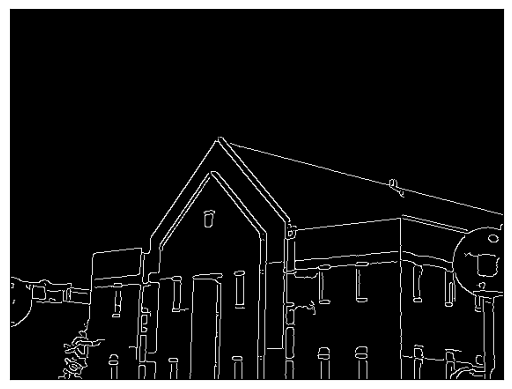

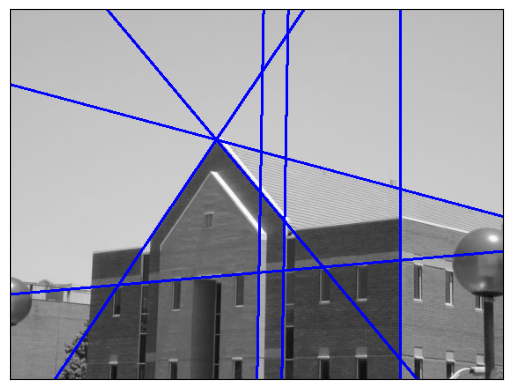

In [119]:
import cv2
import numpy as np
import math
from matplotlib import pyplot as plt

img = cv2.imread(edge_images_path+'building.jpg')
gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
gray=img
imgP=img.copy()

gray = cv2.GaussianBlur(img,(7,7),0)
edges = cv2.Canny(gray,1,50,apertureSize=3,L2gradient=True)
lines = cv2.HoughLines(edges,1,np.pi/180,120)

#Draw all the lines
if lines is not None:
  for i in range(0,len(lines)):
      rho = lines[i][0][0]
      theta = lines[i][0][1]
      a = np.cos(theta)
      b = np.sin(theta)
      x0 = a * rho
      y0 = b * rho
      pt1 = (int(x0 + 1000*(-b)), int(y0 + 1000*(a)))
      pt2 = (int(x0 - 1000*(-b)), int(y0 - 1000*(a)))
      cv2.line(imgP, pt1, pt2, (0,0,255), 2)

plt.imshow(edges,cmap='gray'), plt.xticks([]), plt.yticks([])
plt.show()
plt.imshow(imgP,cmap='gray'), plt.xticks([]), plt.yticks([])
plt.show()

A more efficient implementation of the Hough Line Transform is the function **HoughLinesP()**. It returns the extremes of detected lines (x0,y0,x1,y1). This function has two extra parameters:

    MinLineLength - Minimum line length. Line segments shorter than it are rejected.
    MaxLineGap - Maximum allowed gap between points on the same line to link them.

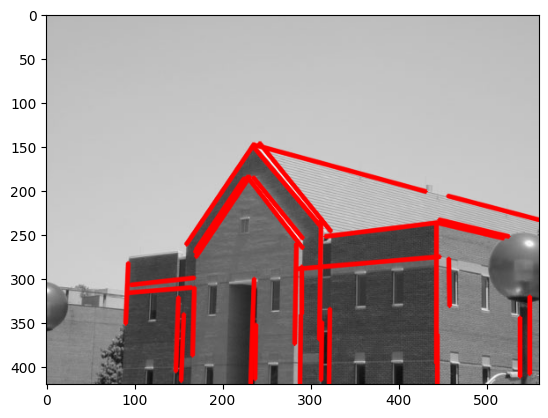

In [77]:
linesP = cv2.HoughLinesP(edges,1,np.pi/180,50,minLineLength=50,maxLineGap=10)

imgP=img.copy()

if linesP is not None:
   for i in range(0, len(linesP)):
      l = linesP[i][0]
      cv2.line(imgP, (l[0], l[1]), (l[2], l[3]), (255,0,0), 3, cv2.LINE_AA)


plt.imshow(imgP)
plt.show()

---
---

### EXERCISE 5: Hough Transform Lines

Consider the image naval.jpg. Try to detect lines with the best trade-off between the numbers of True Positive and False Negative. Consider different levels of smoothing before applying the Canny detector.

---
---


Number of lines : 46 lines


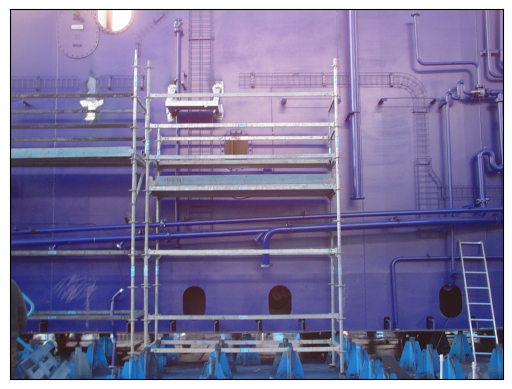

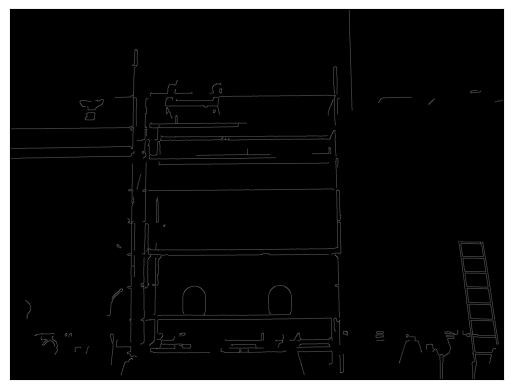

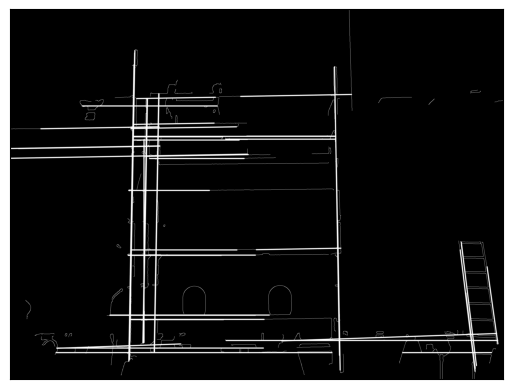

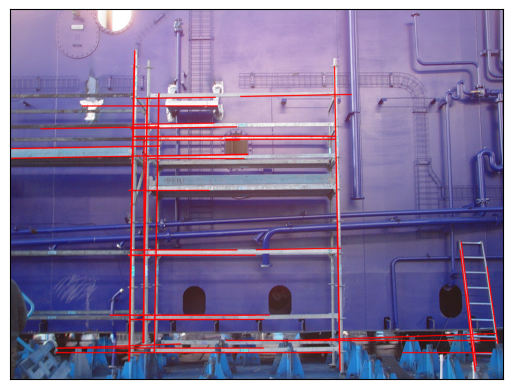

In [154]:
#SOLUTION HERE

### Version 1 : Using improved Hough Tranform cv2.HoughLinesP()

import cv2
import numpy as np
import math
from matplotlib import pyplot as plt

img = cv2.imread(edge_images_path+'naval.jpg')
gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
gray=img
imgP=img.copy()

gray = cv2.GaussianBlur(img,(15,15),0)
edges = cv2.Canny(gray,45,130,apertureSize=3,L2gradient=True)
edgesP = edges.copy()
linesP = cv2.HoughLinesP(edges,1,np.pi/180,150,minLineLength=350,maxLineGap=250)

if linesP is not None:
   for i in range(0, len(linesP)):
      l = linesP[i][0]
      cv2.line(imgP, (l[0], l[1]), (l[2], l[3]), (255,0,0), 3, cv2.LINE_AA)
      cv2.line(edgesP, (l[0], l[1]), (l[2], l[3]), (255,0,0), 3, cv2.LINE_AA)

print("Number of lines : {} lines".format(len(linesP)))

plt.imshow(img,cmap='gray'), plt.xticks([]), plt.yticks([])
plt.show()
plt.imshow(edges,cmap='gray'), plt.xticks([]), plt.yticks([])
plt.show()
plt.imshow(edgesP,cmap='gray'), plt.xticks([]), plt.yticks([])
plt.show()
plt.imshow(imgP,cmap='gray'), plt.xticks([]), plt.yticks([])
plt.show()

# Explanation of the decisions made : 
# Given that I wanted to do a comparison between the basic and the improved
# Hough Transform functions, I decided to start with the improved version 
# to get the whole lines drawn. I had to do some parameter tuning to try 
# and find the best combination possible.

# Discussion and results : 
# Multiple tests and permutations later, I settled on the values that appear
# in the script above, especially given that they are the ones who provided me 
# with the best ratio between true positives and false negatives. I was able 
# to retrieve a total of 46 lines, with crisp lines and good coverage of the
# main parts of the image.

Number of lines : 31 lines


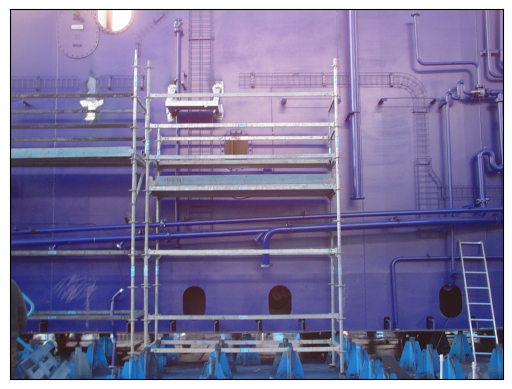

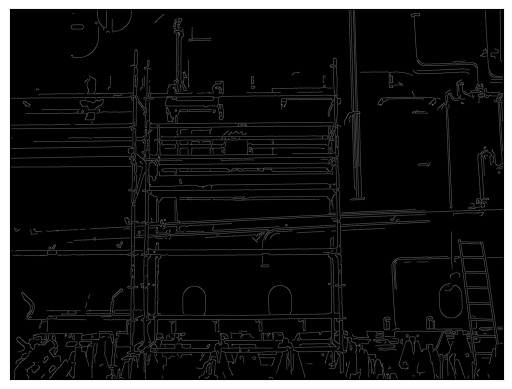

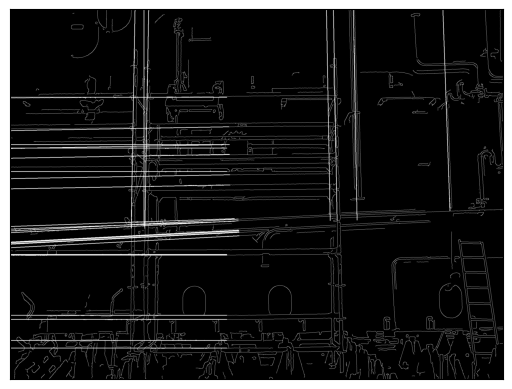

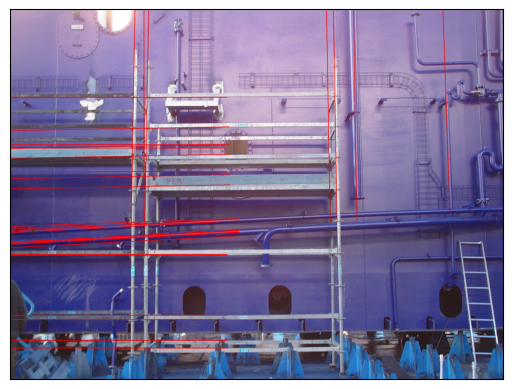

In [153]:
#SOLUTION HERE

### Version 2 : Using basic Hough Tranform cv2.HoughLines()

import cv2
import numpy as np
import math
from matplotlib import pyplot as plt

img = cv2.imread(edge_images_path+'naval.jpg')
gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
gray=img
imgP=img.copy()

gray = cv2.GaussianBlur(img,(17,17),0)
edges = cv2.Canny(gray,1,50,apertureSize=3,L2gradient=True)
edgesP = edges.copy()
lines = cv2.HoughLines(edges,1,np.pi/180,280)

if lines is not None:
  for i in range(0,len(lines)):
      rho = lines[i][0][0]
      theta = lines[i][0][1]
      a = np.cos(theta)
      b = np.sin(theta)
      x0 = a * rho
      y0 = b * rho
      pt1 = (int(x0 + 1000*(-b)), int(y0 + 1000*(a)))
      pt2 = (int(x0 - 1000*(-b)), int(y0 - 1000*(a)))
      cv2.line(imgP, pt1, pt2, (255,0,0), 2)
      cv2.line(edgesP, pt1, pt2, (255,0,0), 2)

print("Number of lines : {} lines".format(len(lines)))
plt.imshow(img,cmap='gray'), plt.xticks([]), plt.yticks([])
plt.show()
plt.imshow(edges,cmap='gray'), plt.xticks([]), plt.yticks([])
plt.show()
plt.imshow(edgesP,cmap='gray'), plt.xticks([]), plt.yticks([])
plt.show()
plt.imshow(imgP,cmap='gray'), plt.xticks([]), plt.yticks([])
plt.show()

# Explanation of the decisions made : 
# For this second version, I wanted to check the results if I only use the 
# basic Hough Transforme cv2.HoughLines(). I spent some time tuning the 
# parameters, as dealing with multiple parameters at the same time is not 
# evident.

# Discussion and results : 
# For the parameters, I settled on the values that are in the script above.
# I was able to retrieve a total of 31 lines, while only lacking some lines
# on the bottom right part of the image.

### Exercise: Hough Transform applied to circles

https://docs.opencv.org/4.x/da/d53/tutorial_py_houghcircles.html

A circle is represented mathematically by its center *(xcenter,ycenter)* and its radius *r*. As it has 3 parameters, we need a 3D accumulator for hough transform. OpenCV offers the function **cv2.HoughCircles()**.

**circles= cv2.HoughCircles(image, method, dp, minDist[, param1[, param2[, minRadius[, maxRadius]]]])**
        
- **image**	8-bit, single-channel, grayscale input image.
- **circles**	Output vector of found circles. Each vector is encoded as 3 or 4 element floating-point vector (x,y,radius) or (x,y,radius,votes) .
- **dp** Inverse ratio of the accumulator resolution to the image resolution: if dp=1 the accumulator has the same resolution as the input image; if dp=2 the accumulator has half as big width and height. 
- **minDist**	Minimum distance between the centers of the detected circles.
- **param1** Higher threshold of the two passed to the Canny edge detector (the lower one is twice smaller). 
- **param2** Accumulator threshold for the circle centers at the detection stage. 
- **minRadius**	Minimum circle radius.
- **maxRadius**	Maximum circle radius. 

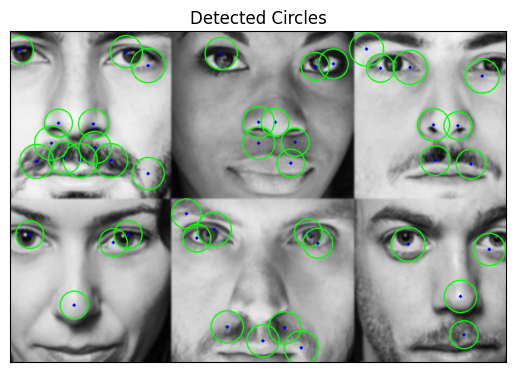

In [155]:
import numpy as np
import cv2 
from matplotlib import pyplot as plt

img = cv2.imread(edge_images_path+'faces.jpg',0)
img = cv2.GaussianBlur(img,(9,9),2)

cimg = cv2.cvtColor(img,cv2.COLOR_GRAY2BGR)


circles = cv2.HoughCircles(img,cv2.HOUGH_GRADIENT,dp=2,minDist=30, param1=40,param2=40,minRadius=30,maxRadius=40)
circles = np.uint16(np.around(circles))

for i in circles[0,:]:
    # draw the outer circle
    cv2.circle(cimg,(i[0],i[1]),i[2],(0,255,0),2)
    # draw the center of the circle
    cv2.circle(cimg,(i[0],i[1]),2,(0,0,255),3)

plt.imshow(cimg)
plt.title('Detected Circles'), plt.xticks([]), plt.yticks([])
plt.show()

---
---
### EXERCISE 6: Hough Transform Circles

Implement a program for the estimation of the number of fishes in fishes.jpg image, according to the number of detected eyes. Choose the most convenient parameters.

---
---

Approximate number of fishes is : 11


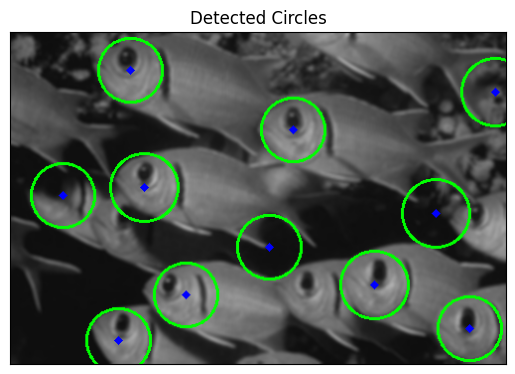

In [160]:
#SOLUTION HERE

import numpy as np
import cv2 
from matplotlib import pyplot as plt

img = cv2.imread(feature_images_path+'fishes.jpg',0)
img = cv2.GaussianBlur(img,(5,5),2)

cimg = cv2.cvtColor(img,cv2.COLOR_GRAY2BGR)


circles = cv2.HoughCircles(img,cv2.HOUGH_GRADIENT,dp=2,minDist=40, param1=50,param2=36,minRadius=30,maxRadius=35)

circles = np.uint16(np.around(circles))

for i in circles[0,:]:
    # draw the outer circle
    cv2.circle(cimg,(i[0],i[1]),i[2],(0,255,0),2)
    # draw the center of the circle
    cv2.circle(cimg,(i[0],i[1]),2,(0,0,255),3)
    
print('Approximate number of fishes is : {}'.format(len(circles[0,:])))
plt.imshow(cimg)
plt.title('Detected Circles'), plt.xticks([]), plt.yticks([])
plt.show()

# Explanation of the decisions made : 
# Tuning this algorithme was easier than the last examples, as I mainly focused
# on two parameters : The higher threshold of the two passed to the Canny edge 
# detector, and the accumulator threshold for the circle centers at the detection 
# stage. The basic 40-40 configuration had an acceptable result with a total of
# 8 fishes detected. But I felt I could do better by further tunning the function.

# Discussion and results : 
# After multiple tests, my script is  able to detect perfectly 7 eyes of the 
# fishes, while approximating the other fishes who are less evident to detect,
# thus being able to detect a total of 11 fishes. A solid performance overall.

---
---

## 3 Image segmentation 

- Histogram based segmentation 
- Region growing 
- Clustering based segmentation 
- K-means 
- MeanShift

---
---

### Image Thresholding

https://docs.opencv.org/4.3.0/d7/d4d/tutorial_py_thresholding.html

In simple thresholding, if pixel value is greater than a threshold value, it is assigned a given  value (may be white), else it is assigned a different value (may be black). The function to apply  a threshold in OpenCV is cv2.threshold. 

**retval, dst=cv2.threshold(src, thresh, maxval, type)**

- src - source image, which must be grayscale. 
- thresh - is the threshold.
- maxval - is the value to be given to pixels with intensity values greater than or equal to the threshold. 
- type - OpenCV provides different types of thresholding: cv2.THRESH_BINARY, cv2.THRESH_BINARY_INV, cv2.THRESH_TRUNC, cv2.THRESH_TOZERO, cv2.THRESH_TOZERO_INV

- retvaL, dst - used threshold and thresholded image, respectively

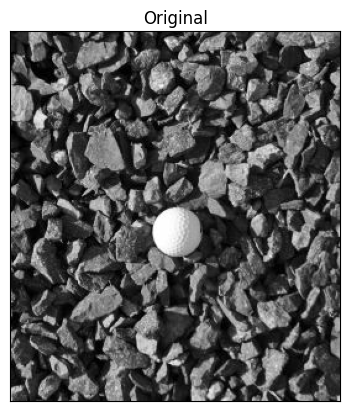

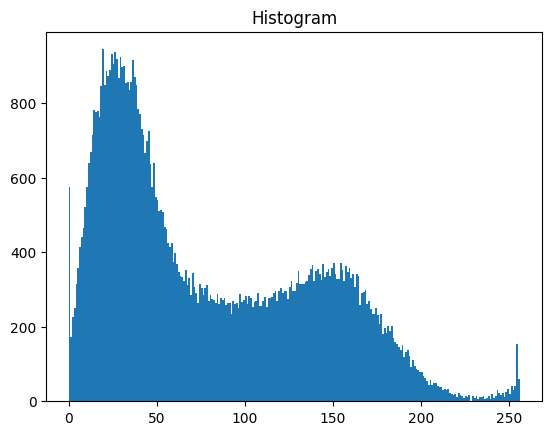

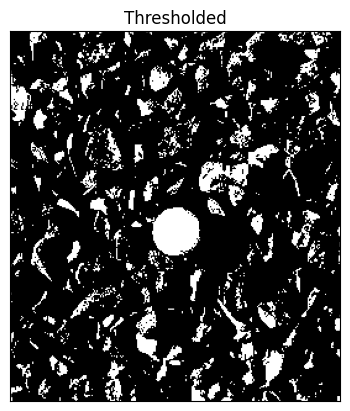

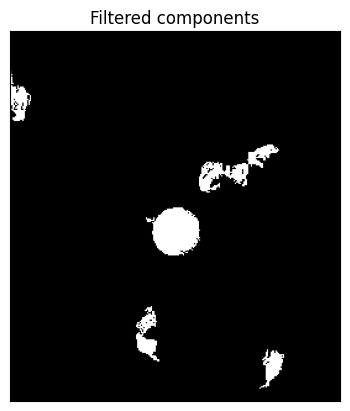

In [320]:
import cv2 
import numpy as np 
from matplotlib import pyplot as plt 

img = cv2.imread(seg_images_path+'black-trap-rock.jpg',0) 

plt.title('Original'), plt.xticks([]), plt.yticks([])
plt.imshow(img,cmap = 'gray')
plt.show()

plt.title('Histogram')
plt.hist(img.ravel(),256,[0,256]); #plt.show()

ret,thresh = cv2.threshold(img,150,255,cv2.THRESH_BINARY)
plt.show()
plt.title('Thresholded'), plt.xticks([]), plt.yticks([])
plt.imshow(thresh,cmap = 'gray')
plt.show()

# Apply the Component analysis function
analysis = cv2.connectedComponentsWithStats(thresh,4, cv2.CV_32S)
(totalLabels, label_ids, values, centroid) = analysis
  
# Initialize a new image to store 
# all the output components
output = np.zeros(img.shape, dtype="uint8")
  
# Loop through each component
for i in range(1, totalLabels):
    
      # Area of the component
    area = values[i, cv2.CC_STAT_AREA] 
      
    if (area > 250):
        componentMask = (label_ids == i).astype("uint8") * 255
        output = cv2.bitwise_or(output, componentMask)
  
plt.imshow(output, cmap='gray')
plt.title('Filtered components')
plt.xticks([]),plt.yticks([])
plt.show() 

#plt.figure(figsize=(0.05*img.shape[0],0.05*img.shape[1]))
#plt.subplot(132)
#plt.title('Dilated'), plt.xticks([]), plt.yticks([])

#kernel = np.ones((5,5),np.uint8) 
#dilate = cv2.dilate(thresh,kernel,iterations = 1)
#plt.imshow(dilate,cmap = 'gray')

#plt.subplot(133)
#plt.title('Closed'), plt.xticks([]), plt.yticks([])
#kernel = np.ones((5,5),np.uint8) 
#closing = cv2.erode(dilate,kernel,iterations = 1)
#plt.imshow(closing,cmap = 'gray')

#plt.show()

#### Adaptive Thresholding

A global threshold value may not be good if the input image corresponds to an scene with varying lighting conditions. In that case, adaptive thresholding is preferable.

**dst=cv2.adaptiveThreshold(src,maxval,adaptiveMethod, thresholdType, blockSize, C)**  

- adaptiveMethod - It decides how thresholding value is calculated.

        cv2.ADAPTIVE_THRESH_MEAN_C: threshold value is the mean of neighbourhood area minus the constant C.
        cv2.ADAPTIVE_THRESH_GAUSSIAN_C: threshold is the gaussian mean of neighbourhood values minus C. 
        
- thresholdType - must be either THRESH_BINARY or THRESH_BINARY_INV
- blockSize - size of neighbourhood area.
- C - a constant which is subtracted from the mean or weighted average calculated.

Below piece of code compares global thresholding and adaptive thresholding for an image with varying illumination:

threshold: 100.0


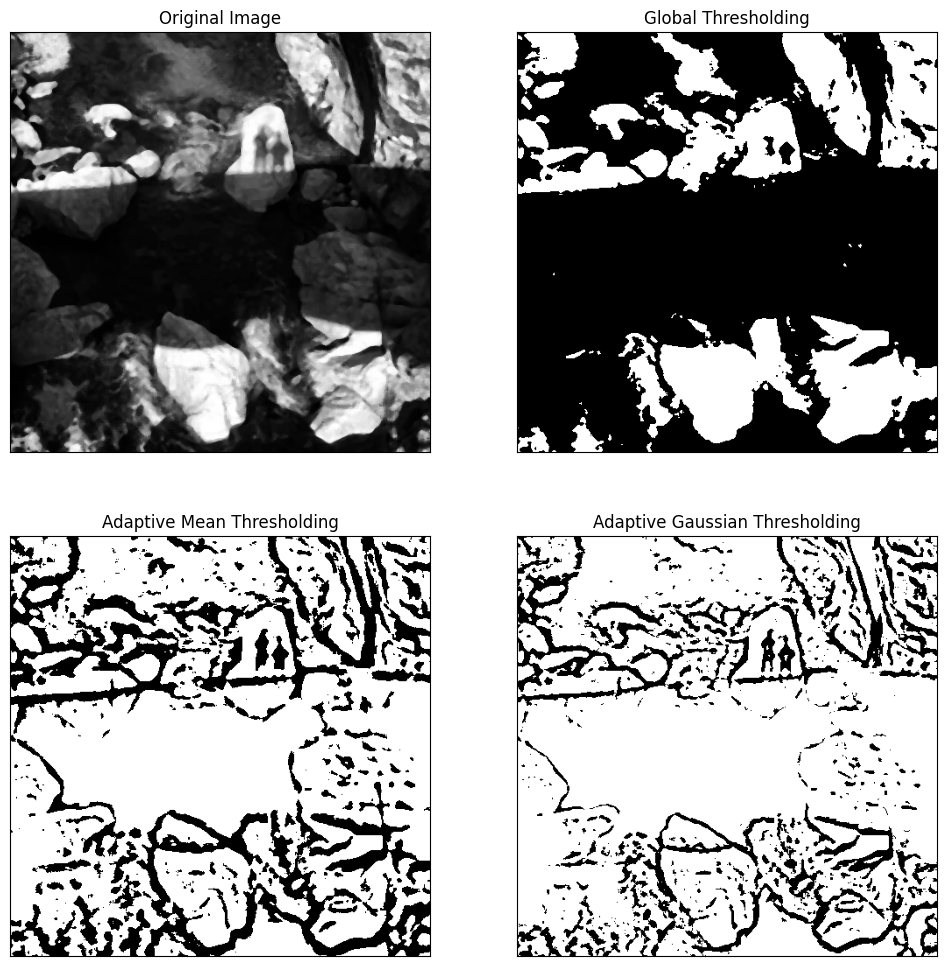

In [321]:
import cv2
import numpy as np
from matplotlib import pyplot as plt

img = cv2.imread(seg_images_path+'rochas.jpg',0)
img = cv2.medianBlur(img,5)

C=10
blockSize=25

ret,th1 = cv2.threshold(img,100,255,cv2.THRESH_BINARY)
th2 = cv2.adaptiveThreshold(img,255,cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY,blockSize,C)
th3 = cv2.adaptiveThreshold(img,255,cv2.ADAPTIVE_THRESH_GAUSSIAN_C,cv2.THRESH_BINARY,blockSize,C)

print("threshold: {}".format(ret))

titles = ['Original Image', 'Global Thresholding',
            'Adaptive Mean Thresholding', 'Adaptive Gaussian Thresholding']
images = [img, th1, th2, th3]


plt.figure(figsize=(0.025*img.shape[0],0.025*img.shape[1]))
for i in range(4):
    plt.subplot(2,2,i+1),plt.imshow(images[i],'gray')
    plt.title(titles[i])
    plt.xticks([]),plt.yticks([])
plt.show()


### Exercise: Consider the image penumbra.jpg. Try to find the best  parameters for enhancing the relevant details.

threshold: 100.0


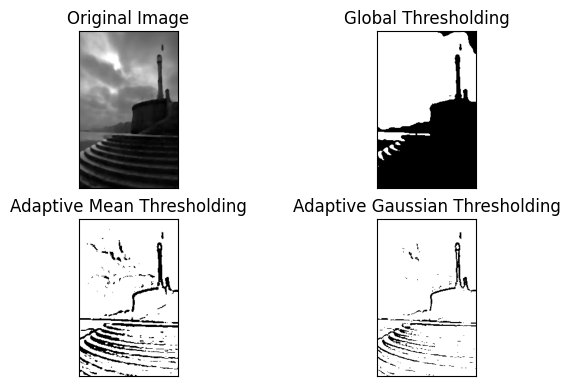

In [161]:
#CODE HERE

import cv2
import numpy as np
from matplotlib import pyplot as plt

img = cv2.imread(seg_images_path+'penumbra.jpg',0)
img = cv2.medianBlur(img,5)

C=7
blockSize=9

ret,th1 = cv2.threshold(img,100,255,cv2.THRESH_BINARY)
th2 = cv2.adaptiveThreshold(img,255,cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY,blockSize,C)
th3 = cv2.adaptiveThreshold(img,255,cv2.ADAPTIVE_THRESH_GAUSSIAN_C,cv2.THRESH_BINARY,blockSize,C)

print("threshold: {}".format(ret))

titles = ['Original Image', 'Global Thresholding',
            'Adaptive Mean Thresholding', 'Adaptive Gaussian Thresholding']
images = [img, th1, th2, th3]


plt.figure(figsize=(0.025*img.shape[0],0.025*img.shape[1]))
for i in range(4):
    plt.subplot(2,2,i+1),plt.imshow(images[i],'gray')
    plt.title(titles[i])
    plt.xticks([]),plt.yticks([])
plt.show()

# Explanation of the decisions made : 
# No major test were done for this use case. Both functions used are quite 
# simple to use and straightforward. All the big work is done implicetely.

# Discussion and results : 
# As we can see, there's still some parts of the sky detected when using the 
# Adaptive Mean Thresholding, less while using the Adaptive Gaussian
# Thresholding. Overall, this second technique gives the best result for this
# specific image (it depends on the context in general).


#### Otsu’s Binarization

In global thresholding, we used an arbitrary value for threshold value, but, how can we know a value we selected is good or not? Answer is trial and error method. But now consider a bimodal image (an image whose histogram has two peaks). For that image, Otsu’s binarization automatically calculates a threshold  in the valley of bimodal histograms. (For images which are not bimodal, binarization will not be accurate.)

**cv2.threshold()** function can be used with an extra flag, **cv2.THRESH_OTSU**, and threshold value equals to zero. Then the algorithm finds the optimal threshold value that is returned as retVal. If Otsu thresholding is not used, retVal is same as the passed threshold value.

Check out below example. Input image is a noisy image. In first case, a global thresholding for a value of 127 is applied. In second case, it is applied Otsu’s thresholding directly.  In third case, the image is filtered with a 5x5 gaussian kernel to remove the noise, then an Otsu thresholding is applied.

ret1: 127.0
ret2: 148.0
ret3: 148.0


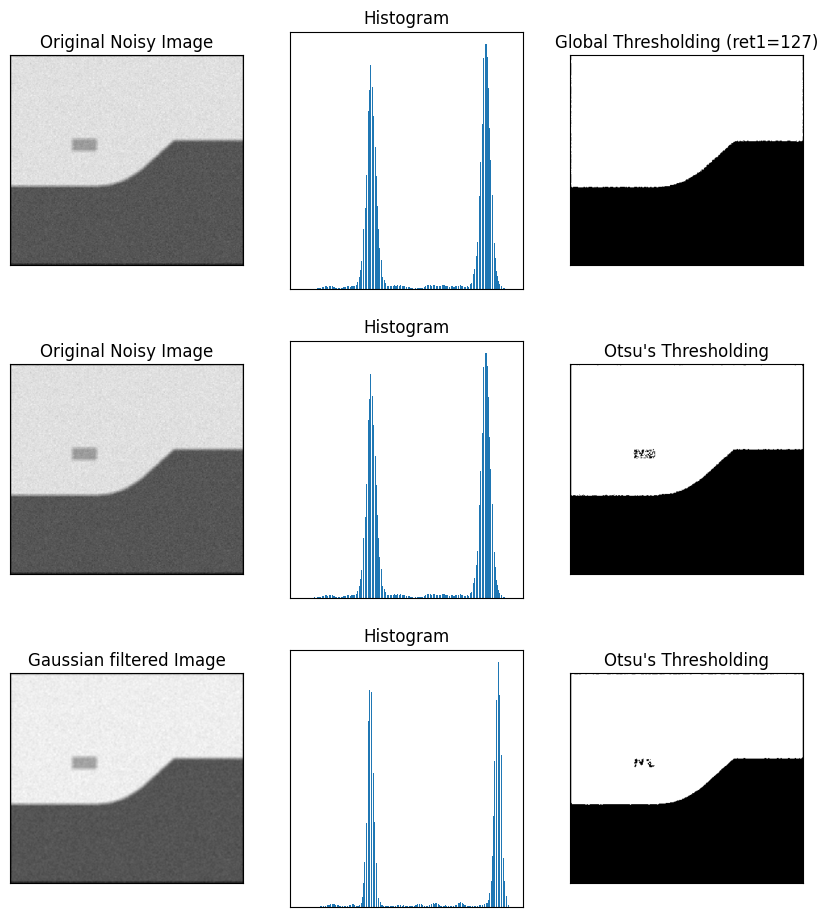

In [162]:
import cv2
import numpy as np
from matplotlib import pyplot as plt

img = cv2.imread(seg_images_path+ 'noisy.png',0)

# global thresholding
ret1,th1 = cv2.threshold(img,127,255,cv2.THRESH_BINARY)
# Otsu's thresholding
ret2,th2 = cv2.threshold(img,0,255,cv2.THRESH_BINARY+cv2.THRESH_OTSU)
# Otsu's thresholding after Gaussian filtering
blur = cv2.GaussianBlur(img,(3,3),0)
ret3,th3 = cv2.threshold(blur,0,255,cv2.THRESH_BINARY+cv2.THRESH_OTSU)

print('ret1: {}'.format(ret1))
print('ret2: {}'.format(ret2))
print('ret3: {}'.format(ret3))

# plot all the images and their histograms
images = [img, 0, th1,
          img, 0, th2,
          blur, 0, th3]
titles = ['Original Noisy Image','Histogram','Global Thresholding (ret1=127)',
          'Original Noisy Image','Histogram',"Otsu's Thresholding",
          'Gaussian filtered Image','Histogram',"Otsu's Thresholding"]

plt.figure(figsize=(0.03*img.shape[0],0.03*img.shape[1]))
for i in range(3):
    plt.subplot(3,3,i*3+1),plt.imshow(images[i*3],'gray')
    plt.title(titles[i*3]), plt.xticks([]), plt.yticks([])
    plt.subplot(3,3,i*3+2),plt.hist(images[i*3].ravel(),256)
    plt.title(titles[i*3+1]), plt.xticks([]), plt.yticks([])
    plt.subplot(3,3,i*3+3),plt.imshow(images[i*3+2],'gray')
    plt.title(titles[i*3+2]), plt.xticks([]), plt.yticks([])
plt.show()

### Exercise: Consider the image  nature_night.jpg. Find the best  threshold to segment the foreground objects.

ret1: 127.0
ret2: 56.0
ret3: 51.0


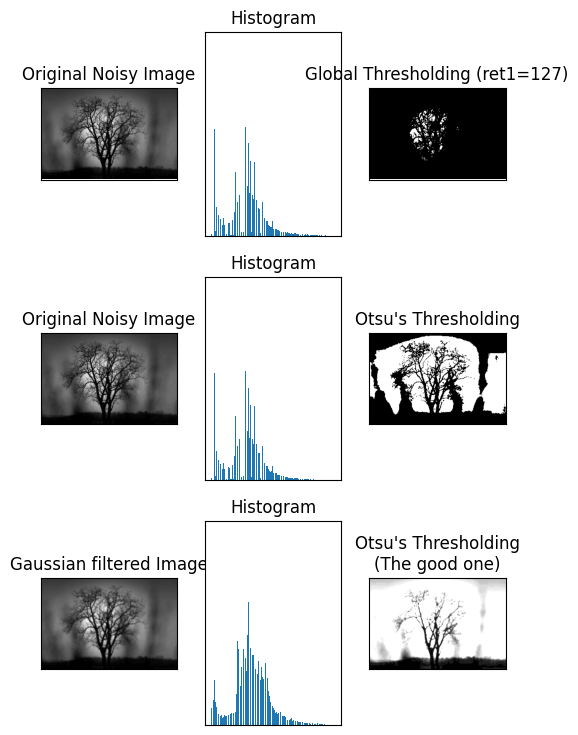

In [165]:
# CODE HERE

import cv2
import numpy as np
from matplotlib import pyplot as plt

img = cv2.imread(seg_images_path+ 'nature_night.jpg',0)

# global thresholding
ret1,th1 = cv2.threshold(img,127,255,cv2.THRESH_BINARY)

# Otsu's thresholding
ret2,th2 = cv2.threshold(img,0,255,cv2.THRESH_BINARY+cv2.THRESH_OTSU)

# cv2.THRESH_BINARY, cv2.THRESH_BINARY_INV, cv2.THRESH_TRUNC, 
# cv2.THRESH_TOZERO, cv2.THRESH_TOZERO_INV 

# Otsu's thresholding after Gaussian filtering
blur = cv2.GaussianBlur(img,(3,3),0)
ret3,th3 = cv2.threshold(blur,0,255, cv2.THRESH_TRUNC+cv2.THRESH_OTSU)

print('ret1: {}'.format(ret1))
print('ret2: {}'.format(ret2))
print('ret3: {}'.format(ret3))

# plot all the images and their histograms
images = [img, 0, th1,
          img, 0, th2,
          blur, 0, th3]
titles = ['Original Noisy Image','Histogram','Global Thresholding (ret1=127)',
          'Original Noisy Image','Histogram',"Otsu's Thresholding",
          'Gaussian filtered Image','Histogram',"Otsu's Thresholding\n(The good one)"]

plt.figure(figsize=(0.03*img.shape[0],0.03*img.shape[1]))
for i in range(3):
    plt.subplot(3,3,i*3+1),plt.imshow(images[i*3],'gray')
    plt.title(titles[i*3]), plt.xticks([]), plt.yticks([])
    plt.subplot(3,3,i*3+2),plt.hist(images[i*3].ravel(),256)
    plt.title(titles[i*3+1]), plt.xticks([]), plt.yticks([])
    plt.subplot(3,3,i*3+3),plt.imshow(images[i*3+2],'gray')
    plt.title(titles[i*3+2]), plt.xticks([]), plt.yticks([])
plt.show()

# Explanation of the decisions made : 
# Basicly, I only had three parameters to test : Size of the kernel 
# for the Gaussian filtering, usage or not of "cv2.THRESH_OTSU", 
# and which one of the other flags would be more convenient.
# The script gives the output of three main configurations (while 
# not chosing the inversed flags).

# Discussion and results : 
# As we can see in the three resulting images, the best configuration
# is with the flags "cv2.THRESH_TRUNC+cv2.THRESH_OTSU", as it helps
# to keep only the main object (the tree) in the foreground, and 
# eliminate most of the surrounding effects in the background.
# A good result on this specific image.

### Exercise Morphological Transformations
https://docs.opencv.org/4.3.0/d9/d61/tutorial_py_morphological_ops.html
Morphological transformations are simple operations that change the shapes of binary regions. They need two inputs: (1) the original image, and (2) the structuring element or kernel which decides the nature of the operation. Four basic morphological operators are erosion, dilation, opening and closing,.

#### Erosion

The basic idea of erosion is just like soil erosion, it erodes away the boundaries of foreground object. The kernel slides through the image (as in 2D convolution). A pixel in the original image (either 1 or 0) will be considered 1 only if all the pixels under the kernel is 1, otherwise it is eroded (set to zero).
All the pixels near boundary will be discarded depending upon the size of the kernel. So the thickness or size of each foreground object (white regions) decreases in the image. It is useful for removing small white noise regions, detaching two connected objects etc.
Here an example where a 5x5 kernel (matrix of ones) is used:

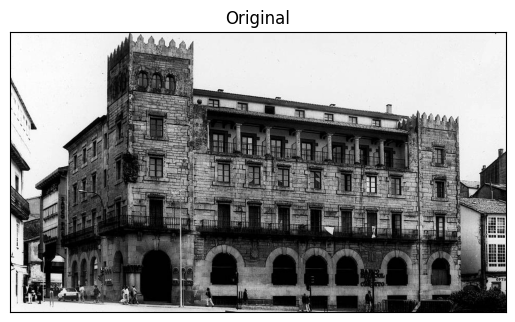

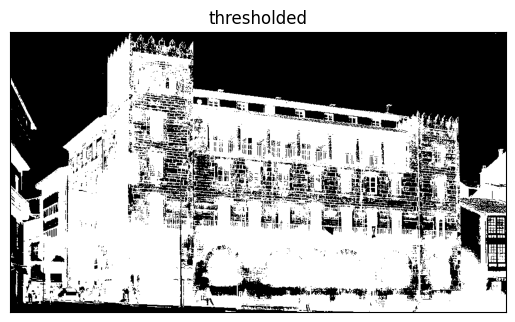

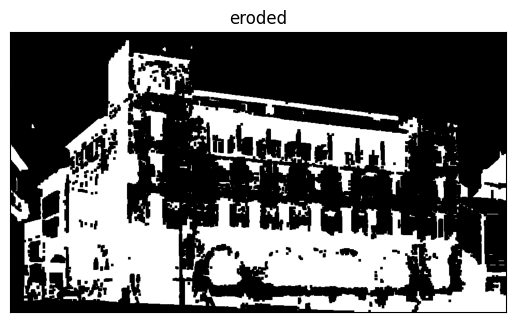

In [166]:
import cv2
import numpy as np

img = cv2.imread(seg_images_path+'hotel.jpg',0)

plt.imshow(img,'gray')
plt.title('Original')
plt.xticks([]),plt.yticks([])
plt.show()

ret1,thr = cv2.threshold(img,127,255,cv2.THRESH_BINARY_INV)

plt.imshow(thr,'gray')
plt.title('thresholded')
plt.xticks([]),plt.yticks([])
plt.show()
kernel = np.ones((5,5),np.uint8)
eroded = cv2.erode(thr,kernel,iterations = 1)

plt.imshow(eroded,'gray')
plt.title('eroded')
plt.xticks([]),plt.yticks([])
plt.show()

#### Dilation

It is just opposite of erosion. Here, a pixel element is ‘1’ if at least one pixel under the kernel is ‘1’. So it increases the size of aeach white region (foreground object) in the image. Normally, in cases like noise removal, erosion is followed by dilation. While erosion removes white noise regions, it also shrinks our object, so we dilate it.  It is also useful in joining broken parts of an object.

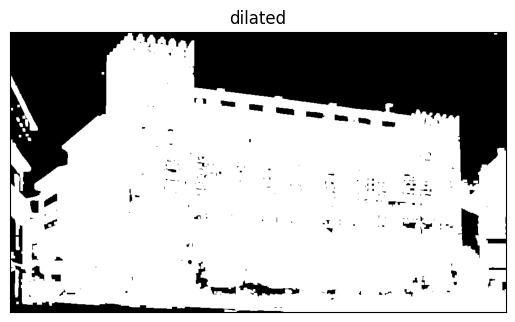

In [167]:
dilated = cv2.dilate(thr,kernel,iterations = 1)
plt.imshow(dilated,'gray')
plt.title('dilated')
plt.xticks([]),plt.yticks([])
plt.show()

#### Opening

Opening is the name for erosion followed by dilation. It is useful in removing noise, as we explained above. Here we use the function, **cv2.morphologyEx()**

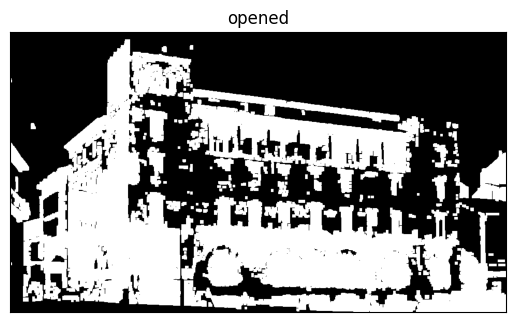

In [168]:
opened = cv2.morphologyEx(thr, cv2.MORPH_OPEN, kernel)
plt.imshow(opened,'gray')
plt.title('opened')
plt.xticks([]),plt.yticks([])
plt.show()

#### Closing

Closing is reverse of Opening: Dilation followed by Erosion. It is useful in closing small holes inside the foreground objects, or small black points on the object.

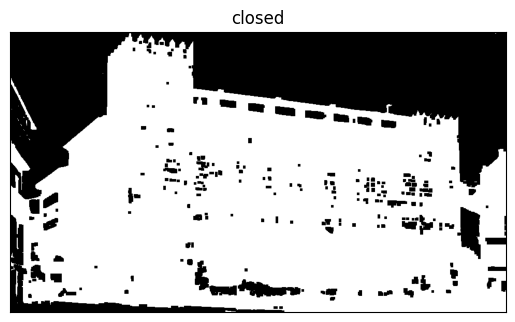

In [169]:
closed = cv2.morphologyEx(thr, cv2.MORPH_CLOSE, kernel)
plt.imshow(closed,'gray')
plt.title('closed')
plt.xticks([]),plt.yticks([])
plt.show()

#### Structuring Element

We manually created a rectangular structuring elements in the previous examples with help of Numpy. But in some cases, you may need elliptical/circular shaped kernels. So for this purpose, OpenCV has a function, **cv2.getStructuringElement()**. You just pass the shape and size of the kernel, and you get the desired kernel.

In [170]:
# Rectangular Kernel
cv2.getStructuringElement(cv2.MORPH_RECT,(5,5))
#array([[1, 1, 1, 1, 1],
#            [1, 1, 1, 1, 1],
#            [1, 1, 1, 1, 1],
#            [1, 1, 1, 1, 1],
#            [1, 1, 1, 1, 1]], dtype=uint8)

# Elliptical Kernel
cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(5,5))
#array([[0, 0, 1, 0, 0],
#            [1, 1, 1, 1, 1],
#            [1, 1, 1, 1, 1],
#            [1, 1, 1, 1, 1],
#            [0, 0, 1, 0, 0]], dtype=uint8)

# Cross-shaped Kernel
cv2.getStructuringElement(cv2.MORPH_CROSS,(5,5))
#array([[0, 0, 1, 0, 0],
#            [0, 0, 1, 0, 0],
#            [1, 1, 1, 1, 1],
#            [0, 0, 1, 0, 0],
#            [0, 0, 1, 0, 0]], dtype=uint8)

array([[0, 0, 1, 0, 0],
       [0, 0, 1, 0, 0],
       [1, 1, 1, 1, 1],
       [0, 0, 1, 0, 0],
       [0, 0, 1, 0, 0]], dtype=uint8)

---
---
### EXERCISE 7:  Thresholding Based Segmentation

Consider the image hotel.jpg, find the best parameters, for thresholding and morphological operations, to obtain a mask of the hotel as accurate as possible.

---
---

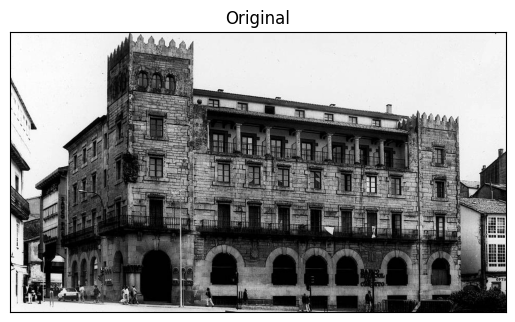

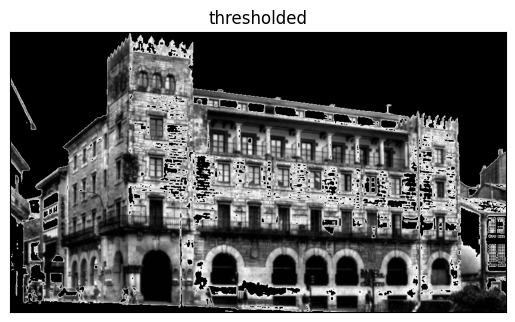

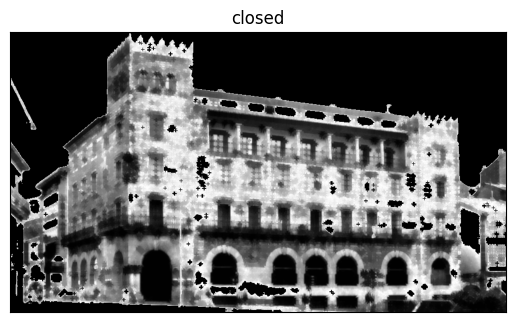

In [215]:
#SOLUTION HERE

import cv2
import numpy as np

img = cv2.imread(seg_images_path+'hotel.jpg',0)

plt.imshow(img,'gray')
plt.title('Original')
plt.xticks([]),plt.yticks([])
plt.show()

blur = cv2.GaussianBlur(img,(5,5),0)

# cv2.THRESH_BINARY, cv2.THRESH_BINARY_INV, cv2.THRESH_TRUNC,
# cv2.THRESH_TOZERO, cv2.THRESH_TOZERO_INV
ret1,thr = cv2.threshold(blur,0,255, cv2.THRESH_TOZERO_INV+cv2.THRESH_OTSU)

plt.imshow(thr,'gray')
plt.title('thresholded')
plt.xticks([]),plt.yticks([])
plt.show()

kernel = cv2.getStructuringElement(cv2.MORPH_CROSS,(7,7))

opened = cv2.morphologyEx(thr, cv2.MORPH_CLOSE, kernel)
plt.imshow(opened,'gray')
plt.title('closed')
plt.xticks([]),plt.yticks([])
plt.show()

# Explanation of the decisions made : 
# Multiple parameters to be tuned : Dimensions for the gaussian blur, flags
# for the threshold and the morphological transformation to be used.
# The parameter tuning task was quite exhausting, and several combinations
# were tested.

# Discussion and results : 
# In ordre to minimise the differences between the hotel in the original 
# image and in the mask, I settled on the values mentionned in the above 
# script. In particular, I got better results using the Cross-Shaped kernel 
# than using the other forms of kernels. The resulting mask is convenient 
# for the original hotel, although with some more tuning, and luck, I feel
# like I couldv' gotten a better output. 

### K-Means Clustering
https://docs.opencv.org/3.4.2/d1/d5c/tutorial_py_kmeans_opencv.html

K-Means clustering is unsupervised machine learning algorithm that aims to partition N observations into K clusters in which each observation belongs to the cluster with the nearest mean. A cluster refers to a collection of data points aggregated together because of certain similarities. For image segmentation, clusters here are different image colors.

**cv2.kmeans()** is the function in OpenCV for data clustering:

**compactness, bestLabels, centers = cv2.kmeans(samples, K, bestLabels, criteria, attempts, flags)**

- samples - it should be of np.float32 data type, and each feature should be put in a single column.
- K - number of clusters required at end.
- criteria - iteration termination criteria. When any of these criteria is satisfied, algorithm iteration stops. It should be a tuple of 3 parameters (type, max_iter, epsilon):
    - type of termination criteria. It has 3 flags as below:
            - cv2.TERM_CRITERIA_EPS - stop if specified accuracy, epsilon, is reached.
            - cv2.TERM_CRITERIA_MAX_ITER - stop after the specified number of iterations, max_iter.
            - cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER - stop when any of the above condition is met.
    - max_iter - An integer specifying maximum number of iterations.
    - epsilon - Required accuracy

- attempts - umber of times the algorithm is executed using different initial labellings. The algorithm returns the labels that yield the best compactness. This compactness is returned as output.
- flags - specify how initial centers are taken. Normally two flags are used for this: cv2.KMEANS_PP_CENTERS and cv2.KMEANS_RANDOM_CENTERS. With cv2.KMEANS_PP_CENTERS flag enabled, the method first iterates the whole image to determine the probable centers and then starts to converge.
- compactnes - sum of squared distances from points to their corresponding centers.
- bestLabels - Input/output integer array that stores the cluster indices for every sample.
- centers -  array of cluster centers.

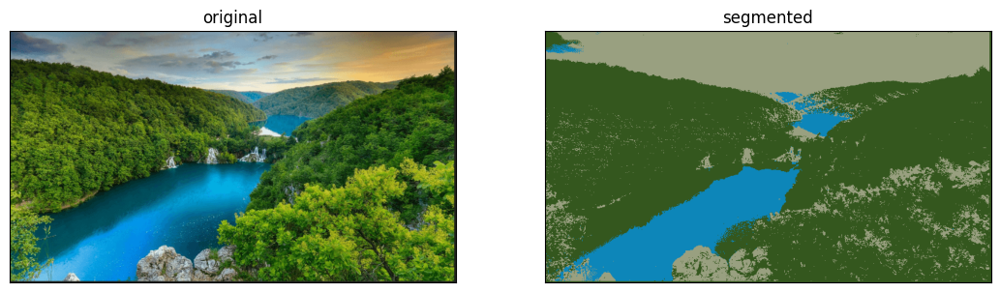

In [216]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

image = cv2.imread(seg_images_path+"landscape.png")
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB) # convert to RGB
# reshape the image to a 1D array of pixels and 3 color values (RGB)

pixel_values = image.reshape((-1, 3))  #-1 represents image size
pixel_values = np.float32(pixel_values)# convert to float

# define stopping criteria
criteria = (cv2.TERM_CRITERIA_EPS+cv2.TERM_CRITERIA_MAX_ITER,100,0.2)
k = 3 # number of clusters (K)
_, labels, (centers) = cv2.kmeans(pixel_values,3,None,criteria,10, cv2.KMEANS_RANDOM_CENTERS)

centers = np.uint8(centers)# convert back to 8 bit values
segmented_image = centers[labels.flatten()] # convert all pixels to the color of the centroids

# reshape back to the original image dimension
segmented_image = segmented_image.reshape(image.shape)

plt.figure(figsize=(0.03*image.shape[0],0.03*image.shape[1]))
plt.subplot(121)
plt.imshow(image)
plt.title('original')
plt.xticks([]),plt.yticks([])

plt.subplot(122)
plt.imshow(segmented_image)
plt.title('segmented')
plt.xticks([]),plt.yticks([])
plt.show()

### Mean-Shift Clustering
https://scikit-learn.org/stable/modules/generated/sklearn.cluster.MeanShift.html

Mean shift clustering aims to discover by itself the number and location of blobs of local maxima of hte probability distribution function. It is a centroid-based algorithm, which works by updating candidates for centroids to be the mean of the points within a given region. These candidates are then filtered in a post-processing stage to eliminate near-duplicates to form the final set of centroids.

**class sklearn.cluster.MeanShift(*, bandwidth=None, seeds=None, bin_seeding=False, min_bin_freq=1, cluster_all=True, n_jobs=None, max_iter=300)**

- bandwidth - float, default=None, estimated using *sklearn.cluster.estimate_bandwidth()*.

- seeds - array-like of shape (n_samples, n_features), default=None. If None, the seeds are calculated by *sklearn.cluster.get_bin_seeds()* with bandwidth as the grid size and default values for other parameters.

- bin_seeding bool, default=False. If true, initial kernel locations are not locations of all points, but rather the location of the discretized version of points, where points are binned onto a grid whose coarseness corresponds to the bandwidth. Setting this option to True will speed up the algorithm because fewer seeds will be initialized. Ignored if seeds argument is not None.

- min_bin_freq - int, default=1. To speed up the algorithm, accept only those bins with at least *min_bin_freq* points as seeds.

- cluster_all - bool, default=True. If true, then all points are clustered, even those orphans that are not within any kernel. Orphans are assigned to the nearest kernel. If false, then orphans are given cluster label -1.

- n_jobs - int, default=None. The number of jobs to use for the computation of the n_init runs in parallel.

- max_iter - int, default=300, maximum number of iterations, per seed point before the clustering operation terminates, if has not converged yet.

**sklearn.cluster.estimate_bandwidth(X, *, quantile=0.3, n_samples=None, random_state=0, n_jobs=None)**

Estimate the bandwidth, takes time at least quadratic in n_samples. For large datasets, it’s wise to set that parameter to a small value.

- X - array-like of shape (n_samples, n_features) of input points.

- quantile - float, default=0.3. Should be between [0, 1], 0.5 means that the median of all pairwise distances is used.

- n_samples -int, default=None, number of samples to use. If not given, all samples are used.

- random_state - int, RandomState instance, default=None. The generator used to randomly select the samples from input points for bandwidth estimation. 

- n_jobs - int, default=None, number of parallel jobs to run for neighbors search.

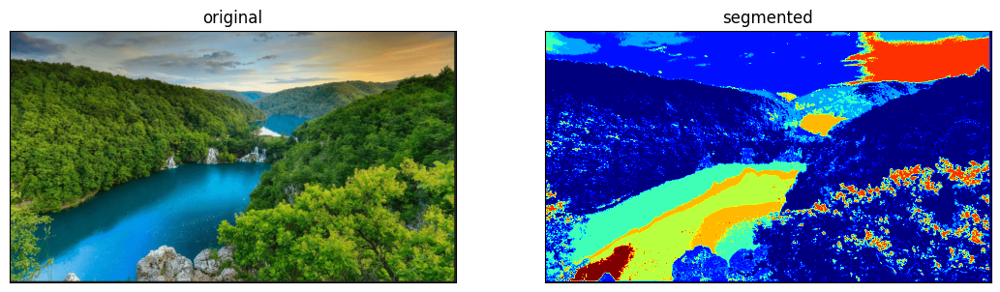

In [217]:
import cv2
import numpy as np
from sklearn.cluster import MeanShift, estimate_bandwidth
import matplotlib.pyplot as plt

image = cv2.imread(seg_images_path+"landscape.png")

image=cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
#Need to convert image into feature array based
#on rgb intensities
flat_image=np.reshape(image, [-1, 3])
 
#Estimate bandwidth
bandwidth2 = estimate_bandwidth(flat_image, quantile=0.12, n_samples=1000)
ms = MeanShift(bandwidth=bandwidth2, bin_seeding=True)
ms.fit(flat_image)
labels=ms.labels_
 
# Plot image vs segmented image

plt.figure(figsize=(0.03*image.shape[0],0.03*image.shape[1]))
plt.subplot(121)
plt.imshow(image)
plt.title('original')
plt.xticks([]),plt.yticks([])

plt.subplot(122)
plt.imshow(np.reshape(labels, [image.shape[0],image.shape[1]]),cmap='jet')
plt.title('segmented')
plt.xticks([]),plt.yticks([])

plt.show()

---
---

### EXERCISE 8:

Compare the performance of k-means and mean-shift on ‘azores.jpg’ image. Choose the most convenient parameters. You can apply morphological operations to segmentation results to eliminate small irrelevant regions. Seek the best morphological operations and segmentation parameters to get the cleanest segmentation of the sky.

---
---

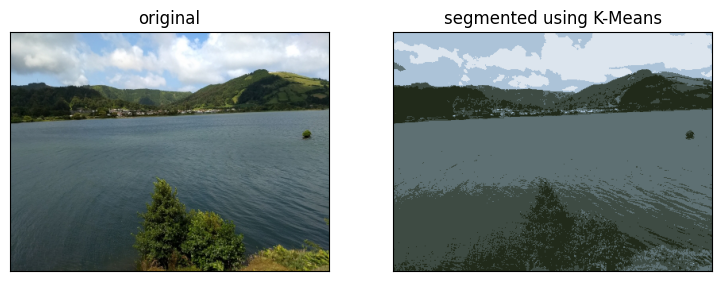

In [262]:
#SOLUTION HERE

import cv2
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import MeanShift, estimate_bandwidth

######################### K-Means ##############################

image = cv2.imread(seg_images_path+"azores.jpg")
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB) 

pixel_values = image.reshape((-1, 3))  
pixel_values = np.float32(pixel_values)

criteria = (cv2.TERM_CRITERIA_EPS+cv2.TERM_CRITERIA_MAX_ITER,
            500,0.1)
k = 3 
_, labels, (centers) = cv2.kmeans(pixel_values,5,None,criteria,
                                  10, cv2.KMEANS_PP_CENTERS)

centers = np.uint8(centers)
segmented_image = centers[labels.flatten()] 
segmented_image = segmented_image.reshape(image.shape)

plt.figure(figsize=(0.03*image.shape[0],0.03*image.shape[1]))
plt.subplot(121)
plt.imshow(image)
plt.title('original')
plt.xticks([]),plt.yticks([])

plt.subplot(122)
plt.imshow(segmented_image)
plt.title('segmented using K-Means')
plt.xticks([]),plt.yticks([])
plt.show()

# Explanation of the decisions made : 
# With respect to the different parameters that the K-Means implementation 
# has under OpenCV, I focused mainly on the maximal number of iterations, 
# goal accuracy, number of classes and centers initialisation technique.
# The first parameter I modified was the number of classes, as only 3
# classes are clearly not enough to detect more details in the sky. 
# Therefore, I went with 5 classes, I increased the maximal number of 
# iterations and minimized the goal accuracy. The script still maintained
# a reasonable execution time. The final parameter I modified was to choose
# to initialise the centers using the "cv2.KMEANS_PP_CENTERS" flag, as it 
# added marginal improvements.

# Discussion and results : 
# We have got more details on the sky, and the 5 classes are well convenient
# for our image !
 

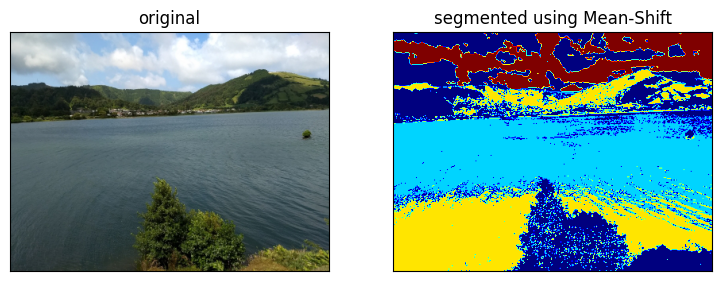

In [274]:
#SOLUTION HERE

import cv2
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import MeanShift, estimate_bandwidth

######################### Mean-Shift ##############################

image = cv2.imread(seg_images_path+"azores.jpg")

image=cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

flat_image=np.reshape(image, [-1, 3])
 
bandwidth2 = estimate_bandwidth(flat_image, quantile=0.15,
                                n_samples=1000)
ms = MeanShift(bandwidth=bandwidth2, bin_seeding=True, cluster_all=False)
ms.fit(flat_image)
labels=ms.labels_

plt.figure(figsize=(0.03*image.shape[0],0.03*image.shape[1]))

plt.subplot(121)
plt.imshow(image)
plt.title('original')
plt.xticks([]),plt.yticks([])

plt.subplot(122)
plt.imshow(np.reshape(labels, [image.shape[0],image.shape[1]]),cmap='jet')
plt.title('segmented using Mean-Shift')
plt.xticks([]),plt.yticks([])

plt.show()

# Explanation of the decisions made : 
# For the Mean-Shift algorithm, I primarely tested the parameters quantile, 
# bin_seeding and cluster_all. For the bin_seeding, changing its value to False 
# had a big negative influence on the performance of the algorithm, as it took 
# too much time to process the single image, which is logical given the 
# definition of the parameter. However, setting the cluster_all parameter to 
# False instantly led to the sky having more details, as the algorithm didn't
# consider those details on the sky as orphans, and gave them their own cluster
# labeled -1 as the definition of the parameter states. Finally, I tested some
# values for the quantile parameter, before settling down on 0.15 which appeared
# to give us the optimal results.

# Discussion and results : 
# Even though tweaking this algorithm led as well to more details on the sky, 
# I feel that the K-Means algorithm is less agressive on assigning pixels to the
# different labels, as we can clearly see that the Mean-Shift algorithm misclassed
# more pixels than the K-Means. But again, with more parameters tuning certainly
# comes better performance !

### Exercise Region Growing

Process Done!


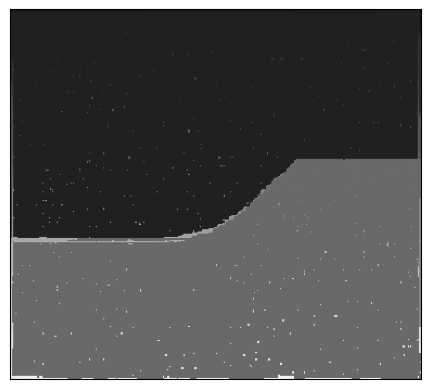

In [227]:
import numpy as np
import cv2
from matplotlib import pyplot as plt


class Point(object):
    def __init__(self, x, y):
        self.x = x
        self.y = y

    def getX(self):
        return self.x

    def getY(self):
        return self.y


# get the difference of gray value in image
def getGrayDiff(img, currentPoint, tmpPoint):
    return abs(int(img[currentPoint.x, currentPoint.y]) - int(img[tmpPoint.x, tmpPoint.y]))


# get four or eight neighbors
def selectConnects(neighbor_num):
    if neighbor_num == 8:  # eight neighbors
        connects = [Point(-1, -1), Point(0, -1), Point(1, -1), Point(1, 0), Point(1, 1),
                    Point(0, 1), Point(-1, 1), Point(-1, 0)]
    elif neighbor_num == 4:  # four neighbors
        connects = [Point(0, -1), Point(1, 0), Point(0, 1), Point(-1, 0)]
    else:
        raise ValueError("The neighbor_num should be 4 or 8")
    return connects


def regionGrow(img, mask, seed, thresh, neighbor_num=8, label=1):
    """ single seed region grow algorithm """
    height, weight = img.shape

    connects = selectConnects(neighbor_num)

    seedList = []
    seedList.append(seed)

    while (len(seedList) > 0):
        currentPoint = seedList.pop(0)

        mask[currentPoint.x, currentPoint.y] = label
        for i in range(neighbor_num):
            tmpX = currentPoint.x + connects[i].x
            tmpY = currentPoint.y + connects[i].y
            if tmpX < 0 or tmpY < 0 or tmpX >= height or tmpY >= weight or mask[tmpX, tmpY] >0:
                continue
            grayDiff = getGrayDiff(img, currentPoint, Point(tmpX, tmpY))
            if grayDiff < thresh and mask[tmpX, tmpY] <1:
                mask[tmpX, tmpY] = label
                seedList.append(Point(tmpX, tmpY))
    return mask


def find_undetermined(mask):
    zero_pos = np.where(mask<1)

    if len(zero_pos[0]) == 0:
        return None
    x = zero_pos[0][0]
    y = zero_pos[1][0]
    return Point(x, y)


def img_region_grow(img, label_in):
    """ gray image region grow algorithm, different region will have different labels """
    mask = np.zeros(img.shape)
    
    thresh = 7
    label = label_in
    

    
    while True:
        seed = find_undetermined(mask)
        if seed is not None:
            mask = regionGrow(img, mask, seed, thresh, neighbor_num=8, label=label)

            # cv2.imshow("mask", mask)
            #plt.imshow(mask,cmap = 'gray')
            #plt.show()
            label += 10

        else:
            print("Process Done!")
            break

    plt.imshow(mask, cmap='gray')
    plt.xticks([]),plt.yticks([])
    plt.show()

    
image = cv2.imread(seg_images_path+'noisy.png',0) 
img_region_grow(image, 50)

---
---
## Feature detectors and descriptors

- Scale invariant region selection
- Harris detector
- Blob detector
- Feature descriptors and matching
- Exercise:feature detection and matching,image alignment

https://docs.opencv.org/4.2.0/db/d27/tutorial_py_table_of_contents_feature2d.html

---
---

### Harris Detector
https://docs.opencv.org/4.2.0/dc/d0d/tutorial_py_features_harris.html

OpenCV has the following function for this purpose:

**dst=cv2.cornerHarris(src, blockSize, ksize)**

- src - Input image, it should be grayscale and float32 type.
- blockSize - It is the size of neighbourhood considered for corner detection
- ksize - Aperture parameter of Sobel derivative used.
- k - Harris detector free parameter. 

Exercise:**Play with parameters to see the effect on the detection.**

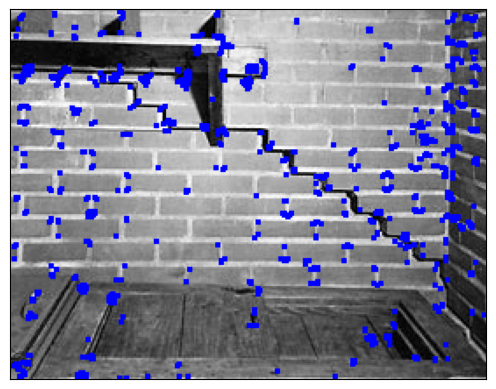

In [228]:
import cv2
import numpy as np

filename = feature_images_path+'bricks.jpg'
img = cv2.imread(filename)
gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
gray = np.float32(gray)

dst = cv2.cornerHarris(gray,3,3,0.2)
#result is dilated to easy visualization, not important
dst = cv2.dilate(dst,None)

# Threshold for an optimal value, it may vary depending on the image.
corners=img.copy()
corners[dst>0.001*dst.max()]=[0,0,255]


plt.imshow(corners)
plt.xticks([]),plt.yticks([])
plt.show()

Using **cv2.threshold()**  in combination with the  function **cv2.connectedComponentsWithStats()** you can retrieve the location of the most conspicuous Harris points.

cv2.connectedComponentsWithStats() returns the following information:

    The bounding box of the connected component
    The area (in pixels) of the component
    The centroid/center (x, y)-coordinates of the component

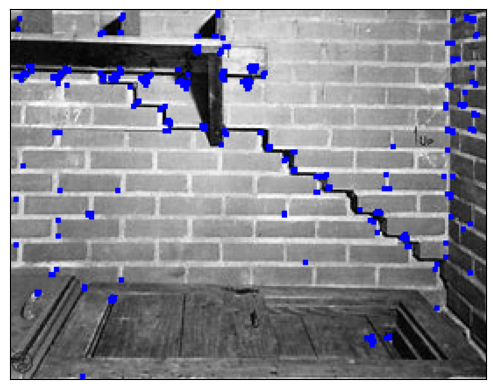

[[135 106]
 [118   2]
 [ 63   4]
 [262   5]
 [  5   5]
 [252   6]
 [  4  11]
 [ 51  13]
 [ 62  13]
 [265  14]
 [106  15]
 [116  15]
 [121  16]
 [250  19]
 [106  22]
 [121  22]
 [253  28]
 [  8  36]
 [138  33]
 [ 28  37]
 [ 60  37]
 [ 95  34]
 [263  33]
 [ 52  38]
 [121  37]
 [144  36]
 [ 77  39]
 [101  37]
 [ 98  42]
 [134  42]
 [264  41]
 [ 32  43]
 [ 68  44]
 [250  43]
 [259  47]
 [ 71  53]
 [248  55]
 [257  54]
 [ 86  55]
 [264  59]
 [ 90  64]
 [110  66]
 [250  69]
 [263  68]
 [ 26  70]
 [ 89  69]
 [122  70]
 [142  70]
 [120  77]
 [147  78]
 [218  78]
 [249  80]
 [161  81]
 [156  85]
 [  7  89]
 [161  91]
 [177  94]
 [214  94]
 [247  95]
 [252  95]
 [181 101]
 [214 102]
 [ 28 103]
 [ 61 103]
 [174 104]
 [250 105]
 [  3 108]
 [199 114]
 [ 45 116]
 [156 116]
 [209 115]
 [251 118]
 [ 27 120]
 [206 120]
 [262 122]
 [258 125]
 [209 127]
 [224 129]
 [ 27 129]
 [  3 134]
 [248 133]
 [226 135]
 [248 141]
 [168 144]
 [242 146]
 [ 24 149]
 [262 150]
 [ 63 154]
 [ 42 158]
 [ 15 161]
 [ 58 165]

In [229]:
ret, dst = cv2.threshold(dst,0.01*dst.max(),255,0)
dst = np.uint8(dst)
# find centroids
ret, labels, stats, centroids = cv2.connectedComponentsWithStats(dst)
points=centroids.astype(int)

corner=img.copy()
corner[dst>0.001*dst.max()]=[0,0,255]

plt.imshow(corner)
plt.xticks([]),plt.yticks([])
plt.show()

print (points)

### Blob Detector

OpenCV provides a convenient way to detect blobs and filter them based on different characteristics.
The class **SimpleBlobDetector** implements a simple algorithm for extracting blobs from an image:
- Converts source image to binary image by thresholding with several thresholds from *minThreshold* (inclusive) to *maxThreshold* (exclusive) with step *thresholdStep*.
- Extracts connected components by finding contours and their centers.
- Groups centers by their coordinates. Close centers form one group that corresponds to one blob, which is controlled by the *minDistBetweenBlobs* parameter.
- From the groups, estimates final centers of blobs and their radiuses and return as locations and sizes of keypoints.

This class performs several filtrations of returned blobs. You should set *filterBy* to true/false to turn on/off corresponding filtration. Available filtrations:
- By color - compares the intensity of the center of a blob to *blobColor*. If they differ, the blob is filtered out. Use blobColor = 0 to extract dark blobs and blobColor = 255 to extract light blobs.
- By area - returns blobs with areas between *minArea* (inclusive) and *maxArea* (exclusive).
- By circularity - filters blobs by their circularity (4∗π∗Area/(perimeter∗perimeter) between *minCircularity* (inclusive) and *maxCircularity* (exclusive).
- By ratio of the minimum inertia to maximum inertia - extracted blobs have this ratio between *minInertiaRatio* (inclusive) and *maxInertiaRatio* (exclusive).
- By convexity - returns blobs with convexity (area / area of blob convex hull) between *minConvexity* (inclusive) and *maxConvexity* (exclusive).

Default values of parameters are tuned to extract dark circular blobs.

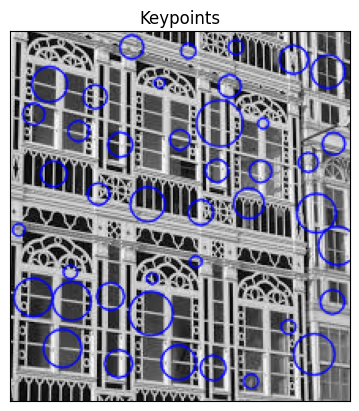

In [230]:
import cv2
import numpy as np;
from matplotlib import pyplot as plt
 
im = cv2.imread(feature_images_path+"corunha.jpg", cv2.IMREAD_GRAYSCALE)
 
# Set up the detector with default parameters.
detector = cv2.SimpleBlobDetector_create()

# Set up the detector with specific parameters.
params = cv2.SimpleBlobDetector_Params()
params.filterByColor=True #Filter by Color
params.blobColor=255
params.filterByArea = True # Filter by Area.
params.minArea = 20
params.maxArea = 4000
params.filterByCircularity = False # Filter by Circularity
#params.minCircularity = 0.5
params.filterByConvexity = False # Filter by Convexity
#params.minConvexity = 0.87
params.filterByInertia = False # Filter by Inertia
#params.minInertiaRatio = 0.8
params.minDistBetweenBlobs = 20 # Distance Between Blobs

# Set up the detector with specific parameters.
detector = cv2.SimpleBlobDetector_create(params)
keypoints = detector.detect(im) # Detect blobs.

# Draw detected blobs as red circles.
# cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS ensures the size of the circle corresponds to the size of blob
im_with_keypoints = cv2.drawKeypoints(im, keypoints, np.array([]), (0,0,255), cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
 
plt.imshow(im_with_keypoints), plt.title("Keypoints")
plt.xticks([]),plt.yticks([])
plt.show()

---
---
### EXERCISE 9: Blob Detection

Use the blob detector to detect the ball in black-trap-rock.jpg image. Choose the most convenient parameters.

---
---

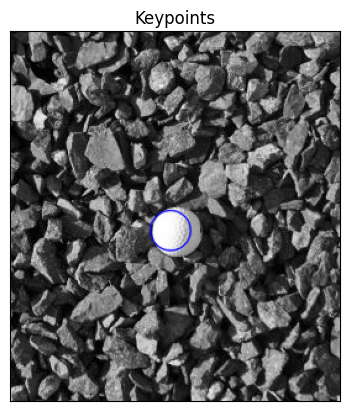

In [235]:
#SOLUTION HERE

import cv2
import numpy as np;
from matplotlib import pyplot as plt
 
im = cv2.imread(seg_images_path+"black-trap-rock.jpg", cv2.IMREAD_GRAYSCALE)
 
detector = cv2.SimpleBlobDetector_create()


params = cv2.SimpleBlobDetector_Params()
params.filterByColor=True 
params.blobColor=255
params.filterByArea = True 
params.minArea = 500
params.maxArea = 1000
params.filterByCircularity = False
#params.minCircularity = 0.9
params.filterByConvexity = True
params.minConvexity = 0.85
params.filterByInertia = False
#params.minInertiaRatio = 0.8
params.minDistBetweenBlobs = 20 

detector = cv2.SimpleBlobDetector_create(params)
keypoints = detector.detect(im)


im_with_keypoints = cv2.drawKeypoints(im, keypoints, np.array([]), (0,0,255),
                                      cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
 
plt.imshow(im_with_keypoints), plt.title("Keypoints")
plt.xticks([]),plt.yticks([])
plt.show()

# Explanation of the decisions made : 
# At the start, I used the same parameters as in the first example of the Blob 
# Detection. However, I had too much cercles detected. So I had to, in 
# the parameters, increase the minimum area and decrease the maximum area to 
# eliminate small circles extreme circles. I noticed aswell that the detection
# improved by turning on the convexity parameter, and setting its paramter to
# around 0.85.

# Discussion and results : 
# As a result of the parameter tuning done, the script was able to detect the while
# golf ball successfully, without being influenced by the other white parts 
# in the image.

### ORB Image Feature Extraction

https://docs.opencv.org/4.2.0/d1/d89/tutorial_py_orb.html
https://docs.opencv.org/4.x/db/d95/classcv_1_1ORB.html

This algorithm was brought up as an efficient alternative to SIFT or SURF in computation cost and matching performance.
We have to create an ORB object with the function, **cv2.ORB_create()**, which has a number of optional parameters. Most useful ones are:

**retval=cv2.ORB_create([, nFeatures[, scaleFactor[, nlevels[, edgeThreshold[, firstLevel[, WTA_K[, scoreType[, patchSize[, fastThreshold]]]]]]]]])**

- nFeatures - denotes maximum number of features to be retained (by default 500).
- scaleFactor, nlevels - multiscale parameters, 1.2 and 8 by default.
- patchSize - size of the patch used by the oriented BRIEF descriptor, 31 by default
- edgeThreshold - size of the border where the features are not detected. It should roughly match the *patchSize* parameter, 31 by default.

Below is a simple code which shows the use of ORB.

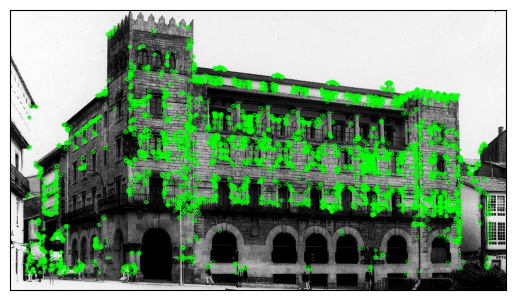

In [236]:
import numpy as np
import cv2
from matplotlib import pyplot as plt

img = cv2.imread(seg_images_path+'hotel.jpg',0)
# Initiate detector
orb = cv2.ORB_create(nfeatures=5000)
# find the keypoints with ORB
kp = orb.detect(img,None)
# compute the descriptors with ORB
kp, des = orb.compute(img, kp)

# draw only keypoints location, not size and orientation
img2 = cv2.drawKeypoints(img, kp, None,color=(0,255,0), flags=0)
plt.imshow(img2)
plt.xticks([]),plt.yticks([])
plt.show()

### Feature Matching:

Brute-Force matcher takes the descriptor of one feature in first set and compares it with all other features in second set using some distance calculation. Thw closest match is returned.

First we have to create the BFMatcher object using **cv2.BFMatcher()**. It takes two optional parameters:

**retval=cv.BFMatcher_create([, normType[, crossCheck]])**

- normType - distance measurement to be used. By default, it is cv2.NORM_L2, but for binary string based descriptors like ORB, cv2.NORM_HAMMING should be used. If ORB is using VTA_K == 3 or 4, cv2.NORM_HAMMING2 should be used.

- crossCheck - boolean, false by default. If true, the matcher returns only those matches with value (i,j) such that i-th descriptor in set A has j-th descriptor in set B as the best match and vice-versa. 

Two important methods od tghis class are **BFMatcher.match()** and **BFMatcher.knnMatch()**. First one returns the best match. Second method returns k best matches where k is specified by the user.

Like cv2.drawKeypoints() draws keypoints, **cv2.drawMatches()** draws the matches. It stacks two images horizontally and draw lines from first image to second image showing best matches. 

**cv2.drawMatchesKnn()** draws all the k best matches. If k=2, it will draw two match-lines for each keypoint. So we have to pass a mask if we want to selectively draw it.

Here, we will see a simple example on how to match features between two images. In this case, we have a query image and a test image. We will try to find the former in the latter using feature matching.


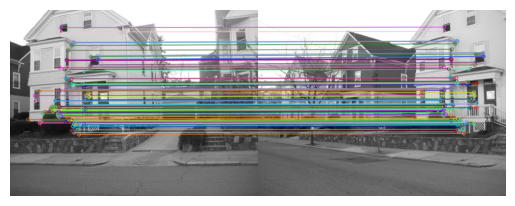

In [237]:
import numpy as np 
import cv2 
from matplotlib import pyplot as plt 


img1 = cv2.imread(feature_images_path+'houses1.jpg',0) # query image 
img2 = cv2.imread(feature_images_path+'houses2.jpg',0) # test image 

# Initiate detector 
orb = cv2.ORB_create(nfeatures=5000) 

# find the keypoints and descriptors 
kp1, des1 = orb.detectAndCompute(img1,None) 
kp2, des2 = orb.detectAndCompute(img2,None) 

# create BFMatcher object 
bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True) 
# Match descriptors. 
matches = bf.match(des1,des2) 
# Sort them in ascending order of their distance. 
matches = sorted(matches, key = lambda x:x.distance) 

# Draw first 100 matches. 
img3 = cv2.drawMatches(img1,kp1,img2,kp2,matches[:100], None,flags=2) 

plt.imshow(img3)
plt.axis('off')
plt.show() 

## Exercise Image Alignment

Image alignment (or registration) is the technique of warping one image (or sometimes both images) so that the features in the two images line up perfectly.

In some medical applications, multiple scans of a tissue may be taken at slightly different times and images are registered to see the evolution in time. But, the most interesting application of image alignment is perhaps creating panoramas. 

In general, 3D alignment requires depth information. However, when the two images are taken by rotating the camera about its optical axis (as in the case of panoramas), we can use the code below to align two views of the scene.

The function **cv2.warpPerspective()** applies a perspective transformation to an image:

**dst=cv2.warpPerspective(src, h, dsize)**

- src - input image.
- dst - output image that has the size dsize and the same type as src .
- h - homography (3×3 transformation matrix).
- Dsize - size of the output image.

Here we present an example for two views of a scene, and we look for the perspective transformation:

Reading reference image :  ./Images/Feature_images/houses2.jpg
Reading image to align :  ./Images/Feature_images/houses1.jpg


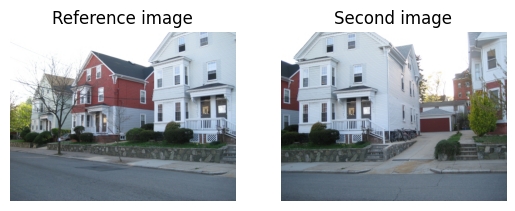

Aligning images ...


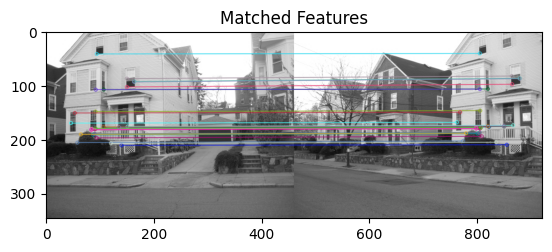

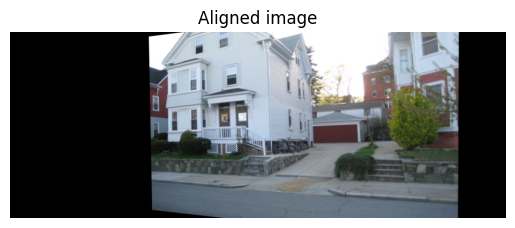

Estimated homography : 
 [[ 7.02434358e-01  2.83631214e-02  2.57990106e+02]
 [-1.19294145e-01  9.40458461e-01  1.01918471e+01]
 [-6.57807313e-04  3.92848527e-05  1.00000000e+00]]


In [238]:
import cv2 
import numpy as np 
from matplotlib import pyplot as plt 

MAX_FEATURES = 500 
GOOD_MATCH_PERCENT = 0.15

def alignImages(im1, im2): 

  # Convert images to grayscale 
  im1Gray = cv2.cvtColor(im1, cv2.COLOR_RGB2GRAY) 
  im2Gray = cv2.cvtColor(im2, cv2.COLOR_RGB2GRAY) 

  # Detect ORB features and compute descriptors. 
  orb = cv2.ORB_create(nfeatures=MAX_FEATURES) 
  kpts1, descriptors1 = orb.detectAndCompute(im1Gray,None) 
  kpts2, descriptors2 = orb.detectAndCompute(im2Gray,None) 

  # create BFMatcher object 
  matcher = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True) 

  # Match features.    
  matches = matcher.match(descriptors1, descriptors2) 

  # Sort matches by score 
  matches = sorted(matches, key = lambda x:x.distance) 

  # Remove not so good matches 
  numGoodMatches = int(len(matches) * GOOD_MATCH_PERCENT) 
  matches = matches[:numGoodMatches] 

  # Draw top matches 
  imMatches=cv2.drawMatches(im1Gray,kpts1,im2Gray,kpts2, matches, None,flags=2) 

  plt.imshow(imMatches), plt.title('Matched Features'), plt.show() 

 # cv2.imshow('Matched Features', imMatches) 
 # cv2.waitKey(0) 
 # cv2.destroyWindow('Matched Features') 
 # 
 # cv2.imwrite("matches.jpg", imMatches) 

  # Extract location of good matches 
  points1 = np.zeros((len(matches), 2), dtype=np.float32) 
  points2 = np.zeros((len(matches), 2), dtype=np.float32) 


  for i, match in enumerate(matches): 
    points1[i, :] = kpts1[match.queryIdx].pt 
    points2[i, :] = kpts2[match.trainIdx].pt 

    
  # Find homography 
  h, mask = cv2.findHomography(points1, points2, cv2.RANSAC) 

  # Use homography to align im1 with im2 
  height1, width1, _ = im1.shape 
  height2, width2, _ = im2.shape 

 #Aligned image im1Reg, using a 3x3 transformation matrix 
  im1Reg = cv2.warpPerspective(im1, h, (width1 + width2, height1)) 
    
  return im1Reg, h 


if __name__ == '__main__': 

  # Read reference image 
  refFilename = feature_images_path+'houses2.jpg' 
  print("Reading reference image : ", refFilename) 
  imReference = cv2.imread(refFilename, cv2.IMREAD_COLOR)
  imReference=cv2.cvtColor(imReference, cv2.COLOR_BGR2RGB)
    
 # Read image to be aligned 
  imFilename = feature_images_path+'houses1.jpg'
  print("Reading image to align : ", imFilename);   
  im = cv2.imread(imFilename, cv2.IMREAD_COLOR) 
  im=cv2.cvtColor(im, cv2.COLOR_BGR2RGB)
  
  plt.subplot(1,2,1)
  plt.imshow(imReference), plt.title("Reference image")
  plt.axis('off')

  plt.subplot(1,2,2)
  plt.imshow(im), plt.title("Second image")
  plt.axis('off')
  plt.show()
    

  print("Aligning images ...") 

  # Registered image will be stored in imReg. 
  # The estimated homography will be stored in h. 
  imReg, h = alignImages(im,imReference) 
  
  # Write aligned image to disk. 
  #outFilename = "aligned.jpg" 
  #print("Saving aligned image : ", outFilename); 
  #cv2.imwrite(outFilename, imReg) 
  plt.imshow(imReg), plt.title("Aligned image")
  plt.axis('off')
  plt.show()

  # Print estimated homography 

  print("Estimated homography : \n",  h) 

---
---
### EXERCISE 10: Panorma

Now, find the affine transformation between view4.jpg and view5.jg, and transform the second one and then stitch the two togetther to create a panorama: It can be done just by modifying the last part of the function
**alignImages()**.

      height1, width1, _ = im1.shape
      height2, width2, _ = im2.shape
      im1Reg = cv2.warpPerspective(im1, h, (width1 + width2, height1))
      im1Reg[0:height2, 0:width1] = im2 
    
Choose the most convenient parameters.

---
---

Reading reference image :  ./Images/Feature_images/view4.jpg
Reading image to align :  ./Images/Feature_images/view5.jpg


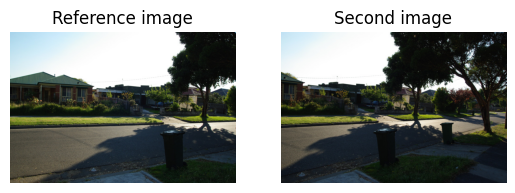

Aligning images ...


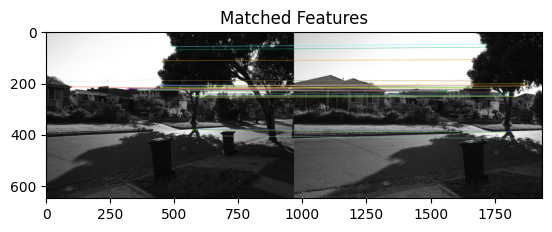

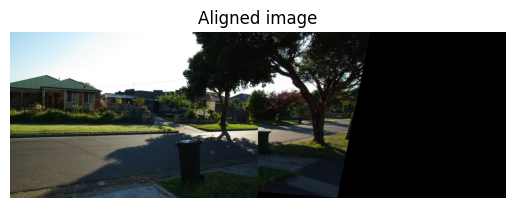

Estimated homography : 
 [[ 7.54903457e-01  2.76855782e-01  2.38124397e+02]
 [-1.15573590e-01  1.02219726e+00  3.26526278e+01]
 [-3.33869286e-04  3.43080830e-04  1.00000000e+00]]


In [246]:

#SOLUTION HERE

import cv2 
import numpy as np 
from matplotlib import pyplot as plt 

MAX_FEATURES = 500 
GOOD_MATCH_PERCENT = 0.15

def alignImages(im1, im2): 

  im1Gray = cv2.cvtColor(im1, cv2.COLOR_RGB2GRAY) 
  im2Gray = cv2.cvtColor(im2, cv2.COLOR_RGB2GRAY) 

  orb = cv2.ORB_create(nfeatures=MAX_FEATURES)

  kpts1, descriptors1 = orb.detectAndCompute(im1Gray,None) 
  kpts2, descriptors2 = orb.detectAndCompute(im2Gray,None) 

  matcher = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True) 
  matches = matcher.match(descriptors1, descriptors2) 
  matches = sorted(matches, key = lambda x:x.distance) 
  numGoodMatches = int(len(matches) * GOOD_MATCH_PERCENT) 
  matches = matches[:numGoodMatches] 

  imMatches=cv2.drawMatches(im1Gray,kpts1,im2Gray,kpts2, matches, None,flags=2) 
  plt.imshow(imMatches), plt.title('Matched Features'), plt.show() 

  points1 = np.zeros((len(matches), 2), dtype=np.float32) 
  points2 = np.zeros((len(matches), 2), dtype=np.float32) 

  for i, match in enumerate(matches): 
    points1[i, :] = kpts1[match.queryIdx].pt 
    points2[i, :] = kpts2[match.trainIdx].pt 

  h, mask = cv2.findHomography(points1, points2, cv2.RANSAC) 

  height1, width1, _ = im1.shape
  height2, width2, _ = im2.shape
  im1Reg = cv2.warpPerspective(im1, h, (width1 + width2, height1))
  im1Reg[0:height2, 0:width1] = im2 
    
  return im1Reg, h 


if __name__ == '__main__': 

  refFilename = feature_images_path+'view4.jpg' 
  print("Reading reference image : ", refFilename) 
  imReference = cv2.imread(refFilename, cv2.IMREAD_COLOR)
  imReference=cv2.cvtColor(imReference, cv2.COLOR_BGR2RGB)
    
  imFilename = feature_images_path+'view5.jpg'
  print("Reading image to align : ", imFilename);   
  im = cv2.imread(imFilename, cv2.IMREAD_COLOR) 
  im=cv2.cvtColor(im, cv2.COLOR_BGR2RGB)
  
  plt.subplot(1,2,1)
  plt.imshow(imReference), plt.title("Reference image")
  plt.axis('off')

  plt.subplot(1,2,2)
  plt.imshow(im), plt.title("Second image")
  plt.axis('off')

  plt.show()
    
  print("Aligning images ...") 
 
  imReg, h = alignImages(im,imReference) 
  
  plt.imshow(imReg), plt.title("Aligned image")
  plt.axis('off')
    
  plt.show()

  print("Estimated homography : \n",  h) 
    
# Explanation of the decisions made : 
# Compared to the exercise 1, I have to say that at first, I thought the
# code would be complicated to understand. But I found out that its
# similar to the first exercise, its just that instead of manually 
# choosing identical points between both views, we use the orbs instead 
# as well as a brute force matcher between both images, which gives a 
# more automated and more convenient script, with a more precise result 
# as well.

# Discussion and results : 
# Well, as we can see in the final image, I was actually able to create
# a panorama from just two images ! Taking into account how very 
# convenient and intuitive that was, I have to say that this is an 
# impressive performance from OpenCV !

# Comment on the whole course : 
# Personally, I learn alot about the different algorithms and techniques 
# used in the image analysis field, and I can say that I am more familiar
# with OpenCV (Although definitely not an expert yet, but that will come 
# with time and hardwork :D ). 
# Thank you !